In [1]:
import os
import inspect
import seaborn
import matplotlib
import matplotlib.pyplot as plt
import torch
import scanpy as sc
import tqdm
import sys
import pickle
import PyComplexHeatmap as pch
import scvi
import IPython
import pandas as pd
import scipy
from scipy.stats import mannwhitneyu

sc.settings.figdir=os.path.expanduser('~/WbFigures/DevDE')
sc._settings.settings._vector_friendly=True

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if torch.cuda.is_available():
    print("GPU is available")
    print("Number of GPUs:", torch.cuda.device_count())
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available")

sys.path.append('/home/matthew.schmitz/utils/mts-utils/')
from genomics import sc_analysis


import antipode
from antipode.antipode_model import *
import antipode.model_functions
from antipode.model_functions import *
import antipode.model_distributions
from antipode.model_distributions import *
import antipode.model_modules
from antipode.model_modules import *
import antipode.train_utils
from antipode.train_utils import *
import antipode.plotting
from antipode.plotting import *

gs1=matplotlib.colors.ListedColormap(sc.pl.palettes.godsnot_102,name='godsnot_102')
try:
    matplotlib.colormaps.register(name='godsnot_102',cmap=gs1)
except:
    pass


plt.rc("axes.spines", top=False, right=False)


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPU is not available


In [2]:
batch_key='batch_name'
discov_key='species'
layer_key='spliced'
leaf_key='Initial_Class_markers_level_2'
MDE_KEY = "X_antipode_UMAP"
anndata.settings.allow_write_nullable_strings = True

model_tag   = '1.9.1.8.5_Dev_final_600clusters'
model_path='/home/matthew.schmitz/Matthew/models/'+model_tag
adata = sc.read_h5ad(os.path.join(model_path,'analysis_inprogress.h5ad'))
antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p3_',device=device)
antipode_model.save_params_to_uns()
adata=antipode_model.adata_manager.adata
pstore = adata.uns['param_store']
adata.var = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/var.csv',index_col=0)

INFO     Generating sequential column names                                                                        


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [3]:
# leaf_key='Initial_Class_markers_level_2'
# adata.obs['Initial_Class_markers_level_2'] = adata.obs['Initial_Class_markers'].astype(str) + '_' + adata.obs['level_2'].astype(str)
# adata.obs[leaf_key] = adata.obs[leaf_key].astype('category')
# sc.tl.dendrogram(adata,groupby=leaf_key,use_rep='X_antipode',linkage_method='average',cor_method='kendall')
# adata.obs[leaf_key] = adata.obs[leaf_key].cat.reorder_categories(adata.uns['dendrogram_'+leaf_key]['categories_ordered'])
# sc.tl.dendrogram(adata,groupby='level_2',use_rep='X_antipode',linkage_method='average',cor_method='kendall')
# adata.obs['level_2'] = adata.obs['level_2'].cat.reorder_categories(adata.uns['dendrogram_'+'level_2']['categories_ordered'])

# fig, axs = plt.subplots(
#     nrows=1,
#     ncols=1,
#     figsize=(30,4),
# )
# sc.pl.dendrogram(adata,groupby=leaf_key,ax=axs)

leaf_l2_dict = dict(zip(adata.obs[leaf_key].cat.categories,adata.obs['level_2'].cat.categories))
l2_leaf_dict = dict(zip(adata.obs['level_2'].cat.categories,adata.obs[leaf_key].cat.categories))

In [4]:
pstore = adata.uns['param_store']
discov_cluster_params,cluster_params, cluster_labels,var_labels, zero_mask,(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)=antipode_model.calculate_cluster_params(flavor='numpy')
keep_clusters = np.array([x in adata.obs['level_2'].unique() for x in cluster_labels ])
cluster_labels = np.array(cluster_labels)[keep_clusters]
zero_mask = zero_mask[:,keep_clusters,:]
cluster_index = np.array([int(x) for x in cluster_labels])
zero_mask = np.nan_to_num(zero_mask,posinf=np.nan)
discov_cluster_params = discov_cluster_params[:,cluster_index,:] * zero_mask
prop_locs = prop_locs[cluster_index,:]
prop_discov_di = prop_discov_di[:,cluster_index,:] * zero_mask
prop_discov_dm = prop_discov_dm[:,cluster_index,:] * zero_mask
discov_labels=adata.obs[antipode_model.discov_key].cat.categories
latent_labels=[str(x) for x in range(pstore['discov_dc'].shape[1])]
n_clusters=antipode_model.level_sizes[-1]
leaf_labels = [l2_leaf_dict[x] for x in cluster_labels]

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:450: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  zero_mask = (adata.obs.groupby(self.discov_key)[leaf_level].value_counts().unstack().loc[:,cluster_labels]>=cluster_count_threshold).to_numpy()
/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:451: RuntimeWarning: divide by zero encountered in divide
  return discov_cluster_params,cluster_params, cluster_labels,var_labels, 1/zero_mask[...,np.newaxis],(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)


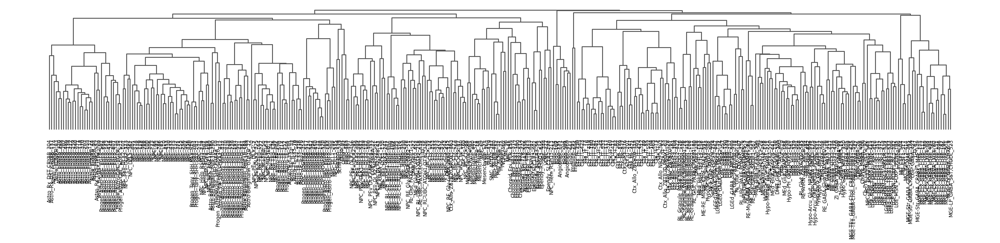

<Axes: >

In [5]:
fig, axs = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(30,4),
)
sc.pl.dendrogram(adata,groupby=leaf_key,ax=axs)


In [6]:
import os
import numpy as np
import pandas as pd
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
from pydeseq2.default_inference import DefaultInference

if not os.path.exists(os.path.join(model_path,'deseq2_level2_overall_lfcs_simpleformula.npy')):

    
    # Assume adata is your AnnData object and layer_key is defined for your count layer.
    # Also assume model_path is defined (e.g., a directory to save results).
    
    # Get unique levels from the obs dataframe.
    species_levels = np.sort(adata.obs['species'].unique())
    level2_levels = np.sort(adata.obs[leaf_key].unique())
    
    n_species = len(species_levels)
    n_level2 = len(level2_levels)
    n_genes = adata.shape[1]
    
    # Pre-allocate array for pairwise comparisons:
    # Dimensions: [species, species, level_2, genes]
    pair_lfc = np.zeros((n_species, n_species, n_level2, n_genes))
    pair_padj = np.ones((n_species, n_species, n_level2, n_genes))
    
    # Pre-allocate array for overall species effects (LFC relative to the overall mean)
    # Dimensions: [species, level_2, genes]
    overall_lfc = np.zeros((n_species, n_level2, n_genes))
    
    # Create a DefaultInference object (adjust n_cpus as needed)
    inference = DefaultInference(n_cpus=4)
    
    # Loop over each level_2 group.
    for k, lvl2 in enumerate(level2_levels):
        print("Processing level_2:", lvl2)
        # Subset the anndata object by the current level_2.
        adata_sub = adata[adata.obs[leaf_key] == lvl2].copy()
        
        # Build counts and metadata DataFrames.
        counts_df = pd.DataFrame(
            adata_sub.layers[layer_key].todense().astype(int)
            if hasattr(adata_sub.layers[layer_key], "todense")
            else adata_sub.layers[layer_key].astype(int),
            index=adata_sub.obs_names,
            columns=adata_sub.var_names
        )
        metadata = adata_sub.obs.copy()
        
        # Set categorical variables (ensuring species order is as in species_levels).
        metadata['species'] = pd.Categorical(metadata['species'], categories=species_levels, ordered=True)
        metadata['batch_name'] = metadata['batch_name'].astype(str)
        
        # ----- Pseudobulking Step -----
        # Count cells per batch and keep only batches with >=10 cells.
        batch_counts = metadata.groupby("batch_name").size()
        valid_batches = batch_counts[batch_counts >= 10].index
        if len(valid_batches) == 0:
            print(f"No valid batches with >=10 cells for level_2 {lvl2}. Skipping...")
            continue
        
        # Filter metadata to include only valid batches.
        metadata_pb = metadata[metadata["batch_name"].isin(valid_batches)].copy()
        # Aggregate counts by summing cells within each batch.
        counts_df_pb = counts_df.loc[metadata_pb.index].groupby(metadata_pb["batch_name"]).sum()
        # For metadata, take the first cell's annotations per batch (assuming batch homogeneity).
        metadata_pb = metadata_pb.groupby("batch_name").first()
        # --------------------------------
        
        # Define a design formula using
        # This avoids designating any species as the reference.
        design_formula = "~species"#"~ C(species, Sum)"  sum-to-zero contrasts for species.
        dds = DeseqDataSet(
            counts=counts_df_pb,
            metadata=metadata_pb,
            design=design_formula,
            refit_cooks=True,
            inference=inference,
        )
        try:
            dds.deseq2()
        except:
            print(f"Singular matrix encountered for level_2 group '{lvl2}', skipping")
            continue
        
        # Run pairwise DE tests for every pair of species.
        for i in range(n_species):
            for j in range(i + 1, n_species):
                contrast = ["species", species_levels[i], species_levels[j]]
                ds = DeseqStats(dds, contrast=contrast, inference=inference)
                ds.summary()  # This runs the Wald test; results are stored in ds.results_df.
                
                # Align the results using gene names (assumed to be the index of ds.results_df).
                results = ds.results_df.loc[counts_df_pb.columns]
                # Store the contrast: difference = effect(species[i]) - effect(species[j]).
                pair_lfc[i, j, k, :] = results["log2FoldChange"].values
                pair_lfc[j, i, k, :] = -results["log2FoldChange"].values
                # Store the adjusted p-values for this pair.
                pair_padj[i, j, k, :] = results["padj"].values
                pair_padj[j, i, k, :] = results["padj"].values  # (They are symmetric in magnitude.)
        
        # Compute the overall species effect relative to the overall mean.
        # For each species i, estimate beta_i = (1/n_species) * sum_{j ≠ i} d_{ij},
        # where d_{ij} is the log fold change from species i versus species j.
        for i in range(n_species):
            diff_sum = np.zeros(n_genes)
            for j in range(n_species):
                if i == j:
                    continue
                else:
                    # If i < j, we already stored d_{ij} = beta_i - beta_j.
                    # If i > j, then d_{ji} was computed; use -d_{ji} to get beta_i - beta_j.
                    if i < j:
                        diff_sum += pair_lfc[i, j, k, :]
                    else:
                        diff_sum += -pair_lfc[j, i, k, :]
            overall_lfc[i, k, :] = diff_sum / (n_species - 1)
    
    # Save the resulting overall species LFC array.
    print("Overall LFC shape:", overall_lfc.shape)
    np.save(os.path.join(model_path, 'deseq2_level2_overall_lfcs_simpleformula.npy'), overall_lfc)
    
    # Optionally, you could also save the full pairwise arrays.
    np.save(os.path.join(model_path, 'deseq2_level2_pairwise_lfcs_simpleformula.npy'), pair_lfc)
    np.save(os.path.join(model_path, 'deseq2_level2_pairwise_pvals_simpleformula.npy'), pair_padj)


In [7]:
adata

AnnData object with n_obs × n_vars = 1854767 × 16738
    obs: 'Class', 'G2M_score', 'S_score', 'Subclass', 'batch_name', 'female', 'general_region', 'log10_n_counts', 'new_ccl', 'new_neighborhood_extended', 'phase', 'region', 'species', 'timepoint', 'general_region_species', '_scvi_discov_ind', '_scvi_batch_ind', 'psi_0', 'psi_1', 'psi_2', 'q_score', 'level_0', 'level_1', 'level_2', 'antipode_cluster', 'kmeans', 'clean_cellname', 'dataset_name', 'doublet', 'full_cellname', 'individual', 'msregion', 'n_counts', 'n_genes', 'percent_ribo', 'singlet', 'species_dataset_name', 'anno_level_2', 'initial_class', 'ic_extended', 'abc_subclass_markercor', 'juv_subclass_markercor', 'linnarson_extended', 'lamanno_class', 'lamanno_subclass', 'lamanno_cluster', 'neighborhood', 'curated_class_label', 'new_neighborhood', 'ccl_extended', 'Neighborhood', 'Division', 'Initial_Class', 'Initial_Class_markers', 'Initial_Class_markers_level_2', 'clipped_psi_2', 'log_abs_sum_dynam', 'log10_n_genes'
    var: 'hi

In [8]:
lfc_array = np.load(os.path.join(model_path,'deseq2_level2_pairwise_lfcs_simpleformula.npy'))
padj_array = np.load(os.path.join(model_path,'deseq2_level2_pairwise_pvals_simpleformula.npy'))
overall_lfc = np.load(os.path.join(model_path,'deseq2_level2_overall_lfcs_simpleformula.npy'))

In [9]:
log_real_means,real_mean_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,leaf_key,layer=layer_key)
real_means=pd.DataFrame(log_real_means.mean(0),columns=adata.var.index,index=real_mean_levels[leaf_key])
real_means=real_means.loc[real_mean_levels[leaf_key],:]

100%|██████████| 1140/1140 [03:53<00:00,  4.88it/s]


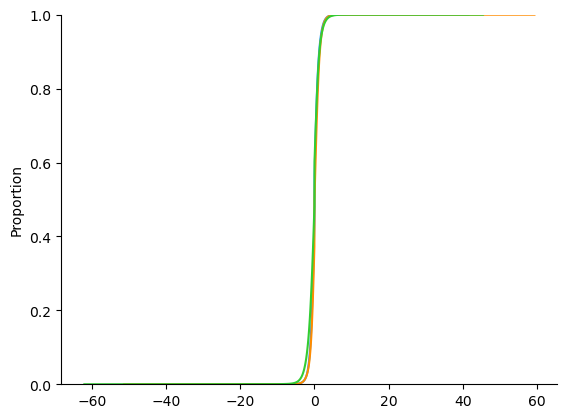

In [10]:
categories = adata.obs[discov_key].cat.categories
colors = adata.uns[discov_key + '_colors']
param_store = antipode_model.adata_manager.adata.uns['param_store']

plt.figure()
for i in range(len(categories)):
    seaborn.ecdfplot(x=overall_lfc[i, ...].flatten(), color=colors[i],
                      label=categories[i])


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


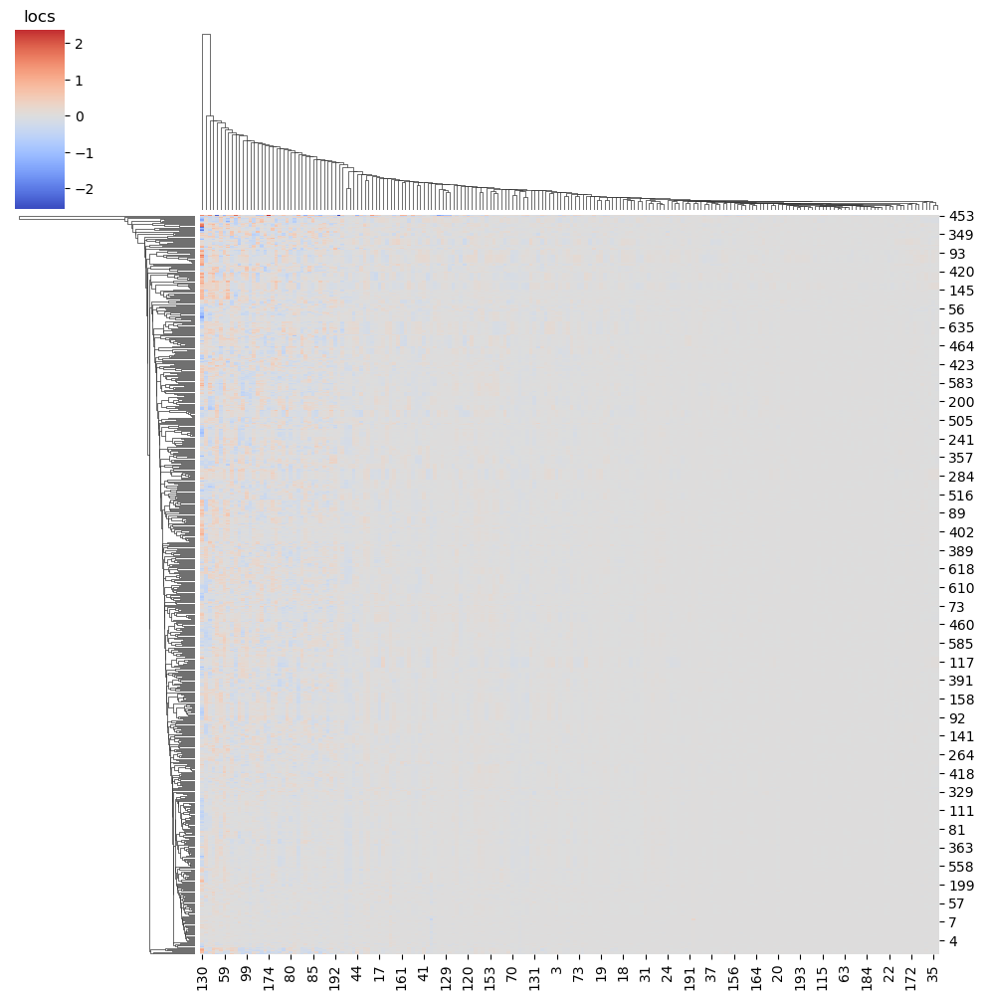

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


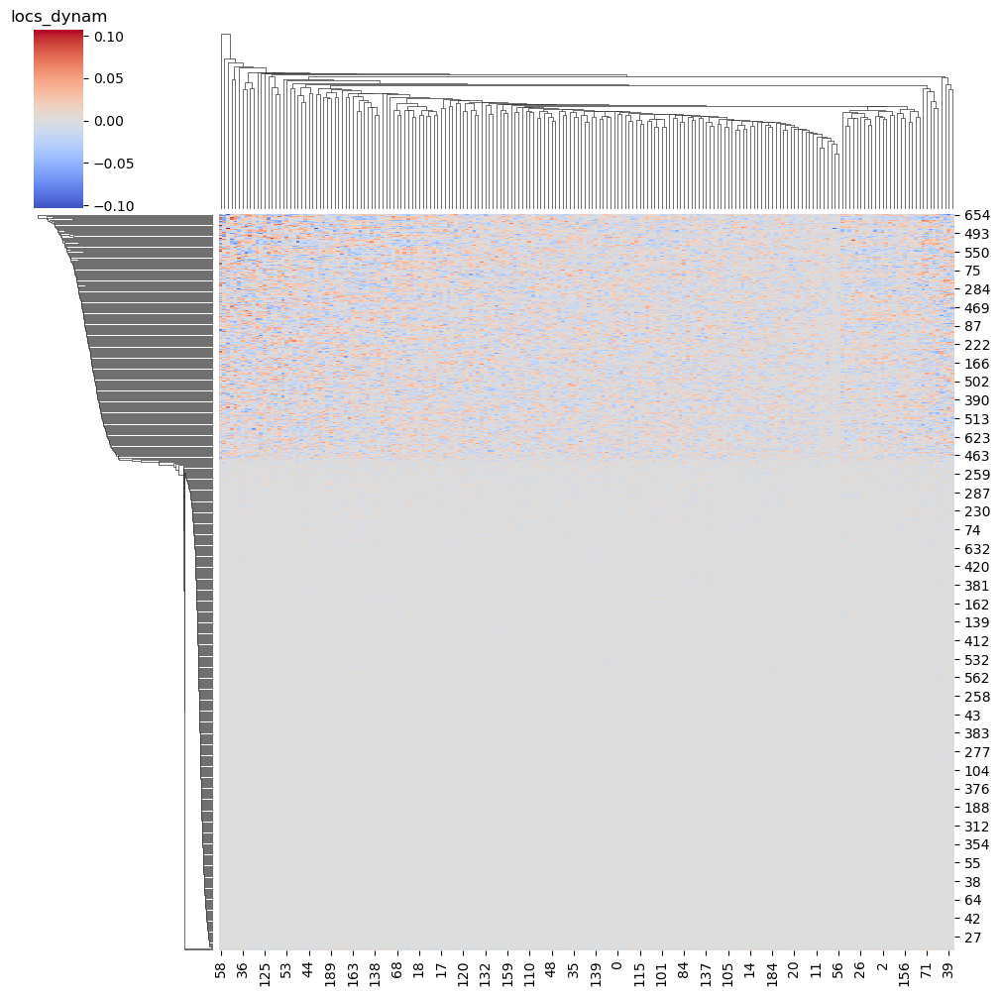

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


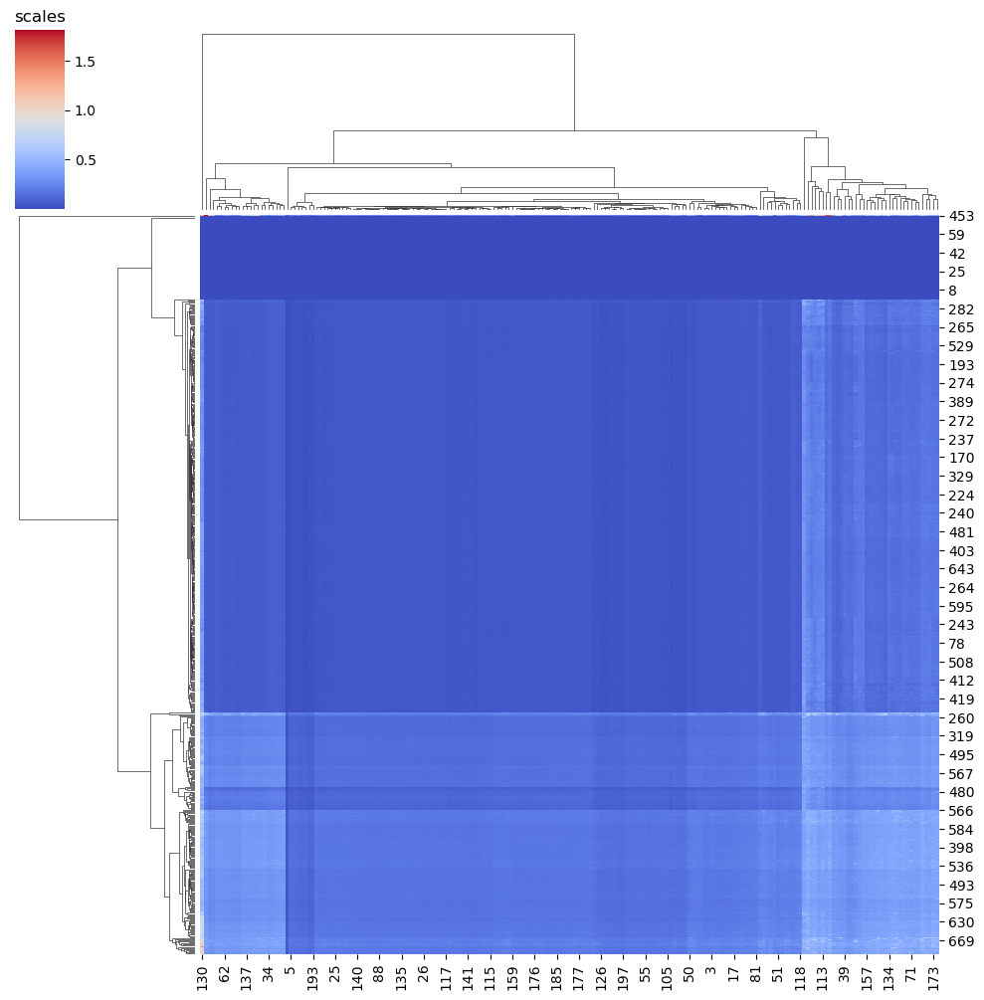

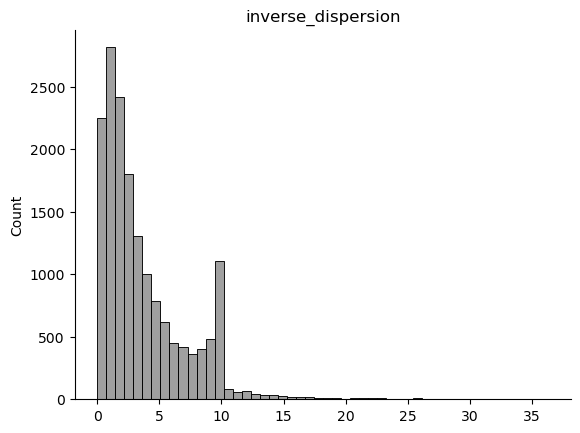

In [11]:
antipode.plotting.plot_gmm_heatmaps(antipode_model,save=True)

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:114: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  seaborn.scatterplot(data=df, x=0, y=1, hue=color_key,palette = colors)


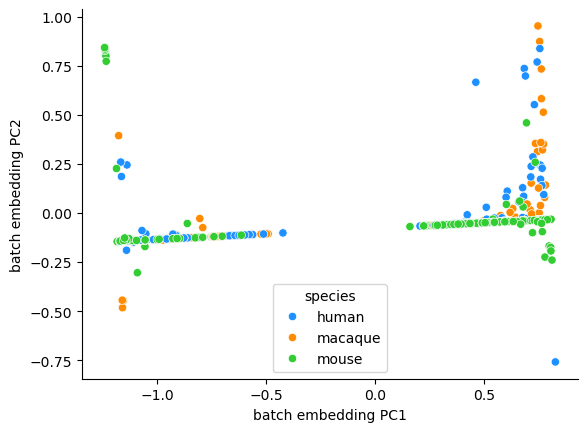

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:114: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  seaborn.scatterplot(data=df, x=0, y=1, hue=color_key,palette = colors)


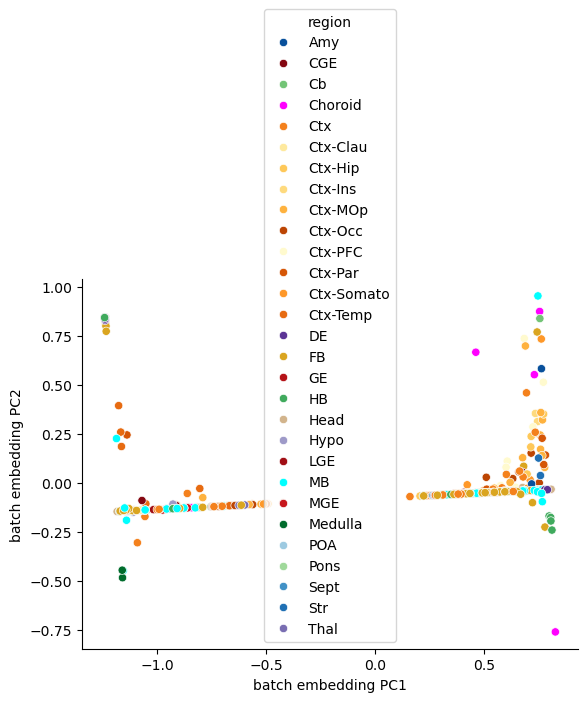

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:114: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  seaborn.scatterplot(data=df, x=0, y=1, hue=color_key,palette = colors)


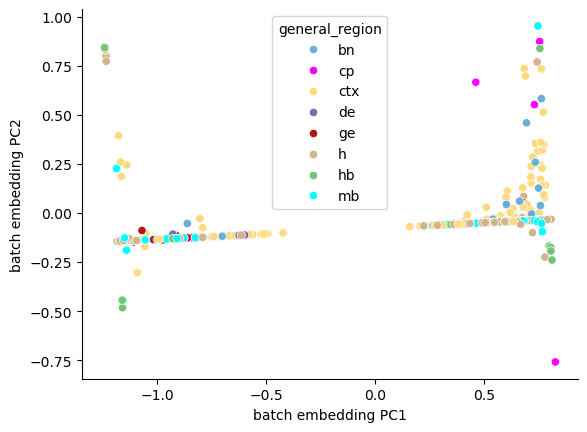

,0,1,batch_name,general_region
0,-0.963063,-0.132712,CS12OpticVesicle_kOut,h
1,0.425462,-0.053974,CS13_anterior_midbrain_kOut,mb
2,0.436141,-0.053193,CS13_central_midbrain_kOut,mb
3,-0.752397,-0.120658,CS13_hindbrain_kOut,hb
4,-1.044344,-0.137283,CS13_olfactory_pacode_kOut,h
...,...,...,...,...
415,0.632760,-0.043174,p0-WT2,ctx
416,0.393658,-0.056411,p0-WT3,ctx
417,0.380067,-0.056397,p0-WT4,ctx
418,0.159202,-0.069150,p07_Cortex_SRR11947654,ctx


In [12]:
antipode.plotting.plot_batch_embedding_pca(antipode_model, save=True)
antipode.plotting.plot_batch_embedding_pca(antipode_model,color_key='region', save=False)
antipode.plotting.plot_batch_embedding_pca(antipode_model,color_key='general_region', save=False)

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:174: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(filename, format='svg')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


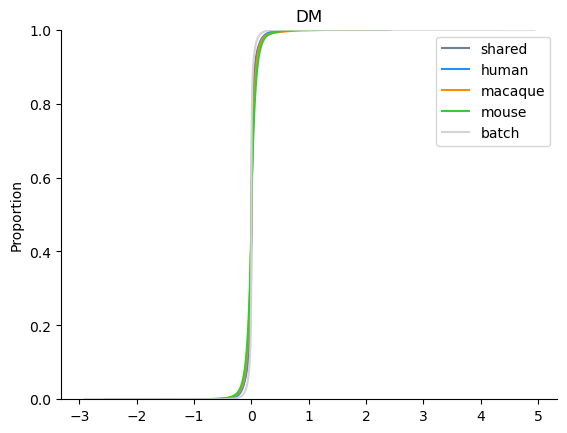

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:199: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(filename, format='svg')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


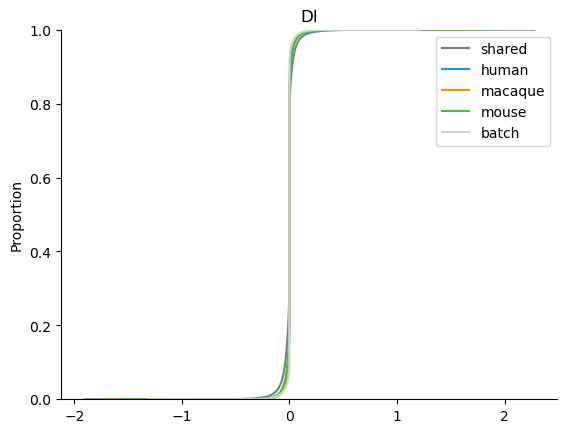

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/plotting.py:220: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(filename, format='svg')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


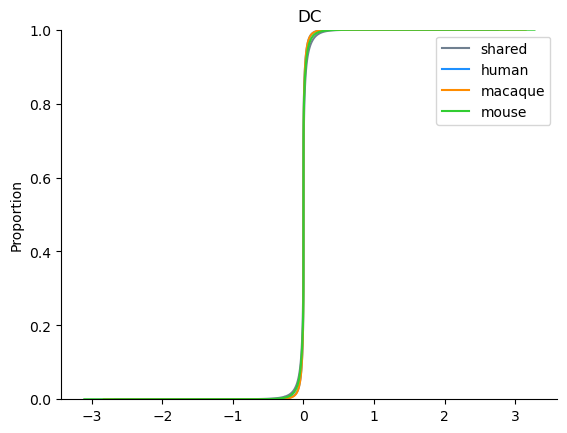

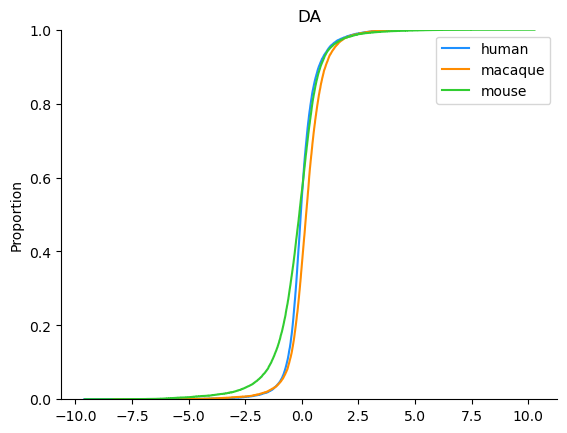

In [13]:
antipode.plotting.plot_d_hists(antipode_model,bins=50,save=True,ecdf=True)

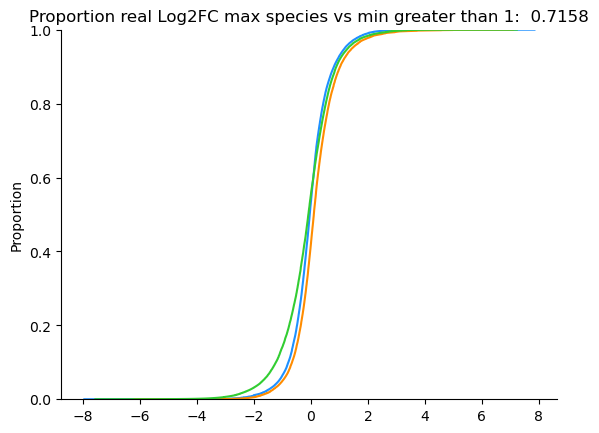

In [14]:
#Check for DE assumption validitity
centered_means = log_real_means-log_real_means.mean(0)

seaborn.ecdfplot((centered_means)[0].flatten(),color=adata.uns['species_colors'][0])
seaborn.ecdfplot((centered_means)[1].flatten(),color=adata.uns['species_colors'][1])
seaborn.ecdfplot((centered_means)[2].flatten(),color=adata.uns['species_colors'][2])
filename = os.path.join(sc.settings.figdir, 'real_fc_trispecies_mean.pdf')
plt.title(f'Proportion real Log2FC max species vs min greater than 1:  {(np.abs(centered_means.max(0)-centered_means.min(0))>np.log(2)).mean():.4f}')
plt.savefig(filename, format='svg')
plt.show()


<Axes: xlabel='neighborhood_jaccard_mouse_human', ylabel='neighborhood_jaccard_macaque_mouse'>

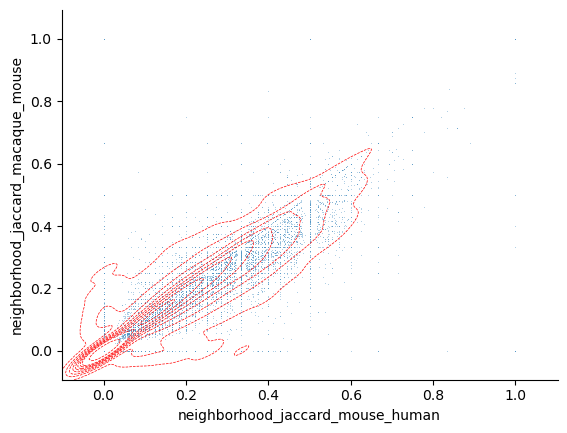

In [15]:
seaborn.scatterplot(x=adata.var['neighborhood_jaccard_mouse_human'],y=adata.var['neighborhood_jaccard_macaque_mouse'],alpha=0.5,s=0.5)
seaborn.kdeplot(x=adata.var['neighborhood_jaccard_mouse_human'],y=adata.var['neighborhood_jaccard_macaque_mouse'],color='red',linestyles='--', linewidths=0.5)

<Axes: xlabel='neighborhood_jaccard_human_macaque', ylabel='neighborhood_jaccard_macaque_mouse'>

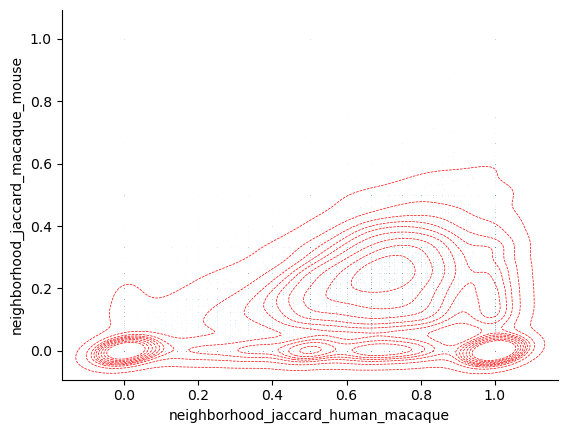

In [16]:
seaborn.scatterplot(x=adata.var['neighborhood_jaccard_human_macaque'],y=adata.var['neighborhood_jaccard_macaque_mouse'],alpha=0.1,s=0.2)
seaborn.kdeplot(x=adata.var['neighborhood_jaccard_human_macaque'],y=adata.var['neighborhood_jaccard_macaque_mouse'],color='red',linestyles='--', linewidths=0.5)

In [17]:
# l2_class_dict=adata.obs.groupby(leaf_key)['curated_class_label'].value_counts().unstack().idxmax(1).to_dict()
# l2_idx_class_dict=dict(zip([int(x) for x in l2_class_dict.keys()],l2_class_dict.values()))
# cc_colordict=dict(zip(adata.obs['curated_class_label'].cat.categories,adata.uns['curated_class_label_colors']))
# l2_to_class=[l2_class_dict[x] for x in cluster_labels]
# l2_to_color=[cc_colordict[x] for x in l2_to_class]

In [18]:
adata.var

,highly_variable,highly_variable_intersection,highly_variable_nbatches,highly_variable_rank,mean,means,n_cells,std,variances,variances_norm,...,m_right_flank,m_syntenic,h_gene,h_gene_size,h_left_flank,h_right_flank,h_syntenic,neighborhood_jaccard_human_macaque,neighborhood_jaccard_macaque_mouse,neighborhood_jaccard_mouse_human
TRAPPC2,False,False,3,13558.0,0.091585,0.197430,353360,0.247496,0.292209,0.755270,...,3.614264,True,TRAPPC2,4.350093,3.240799,2.045323,True,0.285714,0.176471,0.428571
C17orf49,True,False,3,1754.0,0.067238,0.204596,216187,0.232383,0.690524,1.655286,...,0.000000,True,C17orf49,3.481586,0.000000,0.000000,True,0.640000,0.285714,0.421053
C2orf68,True,False,3,9326.0,0.137744,0.272953,410871,0.339803,0.617266,0.841766,...,3.361728,True,C2orf68,3.833338,0.000000,3.904824,True,0.857143,0.600000,0.692308
C4orf19,True,False,2,6818.5,0.004606,0.011372,22585,0.055179,0.015842,0.848978,...,3.967220,True,C4orf19,5.229352,3.649627,0.000000,True,1.000000,0.000000,0.000000
C4orf54,True,False,3,7826.0,0.000146,0.000275,603,0.010223,0.000319,0.881658,...,3.921634,True,C4orf54,4.258158,4.026002,5.209997,True,1.000000,0.285714,0.285714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11B,False,False,3,12978.0,0.067634,0.130719,254278,0.219035,0.167035,0.781506,...,3.966658,True,ZYG11B,5.003822,4.070370,0.000000,True,0.200000,0.111111,0.090909
ZYX,True,False,3,3798.0,0.054287,0.130729,229251,0.189356,0.223776,1.088767,...,0.000000,True,ZYX,3.991979,2.903633,0.000000,True,0.928571,0.238095,0.285714
ZZEF1,True,False,3,10276.0,0.031103,0.061481,127568,0.147165,0.074848,0.804135,...,0.000000,True,ZZEF1,5.141719,4.353089,0.000000,True,0.750000,0.000000,0.000000
ASIP,True,False,3,6903.0,0.000689,0.001764,3411,0.021146,0.002570,0.871379,...,0.000000,True,ASIP,4.873762,4.764064,0.000000,True,0.666667,0.000000,0.000000


<Axes: ylabel='Count'>

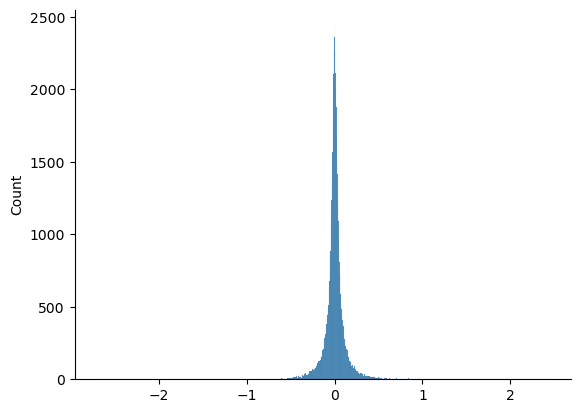

In [19]:
seaborn.histplot((pstore['locs'][cluster_index,:]+pstore['discov_dm'][:,cluster_index,:].mean(0)).flatten())

In [20]:
overall_lfc.shape

(3, 380, 16738)

In [21]:
discov_cluster_params.shape

(3, 380, 16738)

In [ ]:
x = (discov_cluster_params-discov_cluster_params.mean(0)).flatten()
y = overall_lfc.flatten()
# Filter out extreme low values
mask = (y < -10) | (y > 10) | np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y)
x, y = x[~mask], y[~mask]
# Sample up to 100000 points
num_points = min(200000, x.shape[0])
randinds = np.random.choice(np.arange(x.shape[0]), size=num_points, replace=False)

seaborn.scatterplot(x=x[randinds], y=y[randinds], s=0.2, color='black')
seaborn.kdeplot(x=x[randinds], y=y[randinds], linestyles='--', color='red', linewidths=0.5)
plt.xlabel('reconstructed log mean cluster exp')
plt.ylabel('DESeq2 centered LFC')

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
x_values = np.linspace(np.min(x), np.max(x), 100)
plt.plot(x_values, slope * x_values + intercept, color='blue',
         label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')
plt.title('Mean within species (species x clusters x genes)')
plt.legend()

filename = os.path.join(sc.settings.figdir, 'deseq_vs_de.png')
plt.savefig(filename, format='png')
plt.show()

In [ ]:
x = (log_real_means-log_real_means.mean(0)).flatten()
y = overall_lfc.flatten()
# Filter out extreme low values
mask = (y < -10) | (y > 10) | np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y)
x, y = x[~mask], y[~mask]
# Sample up to 100000 points
num_points = min(200000, x.shape[0])
randinds = np.random.choice(np.arange(x.shape[0]), size=num_points, replace=False)

seaborn.scatterplot(x=x[randinds], y=y[randinds], s=0.2, color='black')
seaborn.kdeplot(x=x[randinds], y=y[randinds], linestyles='--', color='red', linewidths=0.5)
plt.xlabel('reconstructed log mean cluster exp')
plt.ylabel('DESeq2 centered LFC')

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
x_values = np.linspace(np.min(x), np.max(x), 100)
plt.plot(x_values, slope * x_values + intercept, color='blue',
         label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')
plt.title('Mean within species (species x clusters x genes)')
plt.legend()

filename = os.path.join(sc.settings.figdir, 'deseq_vs_logrealmeansde.png')
plt.savefig(filename, format='png')
plt.show()

In [ ]:

x = (prop_discov_di-prop_discov_di.mean(0)).flatten()
y = overall_lfc.flatten()
# Filter out extreme low values
mask = (y < -10) | (y > 10) | np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y)
x, y = x[~mask], y[~mask]
# Sample up to 100000 points
num_points = min(200000, x.shape[0])
randinds = np.random.choice(np.arange(x.shape[0]), size=num_points, replace=False)

seaborn.scatterplot(x=x[randinds], y=y[randinds], s=0.2, color='black')
# seaborn.kdeplot(x=x[randinds], y=y[randinds], linestyles='--', color='red', linewidths=0.5)
plt.xlabel('reconstructed log mean cluster exp')
plt.ylabel('DESeq2 centered LFC')

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
x_values = np.linspace(np.min(x), np.max(x), 100)
plt.plot(x_values, slope * x_values + intercept, color='blue',
         label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')
plt.title('Mean within species (species x clusters x genes)')
plt.legend()

filename = os.path.join(sc.settings.figdir, 'deseq_vs_de.png')
plt.savefig(filename, format='png')
plt.show()

In [25]:
# sc.tl.dendrogram(adata,groupby='Initial_Class_markers',use_rep='X_antipode',linkage_method='average',cor_method='kendall')
# sc.pl.dendrogram(adata,groupby='Initial_Class_markers')
# adata.obs['Initial_Class_markers'] = adata.obs['Initial_Class_markers'].cat.reorder_categories(adata.uns['dendrogram_Initial_Class_markers']['categories_ordered'])

In [26]:
Initial_Class_log_real_means,Initial_Class_real_mean_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,'Initial_Class_markers',layer=layer_key)

100%|██████████| 294/294 [03:02<00:00,  1.61it/s]


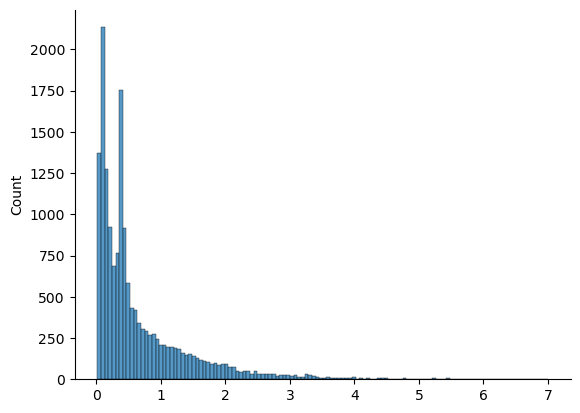

In [27]:
seaborn.histplot(Initial_Class_log_real_means.mean(0).var(0).flatten()) #Initial_Class gene vars
gene_vars = Initial_Class_log_real_means.mean(0).var(0).flatten()
hvg = gene_vars > np.quantile(gene_vars,0.75)

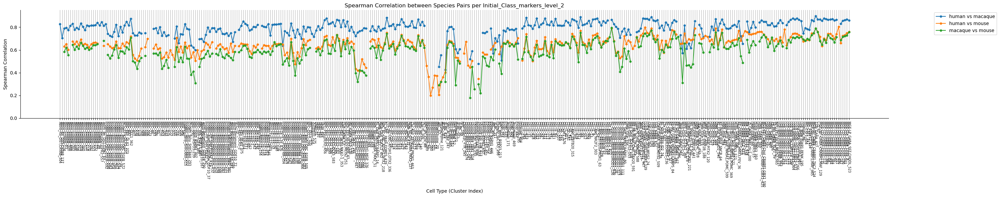

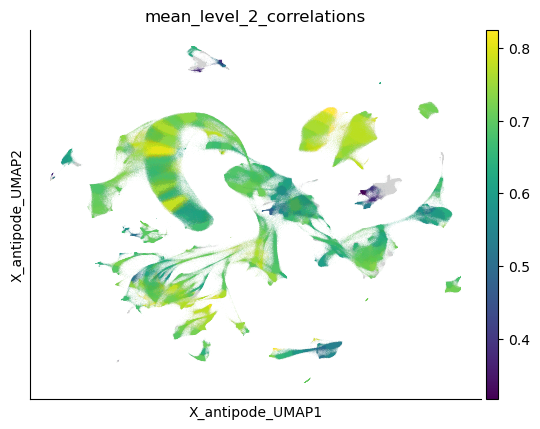

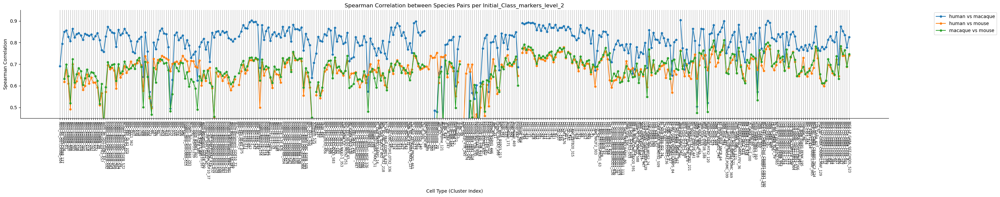

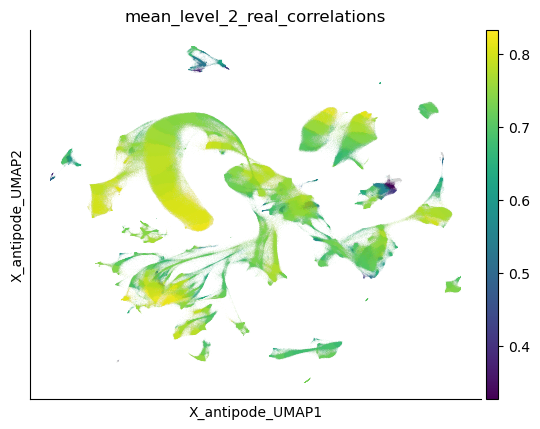

In [28]:
from scipy.stats import spearmanr, pearsonr
import matplotlib.pyplot as plt
import itertools

num_species = log_real_means.shape[0]
num_clusters = log_real_means.shape[1]
species_cats = adata.obs['species'].cat.categories

# Generate all species pairs (combinations)
species_pairs = list(itertools.combinations(range(num_species), 2))
correlations = {pair: [] for pair in species_pairs}

discov_cluster_params_noda = discov_cluster_params-pstore['discov_constitutive_de'][:, np.newaxis, :]

# Compute Spearman correlation for each cell type for every species pair
for cluster in range(num_clusters):
    for pair in species_pairs:
        i, j = pair
        # Extract gene expression vectors for the current cell type
        # expr_i = log_real_means[i, cluster, :]
        # expr_j = log_real_means[j, cluster, :]
        expr_i = discov_cluster_params_noda[i, cluster, :]
        expr_j = discov_cluster_params_noda[j, cluster, :]
        rho, _ = spearmanr(expr_i, expr_j)
        correlations[pair].append(rho)

# Create the line plot
x = np.arange(num_clusters)
plt.figure(figsize=(30, 6))
for pair, corr_vals in correlations.items():
    label = f"{species_cats[pair[0]]} vs {species_cats[pair[1]]}"
    plt.plot(x, corr_vals, marker='o',markersize=4, label=label)

plt.xticks(ticks=x, labels=adata.obs[leaf_key].cat.categories, rotation=270,fontsize=7)
plt.xlabel("Cell Type (Cluster Index)")
plt.ylabel("Spearman Correlation")
plt.title("Spearman Correlation between Species Pairs per "+leaf_key)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Place legend outside the plot
plt.tight_layout()
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.ylim(0.0, 0.95)
ax.grid(axis='x')
filename = os.path.join(sc.settings.figdir, 'level_2_spearman_xs.svg')
plt.tight_layout()
plt.savefig(filename, format='svg')
plt.show()


adata.obs['mean_level_2_correlations'] = adata.obs[leaf_key].replace(dict(zip(adata.obs[leaf_key].cat.categories,np.mean(np.array(list(correlations.values())),0)))).astype(float)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['mean_level_2_correlations'], save='_mean_level_2_correlations.pdf'
)
                                              
species_pairs = list(itertools.combinations(range(num_species), 2))
correlations = {pair: [] for pair in species_pairs}
# Compute Spearman correlation for each cell type for every species pair
for cluster in range(num_clusters):
    for pair in species_pairs:
        i, j = pair
        # Extract gene expression vectors for the current cell type
        expr_i = log_real_means[i, cluster, hvg]
        expr_j = log_real_means[j, cluster, hvg]
        # expr_i = discov_cluster_params[i, cluster, :]
        # expr_j = discov_cluster_params[j, cluster, :]
        rho, _ = spearmanr(expr_i, expr_j)
        correlations[pair].append(rho)

# Create the line plot
x = np.arange(num_clusters)
plt.figure(figsize=(30, 6))
for pair, corr_vals in correlations.items():
    label = f"{species_cats[pair[0]]} vs {species_cats[pair[1]]}"
    plt.plot(x, corr_vals, marker='o',markersize=4, label=label)

plt.xticks(ticks=x, labels=adata.obs[leaf_key].cat.categories, rotation=270,fontsize=7)
plt.xlabel("Cell Type (Cluster Index)")
plt.ylabel("Spearman Correlation")
plt.title("Spearman Correlation between Species Pairs per "+leaf_key)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Place legend outside the plot
plt.tight_layout()
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.ylim(0.45, 0.95)
ax.grid(axis='x')
filename = os.path.join(sc.settings.figdir, 'level_2_spearman_xs_real.svg')
plt.tight_layout()
plt.savefig(filename, format='svg')
plt.show()

adata.obs['mean_level_2_real_correlations'] = adata.obs[leaf_key].replace(dict(zip(adata.obs[leaf_key].cat.categories,np.mean(np.array(list(correlations.values())),0)))).astype(float)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['mean_level_2_real_correlations'], save='_mean_level_2_real_correlations.pdf'
)


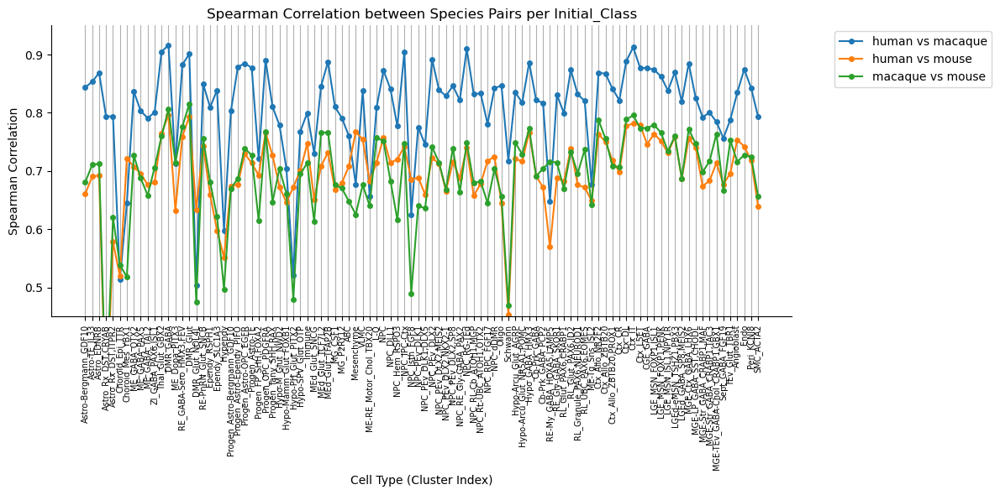

In [29]:
from scipy.stats import spearmanr
import matplotlib.pyplot as plt
import itertools

num_species = Initial_Class_log_real_means.shape[0]
num_clusters = Initial_Class_log_real_means.shape[1]
species_cats = adata.obs[discov_key].cat.categories

# Generate all species pairs (combinations)
species_pairs = list(itertools.combinations(range(num_species), 2))
correlations = {pair: [] for pair in species_pairs}

# Compute Spearman correlation for each cell type for every species pair
for cluster in range(num_clusters):
    for pair in species_pairs:
        i, j = pair
        # Extract gene expression vectors for the current cell type
        expr_i = Initial_Class_log_real_means[i, cluster, hvg]
        expr_j = Initial_Class_log_real_means[j, cluster, hvg]
        rho, _ = spearmanr(expr_i, expr_j)
        correlations[pair].append(rho)

# Create the line plot
x = np.arange(num_clusters)
plt.figure(figsize=(12, 6))
for pair, corr_vals in correlations.items():
    label = f"{species_cats[pair[0]]} vs {species_cats[pair[1]]}"
    plt.plot(x, corr_vals, marker='o',markersize=4, label=label)

plt.xticks(ticks=x, labels=adata.obs['Initial_Class_markers'].cat.categories, rotation=90,fontsize=7)
plt.xlabel("Cell Type (Cluster Index)")
plt.ylabel("Spearman Correlation")
plt.title("Spearman Correlation between Species Pairs per Initial_Class")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  # Place legend outside the plot
plt.tight_layout()
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.ylim(0.45, .95)
ax.grid(axis='x')
filename = os.path.join(sc.settings.figdir, 'Initial_Class_xs_correlations.svg')
plt.tight_layout()
plt.savefig(filename, format='svg')
plt.show()


# Marginal DE Associations

In [30]:
# Ignore dc x dm interaction
# di_diffs=np.einsum('pm,mg->pg',prop_locs,pstore['z_decoder_weight'])+(prop_discov_di)
# dc_diffs=np.einsum('pm,dmg->dpg',prop_locs,pstore['z_decoder_weight']+pstore['discov_dc'])
# dm_diffs=np.einsum('dpm,mg->dpg',prop_locs+prop_discov_dm,pstore['z_decoder_weight'])
# Calculate with dc x dm interaction
di_diffs = prop_discov_di
da_diffs = np.repeat(np.expand_dims(pstore['discov_constitutive_de'], axis=1), prop_discov_di.shape[1], axis=1)
dm_diffs = np.einsum('dpm,dmg->dpg',prop_locs+prop_discov_dm,pstore['z_decoder_weight']+pstore['discov_dc']) - np.einsum('pm,dmg->dpg',prop_locs,pstore['z_decoder_weight']+pstore['discov_dc'])
dc_diffs = np.einsum('dpm,dmg->dpg',prop_locs+prop_discov_dm,pstore['z_decoder_weight']+pstore['discov_dc']) - np.einsum('dpm,mg->dpg',prop_locs+prop_discov_dm,pstore['z_decoder_weight'])
de_diffs = discov_cluster_params-da_diffs

In [31]:
adata.var['q_intergenic'] = np.log10(10**(adata.var['q_left_flank']) + 10**(adata.var['q_right_flank']) + 1)
adata.var['h_intergenic'] = np.log10(10**(adata.var['h_left_flank']) + 10**(adata.var['h_right_flank']) + 1)
adata.var['m_intergenic'] = np.log10(10**(adata.var['m_left_flank']) + 10**(adata.var['m_right_flank']) + 1)

In [32]:
adata.var

,highly_variable,highly_variable_intersection,highly_variable_nbatches,highly_variable_rank,mean,means,n_cells,std,variances,variances_norm,...,h_gene_size,h_left_flank,h_right_flank,h_syntenic,neighborhood_jaccard_human_macaque,neighborhood_jaccard_macaque_mouse,neighborhood_jaccard_mouse_human,q_intergenic,h_intergenic,m_intergenic
TRAPPC2,False,False,3,13558.0,0.091585,0.197430,353360,0.247496,0.292209,0.755270,...,4.350093,3.240799,2.045323,True,0.285714,0.176471,0.428571,3.238046,3.267875,3.614475
C17orf49,True,False,3,1754.0,0.067238,0.204596,216187,0.232383,0.690524,1.655286,...,3.481586,0.000000,0.000000,True,0.640000,0.285714,0.421053,0.477121,0.477121,1.869232
C2orf68,True,False,3,9326.0,0.137744,0.272953,410871,0.339803,0.617266,0.841766,...,3.833338,0.000000,3.904824,True,0.857143,0.600000,0.692308,0.477121,3.904932,3.362105
C4orf19,True,False,2,6818.5,0.004606,0.011372,22585,0.055179,0.015842,0.848978,...,5.229352,3.649627,0.000000,True,1.000000,0.000000,0.000000,3.640581,3.649821,4.045010
C4orf54,True,False,3,7826.0,0.000146,0.000275,603,0.010223,0.000319,0.881658,...,4.258158,4.026002,5.209997,True,1.000000,0.285714,0.285714,5.200489,5.237539,3.921738
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11B,False,False,3,12978.0,0.067634,0.130719,254278,0.219035,0.167035,0.781506,...,5.003822,4.070370,0.000000,True,0.200000,0.111111,0.090909,3.436640,4.070444,4.320956
ZYX,True,False,3,3798.0,0.054287,0.130729,229251,0.189356,0.223776,1.088767,...,3.991979,2.903633,0.000000,True,0.928571,0.238095,0.285714,2.716838,2.904716,0.477121
ZZEF1,True,False,3,10276.0,0.031103,0.061481,127568,0.147165,0.074848,0.804135,...,5.141719,4.353089,0.000000,True,0.750000,0.000000,0.000000,4.417953,4.353127,1.939519
ASIP,True,False,3,6903.0,0.000689,0.001764,3411,0.021146,0.002570,0.871379,...,4.873762,4.764064,0.000000,True,0.666667,0.000000,0.000000,4.894848,4.764079,0.477121


In [33]:
diffs=['da_diffs','di_diffs','dm_diffs','dc_diffs']
param={
    "dc_diffs":dc_diffs-np.mean(dc_diffs,axis=0),
    "di_diffs":di_diffs-np.mean(di_diffs,axis=0),
    "dm_diffs":dm_diffs-np.mean(dm_diffs,axis=0),
    "da_diffs":da_diffs-np.mean(da_diffs,axis=0),
    "de_diffs":de_diffs-np.mean(de_diffs,axis=0),
    # "de_diffs":discov_cluster_params-discov_cluster_params.mean(0),
    # "de_vars":np.repeat(np.expand_dims(discov_cluster_params.var(0),0),discov_cluster_params.shape[0],axis=0)
    # "de_vars":np.repeat(np.expand_dims(np.absolute(log_real_means[0]-log_real_means[2]),0),discov_cluster_params.shape[0],axis=0)
}
num_species = discov_cluster_params.shape[0]
num_cell_types = discov_cluster_params.shape[1]
num_genes = discov_cluster_params.shape[2]

covs=['variances_norm', 'means', 'q_gene_size', 'q_intergenic', 'q_syntenic', 'm_gene_size', 'm_intergenic', 'm_syntenic', 'h_gene_size', 'h_intergenic', 'h_syntenic', 'neighborhood_jaccard_human_macaque', 'neighborhood_jaccard_macaque_mouse', 'neighborhood_jaccard_mouse_human']


# Generate random data for demonstration
#colors = l2_to_color  # Example color vector of length num_cell_types
colors = list(adata.uns['species_colors'])

# Point shapes for different species
shapes = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h', '+', 'x', '|', '_']

# Ensure we have enough shapes for species
assert len(shapes) >= num_species, "Not enough shapes for the number of species."

# Create a DataFrame for easier plotting with Seaborn
data = []
for species_idx in range(num_species):
    for cell_type_idx in range(discov_cluster_params.shape[1]):
        d={c:adata.var[c] for c in covs}
        for k in param.keys():
            d[k]=np.absolute(param[k][species_idx, cell_type_idx, :])
        d[discov_key]=np.repeat(adata.obs[discov_key].cat.categories[species_idx],num_genes)
        d['cluster']=np.repeat(leaf_labels[cell_type_idx],num_genes)
        d=pd.DataFrame(d)
        d['gene']=list(d.index)
        data.append(d)

df = pd.concat(data,axis=0)


In [34]:
for k in param.keys():
    np.save(os.path.join(model_path, f'{k}_centered.npy'), param[k])

In [35]:
fit_xs_scores = pd.read_csv('/home/matthew.schmitz/WbFigures/RegionalClocks/fit_xs_scores_scores.tsv',sep='\t',index_col=0)
fit_dt_scores = pd.read_csv('/home/matthew.schmitz/WbFigures/RegionalClocks/fit_dt_scores_scores.tsv',sep='\t',index_col=0)
fit_com_scores = pd.read_csv('/home/matthew.schmitz/WbFigures/RegionalClocks/fit_mu_scores_scores.tsv',sep='\t',index_col=0)
param={k:np.load(os.path.join(model_path, f'{k}_centered.npy')) for k in ["dc_diffs","di_diffs","dm_diffs","da_diffs","de_diffs"]}

In [53]:
import xarray as xr
coords = {'species':adata.obs[discov_key].cat.categories,'level_2':adata.obs['Initial_Class_markers_level_2'].cat.categories,'var':adata.var.index}
deds = xr.Dataset({k:xr.DataArray(param[k],dims=['species','level_2','var'],coords=coords) for k in param.keys()})

In [55]:
deds

<xarray.Dataset> Size: 687MB
Dimensions:   (species: 3, level_2: 380, var: 16738)
Coordinates:
  * species   (species) object 24B 'human' 'macaque' 'mouse'
  * level_2   (level_2) object 3kB 'Astro_Rx_DST,CRYAB_304' ... 'MGE-LP_GABA_...
  * var       (var) object 134kB 'TRAPPC2' 'C17orf49' ... 'ASIP' 'CCDC198'
Data variables:
    dc_diffs  (species, level_2, var) float64 153MB nan nan ... -0.4783 -0.3836
    di_diffs  (species, level_2, var) float64 153MB nan nan ... 6.883e-07
    dm_diffs  (species, level_2, var) float64 153MB nan nan ... -0.7785 -0.2785
    da_diffs  (species, level_2, var) float32 76MB -0.311 -0.2115 ... -0.8769
    de_diffs  (species, level_2, var) float64 153MB nan nan ... -0.6205 -0.4255

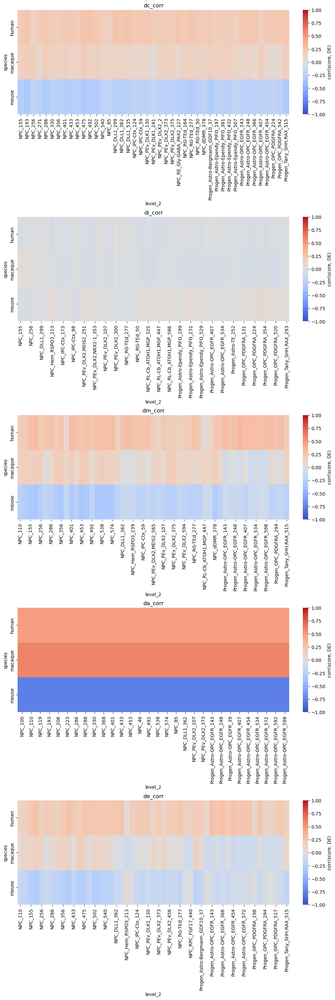

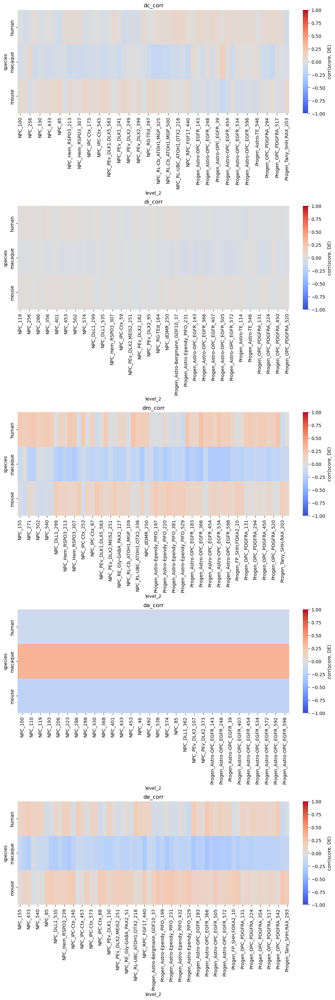

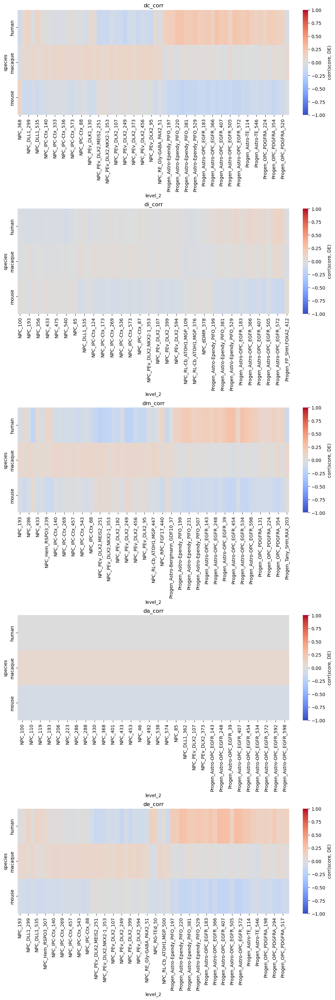

In [79]:
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as seaborn
from typing import Sequence, Literal, Optional

def _nan_corr(x, y, method: Literal["pearson","spearman"]="pearson"):
    x = np.asarray(x).ravel()
    y = np.asarray(y).ravel()
    if x.ndim != 1 or y.ndim != 1:
        return np.nan
    if x.size != y.size:
        return np.nan
    m = np.isfinite(x) & np.isfinite(y)
    if m.sum() < 3:
        return np.nan
    xv, yv = x[m], y[m]
    if method == "spearman":
        from scipy.stats import rankdata
        xv = rankdata(xv).astype(float)
        yv = rankdata(yv).astype(float)
    xs = xv.std(ddof=1); ys = yv.std(ddof=1)
    if xs == 0 or ys == 0:
        return np.nan
    xv = (xv - xv.mean()) / xs
    yv = (yv - yv.mean()) / ys
    return float(np.dot(xv, yv) / (len(xv) - 1))

def compute_correlations(
    deds: xr.Dataset,
    scores: pd.Series,
    de_vars: Optional[Sequence[str]]=None,
    method: Literal["pearson","spearman"]="pearson"
) -> xr.Dataset:
    if de_vars is None:
        de_vars = [k for k, v in deds.data_vars.items() if v.ndim == 3 and k.endswith("_diffs")]
    genes = np.intersect1d(deds["var"].values.astype(str), scores.index.astype(str))
    if len(genes) == 0:
        raise ValueError("No overlapping genes between deds.var and scores.index.")
    genes = pd.Index(genes.astype(str))
    scores_aln = scores.reindex(genes).astype(float).to_numpy()

    out = {}
    for dv in de_vars:
        A = deds[dv].sel(var=genes).transpose("species","level_2","var").to_numpy()  # (S,L,G)
        S, L, G = A.shape
        R = np.full((S, L), np.nan, float)
        for i in range(S):
            for j in range(L):
                R[i, j] = _nan_corr(A[i, j, :], scores_aln, method=method)
        out[dv.replace("_diffs","_corr")] = (("species","level_2"), R)
    return xr.Dataset(out, coords={"species": deds["species"], "level_2": deds["level_2"]})

def plot_heatmaps(corr_ds: xr.Dataset, top_n: int = 30, figsize_per_panel=(10, 6)):
    n_panels = len(corr_ds.data_vars)
    fig, axes = plt.subplots(n_panels, 1, figsize=(figsize_per_panel[0], figsize_per_panel[1]*n_panels), constrained_layout=True)
    if n_panels == 1:
        axes = [axes]
    for ax, name in zip(axes, corr_ds.data_vars):
        R = corr_ds[name]
        keep = []
        for sp in R["species"].values:
            r = R.sel(species=sp).to_pandas()
            top = r.abs().nlargest(min(top_n, r.size)).index
            keep.append(pd.Index(top))
        keep_levels = pd.Index(sorted(pd.unique(np.concatenate(keep))))
        Rsub = R.sel(level_2=keep_levels)
        seaborn.heatmap(
            Rsub.to_pandas(),
            cmap="coolwarm", vmin=-1, vmax=1, center=0,
            cbar_kws={"label": "corr(score, DE)"},
            ax=ax
        )
        ax.set_title(name)
        ax.set_xlabel("level_2")
        ax.set_ylabel("species")
        ax.tick_params(axis='x', labelrotation=90)
    plt.show()

def plot_scatter(
    deds: xr.Dataset,
    scores: pd.Series,
    species: str,
    level_2: str,
    de_var: str = "dc_diffs",
    method: Literal["pearson","spearman"]="pearson"
):
    genes = np.intersect1d(deds["var"].values.astype(str), scores.index.astype(str)).astype(str)
    x = scores.reindex(genes).astype(float)
    y = deds[de_var].sel(species=species, level_2=level_2, var=genes).to_pandas().astype(float)
    m = np.isfinite(x) & np.isfinite(y)
    r = _nan_corr(y.values[m], x.values[m], method=method)
    plt.figure(figsize=(4.8,4.2))
    plt.scatter(x[m], y[m], s=6, alpha=0.6)
    plt.axhline(0, lw=1); plt.axvline(0, lw=1)
    plt.title(f"{de_var} vs scores | {species} – {level_2}\nr={r:.3f} ({method})")
    plt.xlabel("score"); plt.ylabel(de_var)
    plt.tight_layout(); plt.show()

# ---- usage ----
corr_ds = compute_correlations(deds.sel({'level_2':deds.coords['level_2'].data[deds.coords['level_2'].str.contains('NPC|Progen')]}), fit_xs_scores['0'][deds.coords['var'].data], method="spearman")
plot_heatmaps(corr_ds, top_n=30)
corr_ds = compute_correlations(deds.sel({'level_2':deds.coords['level_2'].data[deds.coords['level_2'].str.contains('NPC|Progen')]}), fit_com_scores['0'][deds.coords['var'].data], method="spearman")
plot_heatmaps(corr_ds, top_n=30)
corr_ds = compute_correlations(deds.sel({'level_2':deds.coords['level_2'].data[deds.coords['level_2'].str.contains('NPC|Progen')]}), fit_dt_scores['0'][deds.coords['var'].data], method="spearman")
plot_heatmaps(corr_ds, top_n=30)


In [138]:
scores = dict(zip(['global lateness','stereotypical lateness','differential lateness'],[fit_xs_scores,fit_com_scores,fit_dt_scores]))
deds = deds.sel({'level_2':deds.coords['level_2'].data[deds.coords['level_2'].str.contains('NPC|Progen')]})

In [133]:
deds.coords['level_2']

<xarray.DataArray 'level_2' (level_2: 130)> Size: 1kB
array(['Progen_Astro-OPC_EGFR_592', 'Progen_Astro-OPC_EGFR_598',
       'Progen_Astro-OPC_EGFR_143', 'Progen_Astro-OPC_EGFR_454',
       'Progen_Astro-OPC_EGFR_248', 'Progen_Astro-OPC_EGFR_407',
       'Progen_Astro-OPC_EGFR_534', 'Progen_Astro-OPC_EGFR_39',
       'Progen_Astro-OPC_EGFR_572', 'NPC_PEv_DLX2_107', 'NPC_PEv_DLX2_373',
       'NPC_492', 'NPC_DLL1_362', 'NPC_401', 'NPC_574', 'NPC_538', 'NPC_119',
       'NPC_368', 'NPC_288', 'NPC_100', 'NPC_206', 'NPC_223', 'NPC_46',
       'NPC_193', 'NPC_286', 'NPC_85', 'NPC_110', 'NPC_453', 'NPC_330',
       'NPC_433', 'NPC_475', 'NPC_122', 'NPC_371', 'NPC_155', 'NPC_256',
       'NPC_502', 'NPC_356', 'NPC_540', 'Progen_Tany_SHH,RAX_515',
       'Progen_Tany_SHH,RAX_203', 'Progen_Tany_SHH,RAX_293', 'NPC_271',
       'NPC_Hem_RSPO3_239', 'NPC_Hem_RSPO3_307', 'NPC_Isth_FGF8_189',
       'NPC_RPC_FGF17_440', 'Progen_FP_SHH,FOXA2_10',
       'Progen_Astro-Bergmann_GDF10_37', 'Progen_FP_SHH,FOXA2_412',
       'Progen_Astro-Ependy_PIFO_432', 'Progen_Astro-Ependy_PIFO_470',
       'Progen_Astro-Ependy_PIFO_529', 'Progen_Astro-Ependy_PIFO_199',
       'Progen_Astro-Ependy_PIFO_220', 'Progen_Astro-Ependy_PIFO_197',
       'Progen_Astro-Ependy_PIFO_507', 'Progen_Astro-Ependy_PIFO_231',
       'Progen_Astro-Ependy_PIFO_381', 'NPC_70', 'NPC_PEv_DLX2_2',
       'NPC_PEv_DLX2_375', 'NPC_RG-TEd_164', 'NPC_RG-TEd_277', 'NPC_RG-TEd_50',
       'NPC_RG-TEd_162', 'NPC_RG-TEd_7', 'NPC_RG-TEd_342', 'NPC_RG-TEd_136',
       'NPC_RG-TEd_397', 'Progen_Astro-TE_156', 'Progen_Astro-TE_570',
       'Progen_Astro-TE_114', 'Progen_Astro-TE_252', 'Progen_Astro-TE_546',
       'Progen_OPC_PDGFRA_354', 'Progen_OPC_PDGFRA_517',
       'Progen_OPC_PDGFRA_224', 'Progen_OPC_PDGFRA_542',
       'Progen_OPC_PDGFRA_294', 'Progen_OPC_PDGFRA_450',
       'Progen_OPC_PDGFRA_131', 'Progen_OPC_PDGFRA_198',
       'Progen_OPC_PDGFRA_520', 'Progen_Astro-OPC_EGFR_366',
       'Progen_Astro-OPC_EGFR_183', 'Progen_Astro-OPC_EGFR_505',
       'NPC_DLL1_299', 'NPC_DLL1_535', 'NPC_PEv_DLX2_456', 'NPC_PEv_DLX2_95',
       'NPC_PEv_DLX2_399', 'NPC_PEv_DLX2_594', 'NPC_PEv_DLK1,DLX5_583',
       'NPC_PEv_DLX2_249', 'NPC_PEv_DLX2_182', 'NPC_PEv_DLX2_300',
       'NPC_PEv_DLX2,NKX2-1_353', 'NPC_PEv_DLX2,MEIS2_251',
       'NPC_PEv_DLX2,SP8_43', 'NPC_PEv_DLK1_130', 'NPC_PEv_DLK1_241',
       'NPC_RL-Cb_ATOH1,MGP_447', 'NPC_RL-Cb_ATOH1,MGP_500',
       'NPC_RL-Cb_ATOH1,MGP_109', 'NPC_RL-Cb_ATOH1,MGP_586',
       'NPC_RL-Cb_ATOH1,MGP_325', 'NPC_RL-Cb_ATOH1,MGP_376', 'NPC_dDMR_355',
       'NPC_dDMR_250', 'NPC_dDMR_378', 'NPC_RE_Gly-GABA_PAX2_51',
       'NPC_RL-UBC_ATOH1,OTX2_218', 'NPC_RL-UBC_ATOH1,OTX2_336',
       'NPC_IPC-Ctx_59', 'NPC_IPC-Ctx_124', 'NPC_IPC-Ctx_253',
       'NPC_IPC-Ctx_333', 'NPC_IPC-Ctx_573', 'NPC_IPC-Ctx_457',
       'NPC_IPC-Ctx_536', 'NPC_IPC-Ctx_543', 'NPC_RE_Gly-GABA_PAX2_127',
       'NPC_IPC-Ctx_173', 'NPC_IPC-Ctx_269', 'NPC_IPC-Ctx_87',
       'NPC_IPC-Ctx_140', 'NPC_IPC-Ctx_88', 'NPC_145', 'NPC_Hem_RSPO3_213',
       'NPC_PEv_DLX2,MEIS2_565'], dtype=object)
Coordinates:
  * level_2  (level_2) object 1kB 'Progen_Astro-OPC_EGFR_592' ... 'NPC_PEv_DL...

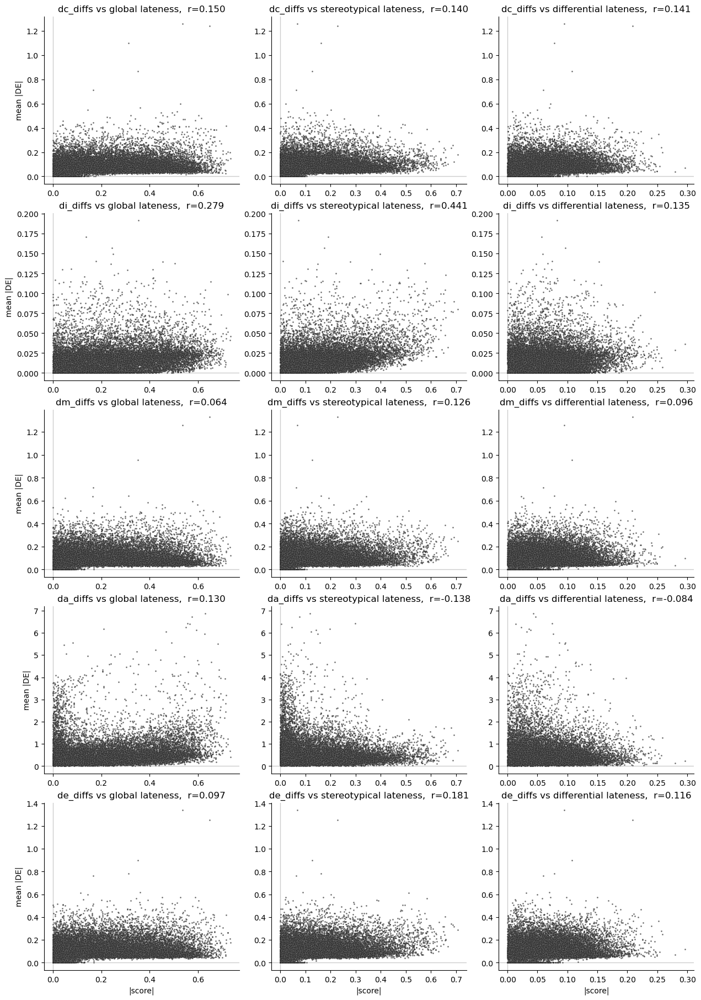

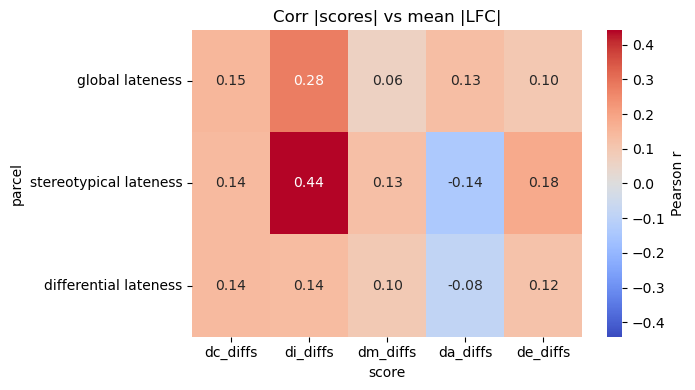

In [167]:
# look for relationships between parcels and 

def _as_series(obj):
    if isinstance(obj, pd.Series):
        return obj
    # common alternatives the user might have
    if isinstance(obj, dict) and '0' in obj and isinstance(obj['0'], (pd.Series, pd.DataFrame)):
        obj = obj['0']
    if isinstance(obj, pd.DataFrame):
        if obj.shape[1] == 1:
            return obj.iloc[:, 0]
        # if there's a column literally named '0', prefer it
        if '0' in obj.columns:
            return obj['0']
        return obj.iloc[:, 0]
    raise TypeError("Scores must be a pandas Series or a 1-col DataFrame (optionally nested under key '0').")

def _pearson_r(x, y):
    m = np.isfinite(x) & np.isfinite(y)
    if m.sum() < 3:
        return np.nan, m.sum()
    xv = x[m]; yv = y[m]
    xs = xv.std(ddof=1); ys = yv.std(ddof=1)
    if xs == 0 or ys == 0:
        return np.nan, m.sum()
    r = float(((xv - xv.mean()) * (yv - yv.mean())).sum() / ((m.sum()-1) * xs * ys))
    return r, m.sum()

de_vars = [k for k, v in deds.data_vars.items() if getattr(v, "ndim", None) == 3]

# precompute mean |DE| per gene across species & level_2
mean_abs_de = {
    k: np.abs(deds[k]).mean(("species","level_2"), skipna=True).to_series()  # index = var
    for k in de_vars
}

score_series = {name: _as_series(obj) for name, obj in scores.items()}

n_rows = len(de_vars)
n_cols = len(score_series)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(4.2*n_cols, 3.6*n_rows), squeeze=False, constrained_layout=True)

for i, k in enumerate(de_vars):
    y_ser = mean_abs_de[k]
    for j, (sname, sser) in enumerate(score_series.items()):
        genes = y_ser.index.astype(str).intersection(sser.index.astype(str))
        y = y_ser.reindex(genes).to_numpy()
        x = sser.reindex(genes).abs().to_numpy()
        r, n = _pearson_r(x, y)

        ax = axes[i, j]
        seaborn.scatterplot(x=x, y=y, s=4, alpha=0.6, ax=ax,c='black')
        ax.axhline(0, lw=1, color="k", alpha=0.2)
        ax.axvline(0, lw=1, color="k", alpha=0.2)

        r_text = f"{r:.3f}" if np.isfinite(r) else "nan"
        ax.set_title(f"{k} vs {sname},  r={r_text}")#, n={n})

        if i == n_rows - 1:
            ax.set_xlabel("|score|")
        else:
            ax.set_xlabel("")
        if j == 0:
            ax.set_ylabel("mean |DE|")
        else:
            ax.set_ylabel("")
plt.savefig(os.path.join(sc.settings.figdir,'lateness_vs_de_corr_scatters.svg'),format = "svg",bbox_inches='tight')
plt.show()

corr_mat = pd.DataFrame(index=de_vars, columns=score_series.keys(), dtype=float)

for k in de_vars:
    y_ser = mean_abs_de[k]
    for sname, sser in score_series.items():
        genes = y_ser.index.astype(str).intersection(sser.index.astype(str))
        y = y_ser.reindex(genes).to_numpy()
        x = sser.reindex(genes).abs().to_numpy()
        r, n = _pearson_r(x, y)
        corr_mat.loc[k, sname] = r


mat_max = np.max(np.abs(corr_mat))
# plot as heatmap
plt.figure(figsize=(7, 4))
seaborn.heatmap(
    corr_mat.astype(float).T,
    annot=True, fmt=".2f", cmap="coolwarm", center=0, vmin=-mat_max, vmax=mat_max,
    cbar_kws={"label": "Pearson r"}
)
plt.title("Corr |scores| vs mean |LFC|")
plt.xlabel("score")
plt.ylabel("parcel")
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir,'lateness_vs_de_corr_heatmap.svg'),format = "svg",bbox_inches='tight')
plt.show()


In [168]:
data = []
species_categories = adata.obs[discov_key].cat.categories  # e.g. ['human', 'macaque', 'mouse']

for species_idx, species in enumerate(species_categories):
    for cell_type_idx in range(discov_cluster_params.shape[1]):
        # Get all covariates (the non-species-specific ones are already here)
        d = {c: adata.var[c] for c in covs}
        # Add the diff values for this species and cell type
        for diff in diffs:
            d[diff] = np.abs(param[diff][species_idx, cell_type_idx, :])
        d[discov_key] = np.repeat(species, num_genes)
        d['cluster'] = np.repeat(leaf_labels[cell_type_idx], num_genes)

        # Add species-specific columns
        if species == 'macaque':
            d['gene_size']   = adata.var['q_gene_size']
            d['intergenic']  = adata.var['q_intergenic']
            d['syntenic']    = adata.var['q_syntenic']
            # For the neighborhood measures, keep only those that involve macaque.
            d['neighborhood_jaccard_human_macaque'] = adata.var['neighborhood_jaccard_human_macaque']
            d['neighborhood_jaccard_macaque_mouse'] = adata.var['neighborhood_jaccard_macaque_mouse']
            d['neighborhood_jaccard_mouse_human'] = np.nan  # not relevant for macaque
        elif species == 'human':
            d['gene_size']   = adata.var['h_gene_size']
            d['intergenic']  = adata.var['h_intergenic']
            d['syntenic']    = adata.var['h_syntenic']
            d['neighborhood_jaccard_human_macaque'] = adata.var['neighborhood_jaccard_human_macaque']
            d['neighborhood_jaccard_macaque_mouse'] = np.nan  # doesn't reference human
            d['neighborhood_jaccard_mouse_human'] = adata.var['neighborhood_jaccard_mouse_human']
        elif species == 'mouse':
            d['gene_size']   = adata.var['m_gene_size']
            d['intergenic']  = adata.var['m_intergenic']
            d['syntenic']    = adata.var['m_syntenic']
            d['neighborhood_jaccard_human_macaque'] = np.nan  # doesn't reference mouse
            d['neighborhood_jaccard_macaque_mouse'] = adata.var['neighborhood_jaccard_macaque_mouse']
            d['neighborhood_jaccard_mouse_human'] = adata.var['neighborhood_jaccard_mouse_human']

        # Build a DataFrame from the dictionary
        df_temp = pd.DataFrame(d)
        df_temp['gene'] = df_temp.index  # preserve gene identity
        data.append(df_temp)

xsd_final = pd.concat(data, axis=0)


In [169]:
del df

In [170]:
xsd_final = xsd_final.drop(['q_gene_size', 'q_intergenic', 'q_syntenic', 'm_gene_size', 'm_intergenic', 'm_syntenic', 'h_gene_size', 'h_intergenic', 'h_syntenic'],axis=1)

In [171]:
xsd_final=xsd_final.reset_index()

In [172]:
xsd_final.columns

Index(['index', 'variances_norm', 'means',
       'neighborhood_jaccard_human_macaque',
       'neighborhood_jaccard_macaque_mouse',
       'neighborhood_jaccard_mouse_human', 'da_diffs', 'di_diffs', 'dm_diffs',
       'dc_diffs', 'species', 'cluster', 'gene_size', 'intergenic', 'syntenic',
       'gene'],
      dtype='object')

In [173]:
rand_plot=np.random.choice(list(range(xsd_final.shape[0])),100000,replace=False)

<Axes: xlabel='dm_diffs', ylabel='Count'>

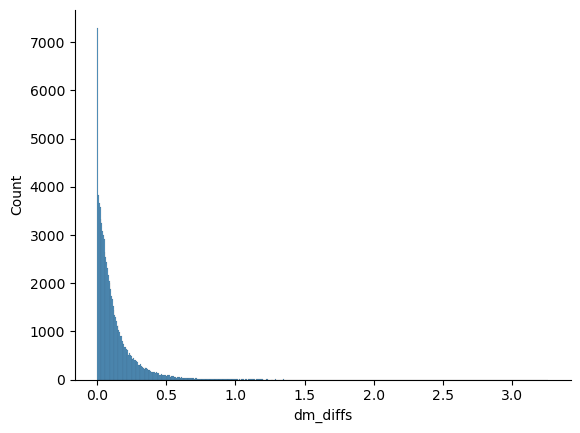

In [174]:
seaborn.histplot(xsd_final.loc[rand_plot,'dm_diffs'])

<Axes: xlabel='di_diffs', ylabel='Count'>

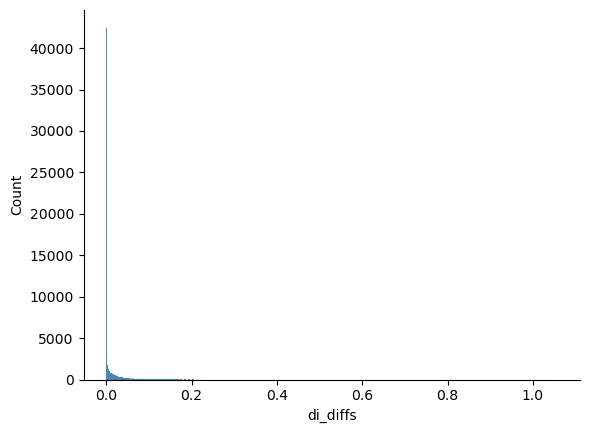

In [175]:
seaborn.histplot(xsd_final.loc[rand_plot,'di_diffs'])

<Axes: xlabel='dc_diffs', ylabel='Count'>

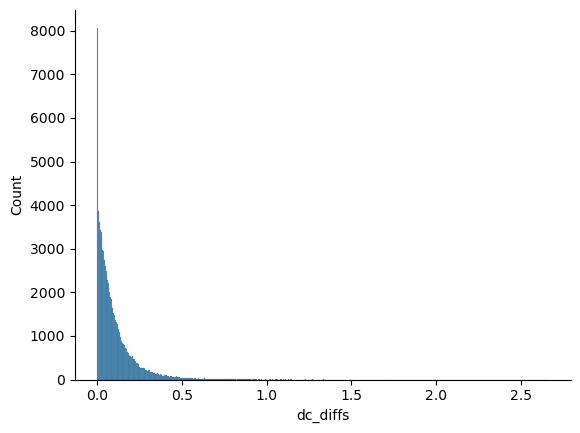

In [176]:
seaborn.histplot(xsd_final.loc[rand_plot,'dc_diffs'])

In [177]:
# seaborn.histplot(xsd_final.loc[rand_plot,'de_vars'])

In [178]:
diff_vars={}
for s in [x for x in xsd_final.columns if 'syntenic' in x]:
    diff_vars[s]=[]
    for d in diffs:
        melted_var=xsd_final.groupby([discov_key,s])[d].mean().unstack().melt(ignore_index=False)
        melted_var[discov_key]=melted_var.index
        melted_var['diff']=d
        diff_vars[s].append(melted_var)
    diff_vars[s]=pd.concat(diff_vars[s],axis=0)

In [179]:
xsd_final.groupby([discov_key,s])[d].var()

species  syntenic
human    False       0.010031
         True        0.011264
macaque  False       0.010025
         True        0.011179
mouse    False       0.045444
         True        0.022735
Name: dc_diffs, dtype: float64

syntenic
         syntenic     value  species      diff
species                                       
human       False  0.867409    human  da_diffs
macaque     False  0.959161  macaque  da_diffs
mouse       False  1.374044    mouse  da_diffs
human        True  0.473572    human  da_diffs
macaque      True  0.561543  macaque  da_diffs
mouse        True  0.722541    mouse  da_diffs
human       False  0.011111    human  di_diffs
macaque     False  0.011017  macaque  di_diffs
mouse       False  0.012222    mouse  di_diffs
human        True  0.017321    human  di_diffs
macaque      True  0.017878  macaque  di_diffs
mouse        True  0.021321    mouse  di_diffs
human       False  0.080098    human  dm_diffs
macaque     False  0.091325  macaque  dm_diffs
mouse       False  0.120625    mouse  dm_diffs
human        True  0.098351    human  dm_diffs
macaque      True  0.121607  macaque  dm_diffs
mouse        True  0.152120    mouse  dm_diffs
human       False  0.076288    human  dc_diffs
maca

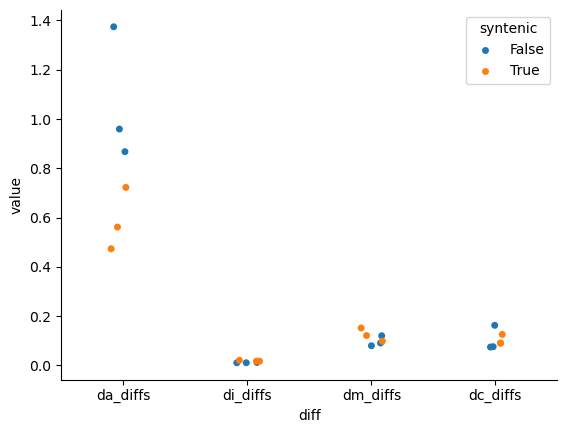

In [180]:
for s in diff_vars.keys():
    print(s)
    print(diff_vars[s])
    seaborn.stripplot(data=diff_vars[s],x='diff',y='value',hue=s)
    plt.show()

p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

di_diffs_True vs. di_diffs_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=5.345e+12
da_diffs_True vs. da_diffs_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=4.128e+12
dm_diffs_True vs. dm_diffs_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=4.927e+12
dc_diffs_True vs. dc_diffs_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=4.602e+12


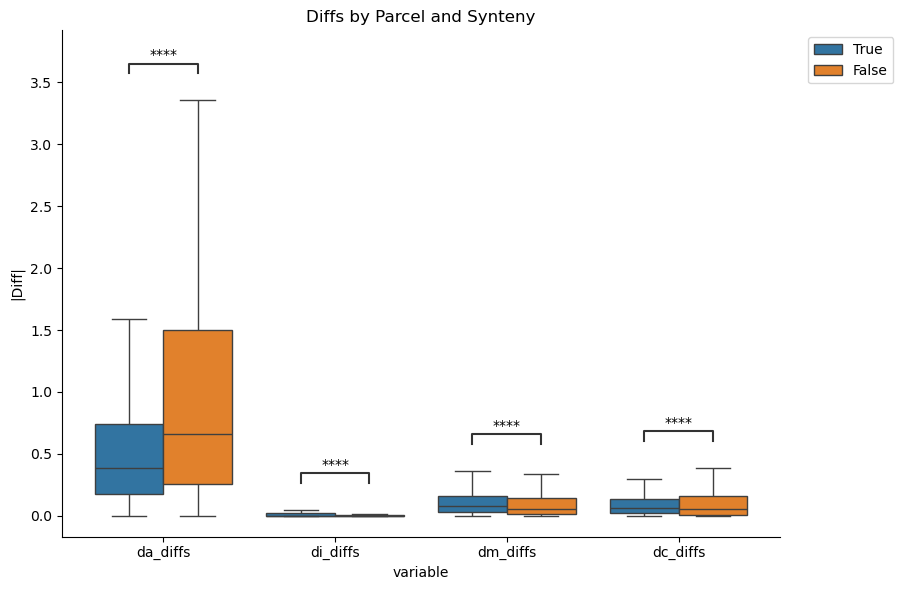

In [181]:
from scipy.stats import mannwhitneyu
from statannotations.Annotator import Annotator

discrete_df=xsd_final.melt(id_vars=[x for x in xsd_final.columns if 'syntenic' in x]+[discov_key],value_vars=['da_diffs','di_diffs','dm_diffs','dc_diffs'])
# seaborn.boxplot(data=discrete_df,hue='syntenic',x='variable',y='value',showfliers=False)
# plt.show()
# for s in discov_labels:
#     seaborn.boxplot(data=discrete_df.loc[discrete_df[discov_key]==s,:],hue='syntenic',x='variable',y='value',showfliers=False)
#     plt.title(s)
#     plt.show()

# Assume 'discrete_df' is already defined with columns: 
# ['syntenic', discov_key, 'variable', 'value']
diffs = [ 'da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']

# Make a copy and convert syntenic to strings.
df = discrete_df.copy()
df['syntenic'] = df['syntenic'].astype(str)

# Define the order for the diff variables (x-axis) and the syntenic groups (hue)
order = [ 'da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']
hue_order = ["True", "False"]

# Define pairs: for each diff variable, compare the "True" group to the "False" group.
pairs = [((diff, "True"), (diff, "False")) for diff in order]

# Create the boxplot with the specified order and hue_order.
fig, ax = plt.subplots(figsize=(8, 6))
seaborn.boxplot(data=df, x='variable', y='value', hue='syntenic',
            order=order, hue_order=hue_order, showfliers=False, ax=ax)
plt.title("Diffs by Parcel and Synteny")
plt.ylabel('|Diff|')
plt.tight_layout()

# Create the Annotator using the same parameters as in your working example.
annot = Annotator(ax, pairs, data=df, x='variable', y='value', 
                  hue='syntenic', order=order, hue_order=hue_order)
annot.configure(test='Mann-Whitney',text_format='star', loc='inside',#pvalue_format=[[1e-20, "****"], [1e-10, "***"], [1e-5, "**"], [1e-1, "*"], [1, "ns"]],
                comparisons_correction='bonferroni', verbose=2)
annot.apply_test()
annot.annotate()

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_boxplots_synteny.svg'), format='svg')
plt.show()

# # Loop over each species
# for s in discov_labels:
#     # Subset the data for the species and convert 'syntenic' to strings
#     df_species = discrete_df[discrete_df[discov_key] == s].copy()
#     df_species['syntenic'] = df_species['syntenic'].astype(str)
    
#     # Create the boxplot for this species
#     fig, ax = plt.subplots(figsize=(8, 6))
#     seaborn.boxplot(
#         data=df_species,
#         x='variable',
#         y='value',
#         hue='syntenic',
#         order=order,
#         hue_order=hue_order,
#         showfliers=False,
#         ax=ax
#     )
#     plt.title(s)
#     plt.ylabel('|Diff|')
#     plt.tight_layout()

#     # Set up the Annotator to perform the Mann-Whitney test and annotate the plot
#     annot = Annotator(
#         ax, pairs, data=df_species, x='variable', y='value',
#         hue='syntenic', order=order, hue_order=hue_order
#     )
#     annot.configure(
#         test='Mann-Whitney',
#         text_format='star',
#         loc='inside',
#         comparisons_correction='bonferroni',
#         verbose=2
#     )
#     annot.apply_test()
#     annot.annotate()
    
#     plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
#     plt.show()


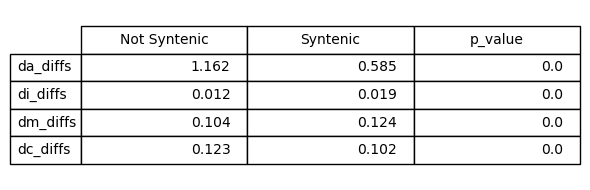

In [182]:
# discrete_df.groupby(['variable','syntenic'])['value'].mean().unstack()

# import numpy as np
# import matplotlib.pyplot as plt

# tbl = discrete_df.groupby(['variable','syntenic'])['value'] \
#                  .mean().unstack()

# fig, ax = plt.subplots(figsize=(5,2))
# ax.axis('off')
# # round the values to 3 decimals and feed into the table
# cell_text = np.round(tbl.values, 3)
# tbl_plot = ax.table(
#     cellText=cell_text,
#     rowLabels=tbl.index,
#     colLabels=tbl.columns,
#     loc='center'
# )
# tbl_plot.auto_set_font_size(False)
# tbl_plot.set_fontsize(10)
# tbl_plot.scale(1, 1.5)
# plt.tight_layout()
# plt.savefig(os.path.join(sc.settings.figdir,'syntenic_table.svg'), format='svg')
# plt.show()

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import mannwhitneyu

# 1) compute the means table exactly as before
tbl = (
    discrete_df
      .groupby(['variable','syntenic'])['value']
      .mean()
      .unstack()    # columns: False, True
)

# 2) compute a p-value for each variable
pvals = {}
for var in order:
    a = discrete_df.loc[
        (discrete_df['variable'] == var) & (discrete_df['syntenic'] == True),
        'value'
    ]
    b = discrete_df.loc[
        (discrete_df['variable'] == var) & (discrete_df['syntenic'] == False),
        'value'
    ]
    a,b = a[~np.isnan(a.to_numpy())],b[~np.isnan(b.to_numpy())]
    _, p = mannwhitneyu(a, b, alternative='two-sided')
    pvals[var] = p

summary = tbl.rename(columns={False:'Not Syntenic', True:'Syntenic'})
summary['p_value'] = pd.Series(pvals)

# 4) round for display
summary = summary.round({'Not Syntenic':3, 'Syntenic':3, 'p_value':3})

# 5) plot it
fig, ax = plt.subplots(figsize=(6, 2))
ax.axis('off')

summary = summary.loc[order,:]
summary = summary.loc[order,:]
cell_text = summary.values.tolist()
col_labels = summary.columns
row_labels = summary.index

tbl_plot = ax.table(
    cellText=cell_text,
    rowLabels=order,
    colLabels=col_labels,
    loc='center'
)
tbl_plot.auto_set_font_size(False)
tbl_plot.set_fontsize(10)
tbl_plot.scale(1, 1.5)

plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'syntenic_table.svg'), 
            format='svg')
plt.show()


In [183]:
##scaled, I don't think this is valid but was useful for visualization
# from scipy.stats import mannwhitneyu
# from statannotations.Annotator import Annotator

# discrete_df=xsd_final.melt(id_vars=[x for x in xsd_final.columns if 'syntenic' in x]+[discov_key],value_vars=['da_diffs','di_diffs','dm_diffs','dc_diffs'])
# # seaborn.boxplot(data=discrete_df,hue='syntenic',x='variable',y='value',showfliers=False)
# # plt.show()
# # for s in discov_labels:
# #     seaborn.boxplot(data=discrete_df.loc[discrete_df[discov_key]==s,:],hue='syntenic',x='variable',y='value',showfliers=False)
# #     plt.title(s)
# #     plt.show()
# discrete_df['value_norm'] = discrete_df['value'] / discrete_df.groupby('variable')['value'].transform('mean')

# # Assume 'discrete_df' is already defined with columns: 
# # ['syntenic', discov_key, 'variable', 'value']
# diffs = [ 'da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']

# # Make a copy and convert syntenic to strings.
# df = discrete_df.copy()
# df['syntenic'] = df['syntenic'].astype(str)

# # Define the order for the diff variables (x-axis) and the syntenic groups (hue)
# order = [ 'da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']
# hue_order = ["True", "False"]

# # Define pairs: for each diff variable, compare the "True" group to the "False" group.
# pairs = [((diff, "True"), (diff, "False")) for diff in order]

# # Create the boxplot with the specified order and hue_order.
# fig, ax = plt.subplots(figsize=(8, 6))
# seaborn.boxplot(data=df, x='variable', y='value_norm', hue='syntenic',
#             order=order, hue_order=hue_order, showfliers=False, ax=ax)
# plt.title("Diffs by Parcel and Synteny")
# plt.ylabel('|Diff| / mean parcel |Diff|')

# # Create the Annotator using the same parameters as in your working example.
# annot = Annotator(ax, pairs, data=df, x='variable', y='value_norm', 
#                   hue='syntenic', order=order, hue_order=hue_order)
# annot.configure(test='Mann-Whitney',text_format='star', loc='inside',#pvalue_format=[[1e-20, "****"], [1e-10, "***"], [1e-5, "**"], [1e-1, "*"], [1, "ns"]],
#                 comparisons_correction='bonferroni', verbose=2)
# annot.apply_test()
# annot.annotate()

# # plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
# # plt.tight_layout()
# # plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_boxplots_synteny.svg'), format='svg')
# # plt.show()



In [184]:
tf_list = pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/gene_lists/TFs_lambert_pmid29425488_1.01.txt')

In [185]:
shared_tfs = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/dev_adult_shared_tfs.tsv',sep='\t',index_col=0)
neuron_shared_tfs = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/dev_adult_shared_neuron_tfs.tsv',sep='\t',index_col=0)
shared_tfs = shared_tfs.loc[~shared_tfs['tfs'].isna()]
neuron_shared_tfs = neuron_shared_tfs.loc[~neuron_shared_tfs['tfs'].isna()]
shared_tfs_list = list(set([x for sublist in shared_tfs['tfs'].str.split(',') for x in sublist if len(x)]))
neuron_shared_tfs_list = list(set([x for sublist in neuron_shared_tfs['tfs'].str.split(',') for x in sublist]))

In [186]:
xsd_final['neuron_shared_tf'] = xsd_final['gene'].isin(neuron_shared_tfs_list)
xsd_final['shared_tf'] = xsd_final['gene'].isin(shared_tfs_list)
xsd_final['tf'] = xsd_final['index'].isin(tf_list.hgnc_symbol)
xsd_final.loc[:,['da_diffs','dc_diffs','gene','neuron_shared_tf','shared_tf','tf']]

,da_diffs,dc_diffs,gene,neuron_shared_tf,shared_tf,tf
0,0.311011,NaN,TRAPPC2,False,False,False
1,0.211482,NaN,C17orf49,False,False,False
2,0.963393,NaN,C2orf68,False,False,False
3,0.226110,NaN,C4orf19,False,False,False
4,0.591248,NaN,C4orf54,False,False,False
...,...,...,...,...,...,...
19081315,0.016608,0.000645,ZYG11B,False,False,False
19081316,0.380388,0.090210,ZYX,False,False,False
19081317,0.059963,0.081981,ZZEF1,False,False,False
19081318,0.312771,0.478347,ASIP,False,False,False


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

dc_diffs_non_tf vs. dc_diffs_non_shared_tf: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:4.520e-11 U_stat=4.917e+12
dm_diffs_non_tf vs. dm_diffs_non_shared_tf: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:2.184e-153 U_stat=4.796e+12
da_diffs_non_tf vs. da_diffs_non_shared_tf: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=6.366e+12
di_diffs_non_tf vs. di_diffs_non_shared_tf: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=5.607e+12
dc_diffs_non_tf vs. dc_diffs_nonneuron_shared_tf: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:0.000e+00 U_stat=1.734e+12
da_diffs_non_tf vs. da_diffs_nonneuron_shared_tf: Mann-Whitney-Wilcoxon test two-sided with

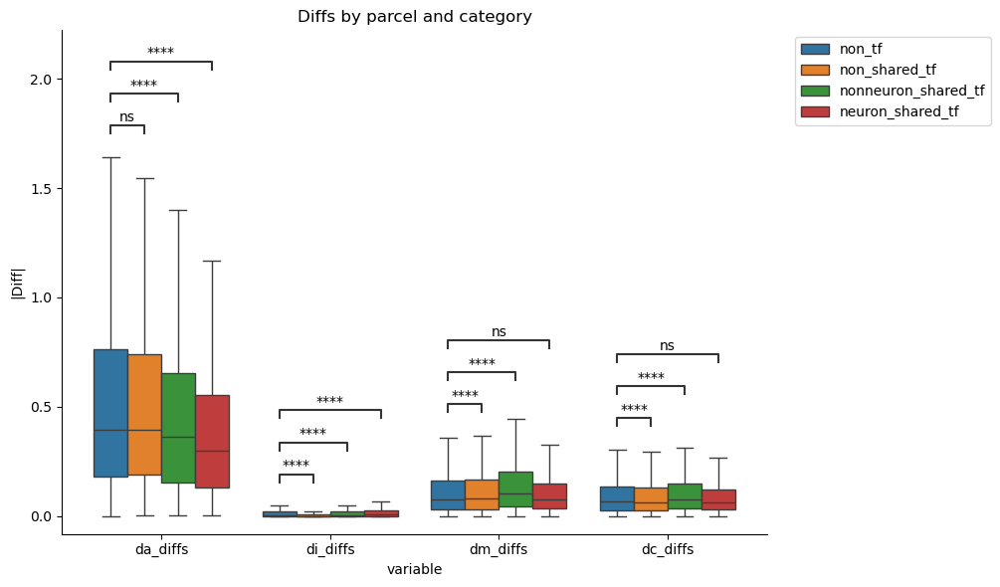

In [187]:
import pandas as pd
import numpy as np
import seaborn as seaborn
import matplotlib.pyplot as plt
from statannotations.Annotator import Annotator

xsd_final['category'] = np.where(
    xsd_final['neuron_shared_tf'], 'neuron_shared_tf',
    np.where(
        xsd_final['shared_tf'], 'nonneuron_shared_tf',
        np.where(
            xsd_final['tf'], 'non_shared_tf',
            'non_tf'
        )
    )
)

diffs = ['da_diffs','di_diffs','dm_diffs','dc_diffs']
order = diffs
hue_order = ['non_tf','non_shared_tf','nonneuron_shared_tf','neuron_shared_tf']

discrete_df = xsd_final.melt(
    id_vars=['category', discov_key],
    value_vars=diffs,
    var_name='variable', value_name='value'
)

fig, ax = plt.subplots(figsize=(8, 6))
seaborn.boxplot(
    data=discrete_df,
    x='variable', y='value', hue='category',
    order=order, hue_order=hue_order,
    showfliers=False, ax=ax
)
ax.set_title("Diffs by parcel and category")
ax.set_ylabel('|Diff|')
plt.tight_layout()

pairs = []
for diff in order:
    for grp in ['non_shared_tf','nonneuron_shared_tf','neuron_shared_tf']:
        pairs.append(((diff, grp), (diff, 'non_tf')))

annot = Annotator(
    ax, pairs,
    data=discrete_df, x='variable', y='value',
    hue='category', order=order, hue_order=hue_order
)
annot.configure(
    test='Mann-Whitney',
    text_format='star',
    loc='inside',
    comparisons_correction='bonferroni',
    verbose=2
)
annot.apply_test()
annot.annotate()

plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_boxplots_tf.svg'), format='svg')
plt.show()


In [188]:

# xsd_final['tf'] = xsd_final['index'].isin(tf_list.hgnc_symbol)
# discrete_col = 'tf'
# discrete_df=xsd_final.melt(id_vars=[discrete_col]+[discov_key],value_vars=['da_diffs','di_diffs','dm_diffs','dc_diffs'])#'de_diffs',
# diffs = ['da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']

# df = discrete_df.copy()
# df[discrete_col] = df[discrete_col].astype(str)

# # Define the order for the diff variables (x-axis) and the syntenic groups (hue)
# order = ['da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']
# hue_order = ["True", "False"]

# # Define pairs: for each diff variable, compare the "True" group to the "False" group.
# pairs = [((diff, "True"), (diff, "False")) for diff in order]

# # seaborn.boxplot(data=discrete_df,hue=discrete_col,x='variable',y='value',showfliers=False)
# # plt.show()

# # Create the boxplot with the specified order and hue_order.
# fig, ax = plt.subplots(figsize=(8, 6))
# seaborn.boxplot(data=df, x='variable', y='value', hue=discrete_col,
#             order=order, hue_order=hue_order, showfliers=False, ax=ax)
# plt.title("Diffs by parcel and "+discrete_col)
# plt.ylabel('|Diff|')
# plt.tight_layout()

# # Create the Annotator using the same parameters as in your working example.
# annot = Annotator(ax, pairs, data=df, x='variable', y='value', 
#                   hue=discrete_col, order=order, hue_order=hue_order)
# annot.configure(test='Mann-Whitney',text_format='star', loc='inside',#pvalue_format=[[1e-20, "****"], [1e-10, "***"], [1e-5, "**"], [1e-1, "*"], [1, "ns"]],
#                 comparisons_correction='bonferroni', verbose=2)
# annot.apply_test()
# annot.annotate()

# plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
# plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_boxplots_tf.svg'), format='svg')

# plt.show()

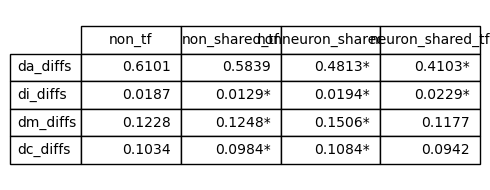

In [189]:
# discrete_df.groupby(['variable','category'])['value'].mean().unstack()

# import numpy as np
# import matplotlib.pyplot as plt

# tbl = discrete_df.groupby(['variable','category'])['value'] \
#                  .mean().unstack()
# tbl = tbl.loc[:,hue_order]
# fig, ax = plt.subplots(figsize=(5,2))
# ax.axis('off')
# # round the values to 3 decimals and feed into the table
# cell_text = np.round(tbl.values, 4)
# tbl_plot = ax.table(
#     cellText=cell_text,
#     rowLabels=tbl.index,
#     colLabels=tbl.columns,
#     loc='center'
# )
# tbl_plot.auto_set_font_size(False)
# tbl_plot.set_fontsize(10)
# tbl_plot.scale(1, 1.5)
# plt.tight_layout()
# plt.savefig(os.path.join(sc.settings.figdir,'tf_table.svg'), format='svg')
# plt.show()


tbl = (
    discrete_df
      .groupby(['variable','category'])['value']
      .mean()
      .unstack()
)
tbl = tbl.loc[:, hue_order]   # ensure column order

pvals = {}
# grab baseline once
base = discrete_df[discrete_df['category']=='non_tf']
for var in order:
    for cat in hue_order:
        b = base.loc[base['variable']==var, 'value']
        if cat == 'non_tf':
            continue
        a = discrete_df.loc[
            (discrete_df['variable']==var) &
            (discrete_df['category'] == cat),
            'value'
        ]
        a,b = a[~np.isnan(a.to_numpy())],b[~np.isnan(b.to_numpy())]
        _, p = mannwhitneyu(a, b, alternative='two-sided')
        pvals[(var,cat)] = p

cell_text = []
for var in order:
    row = []
    for cat in hue_order:
        m = tbl.loc[var, cat]
        star = '*' if (cat!='non_tf' and pvals[(var,cat)] < 1e-4) else ''
        row.append(f"{m:.4f}{star}")
    cell_text.append(row)

fig, ax = plt.subplots(figsize=(5,2))
ax.axis('off')
tbl_plot = ax.table(
    cellText=cell_text,
    rowLabels=order,
    colLabels=tbl.columns,
    loc='center'
)
tbl_plot.auto_set_font_size(False)
tbl_plot.set_fontsize(10)
tbl_plot.scale(1, 1.5)
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'tf_table_with_stars.svg'),
            format='svg')
plt.show()


In [190]:
tbl.columns

Index(['non_tf', 'non_shared_tf', 'nonneuron_shared_tf', 'neuron_shared_tf'], dtype='object', name='category')

In [191]:
# xsd_final = xsd_final.loc[(xsd_final['q_gene_size']>3),:]

In [192]:
rand_plot=np.random.choice(list(range(xsd_final.shape[0])),200000,replace=False)
xsd_final=xsd_final.reset_index()

gene_size


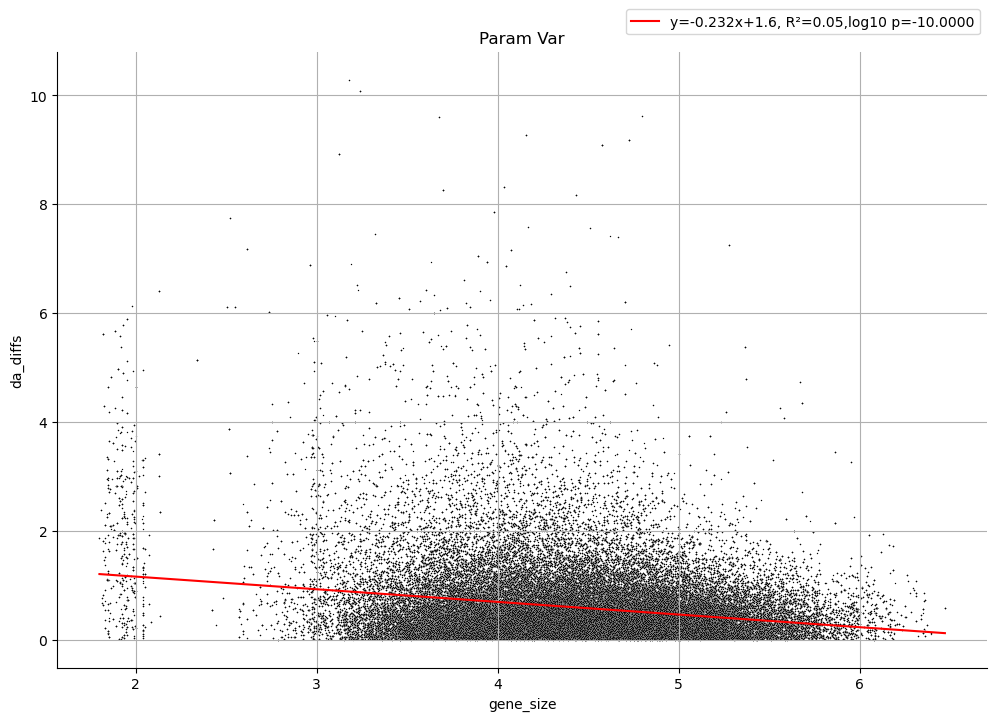

intergenic


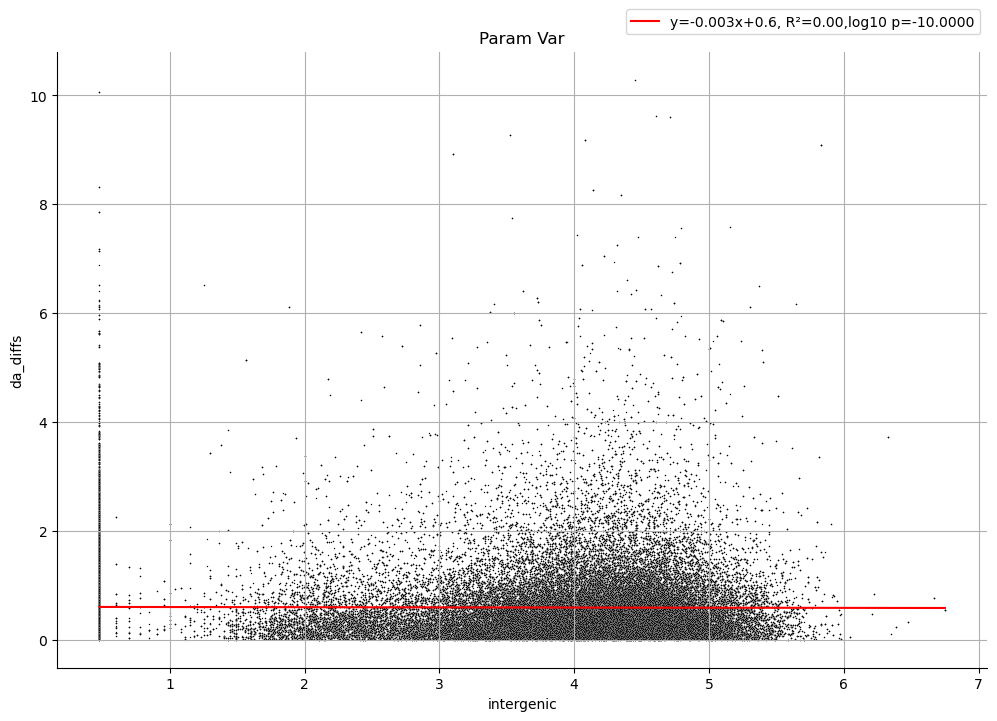

gene_size


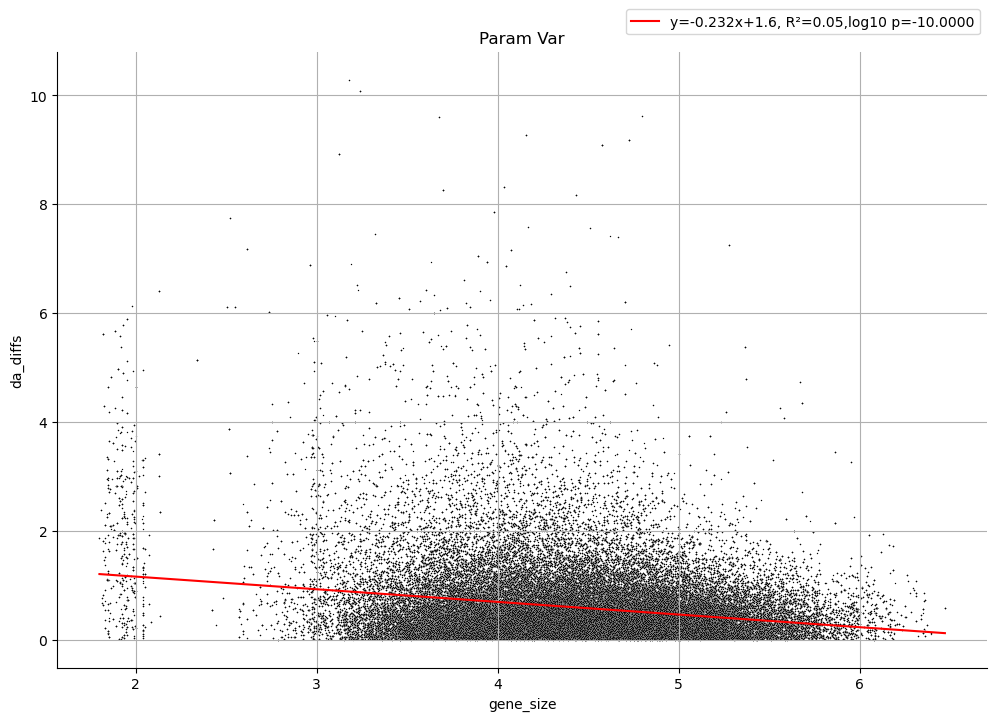

neighborhood_jaccard_human_macaque


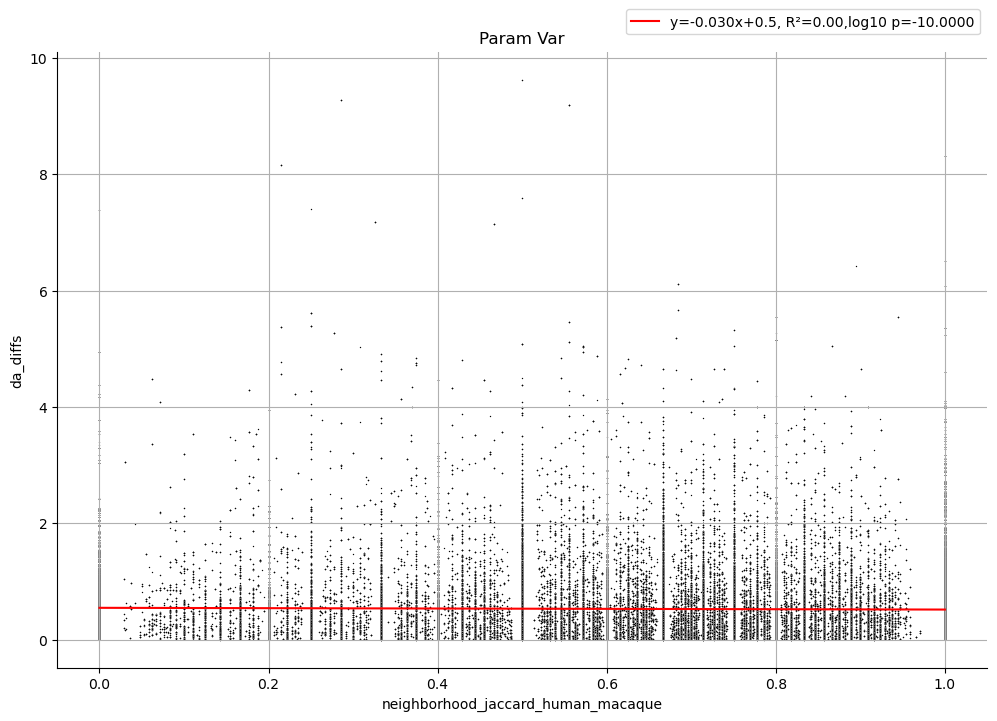

neighborhood_jaccard_macaque_mouse


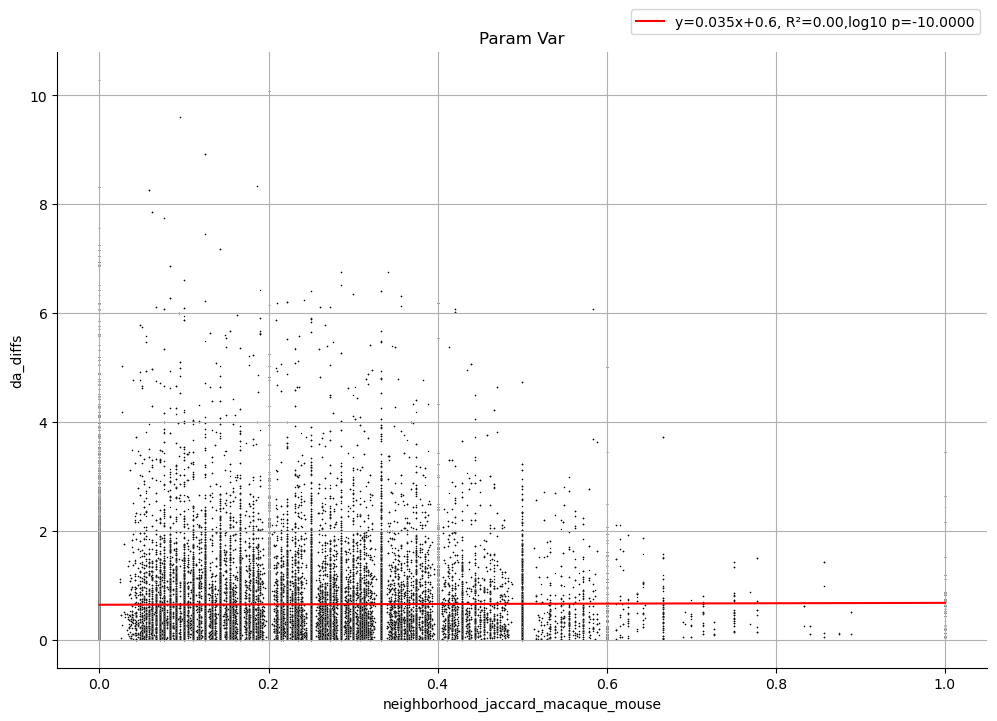

neighborhood_jaccard_mouse_human


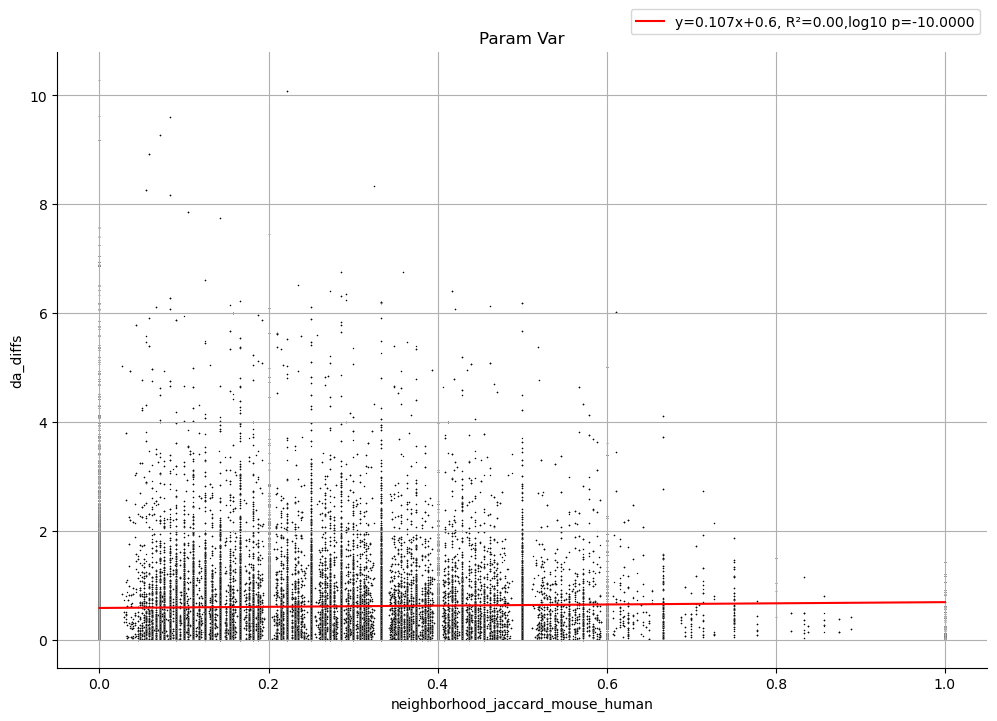

gene_size


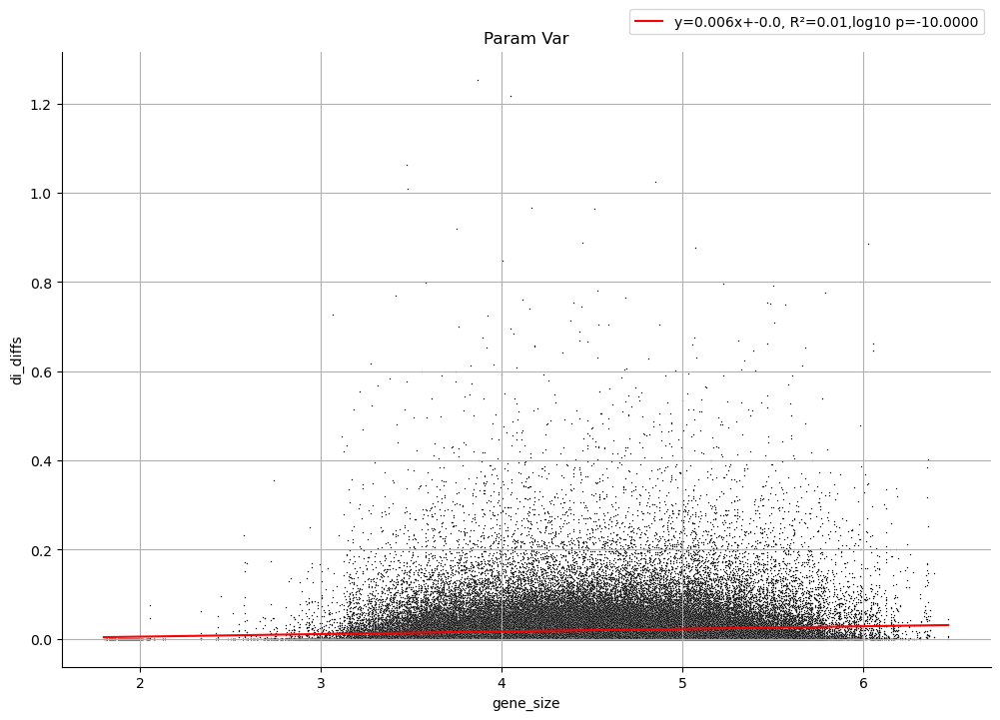

intergenic


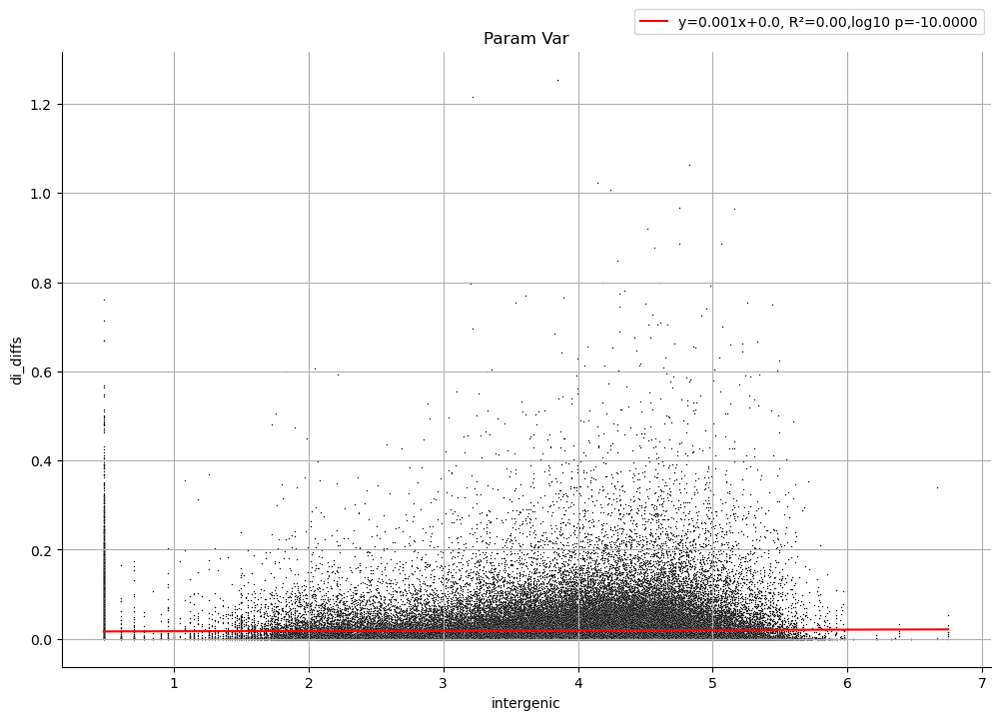

gene_size


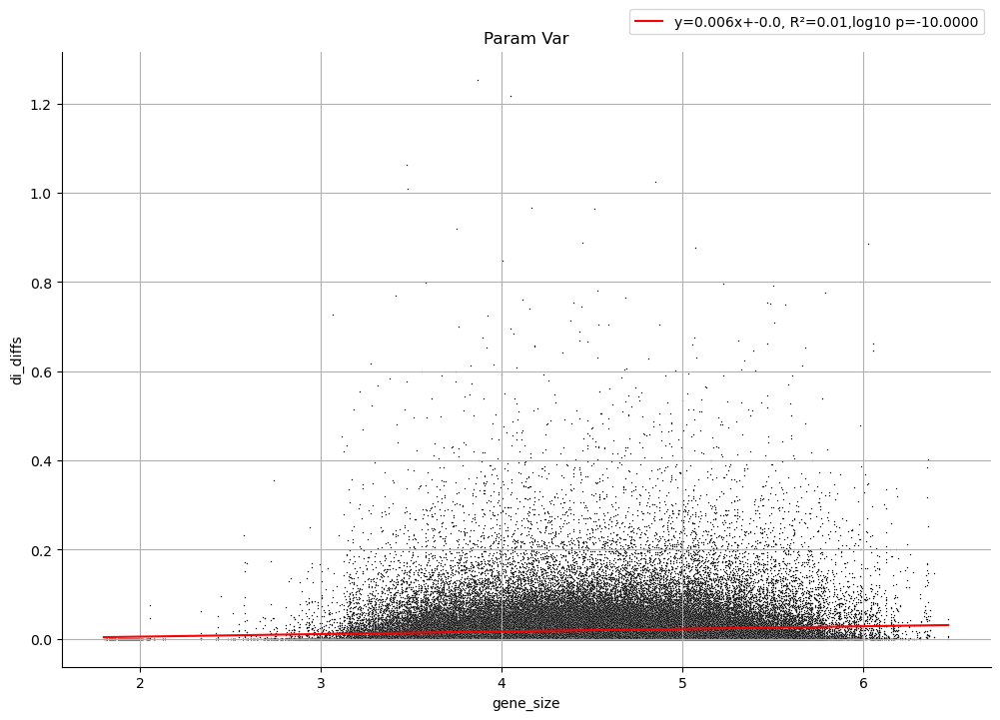

neighborhood_jaccard_human_macaque


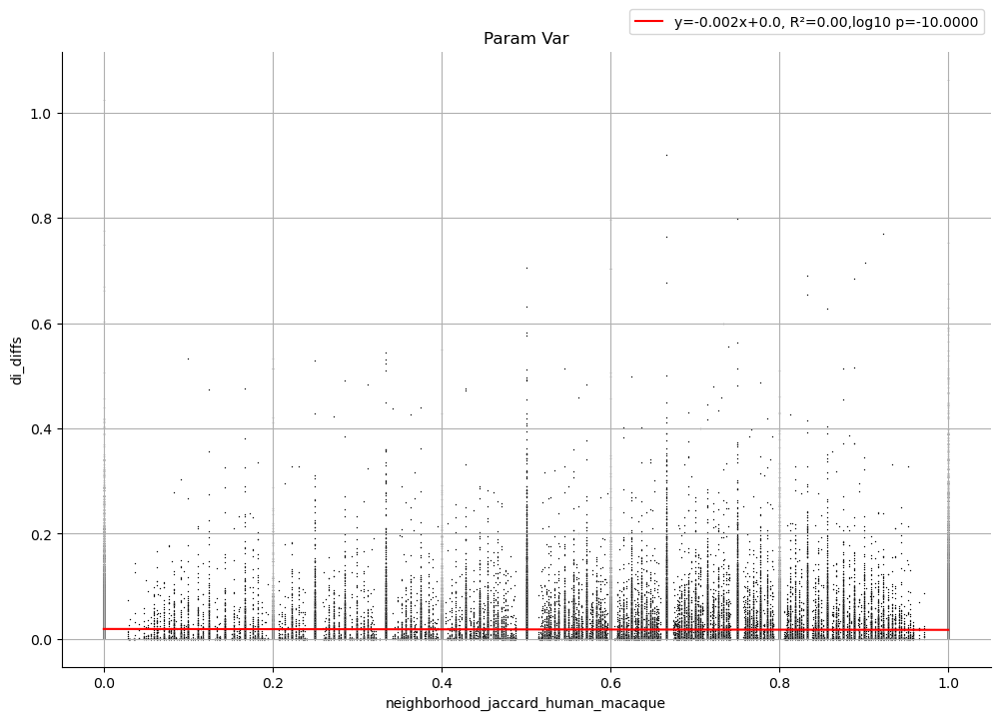

neighborhood_jaccard_macaque_mouse


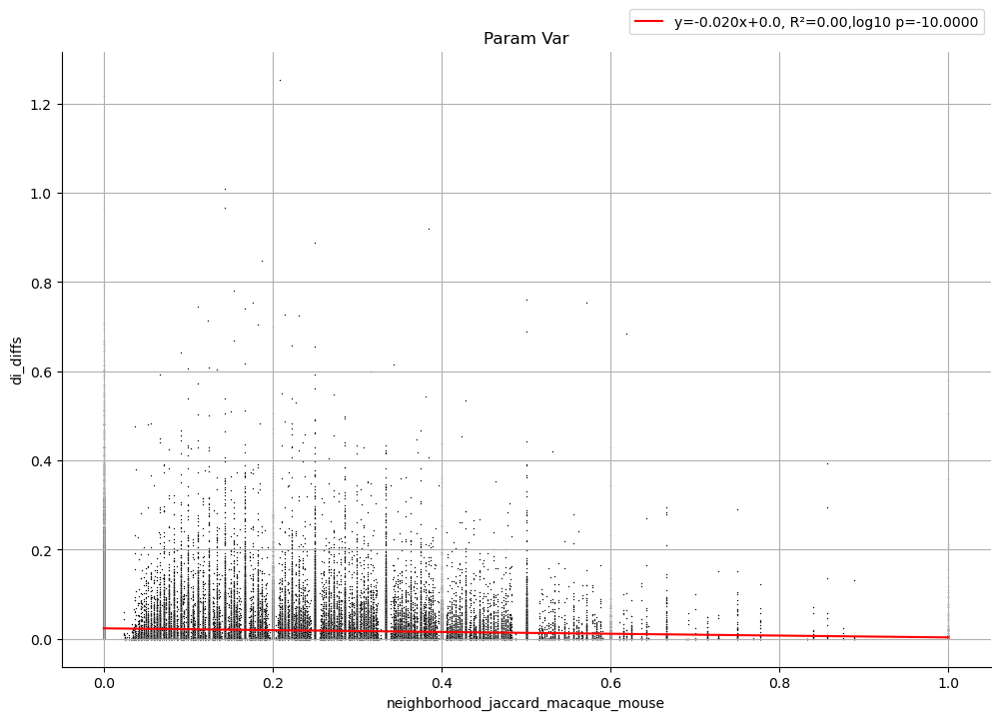

neighborhood_jaccard_mouse_human


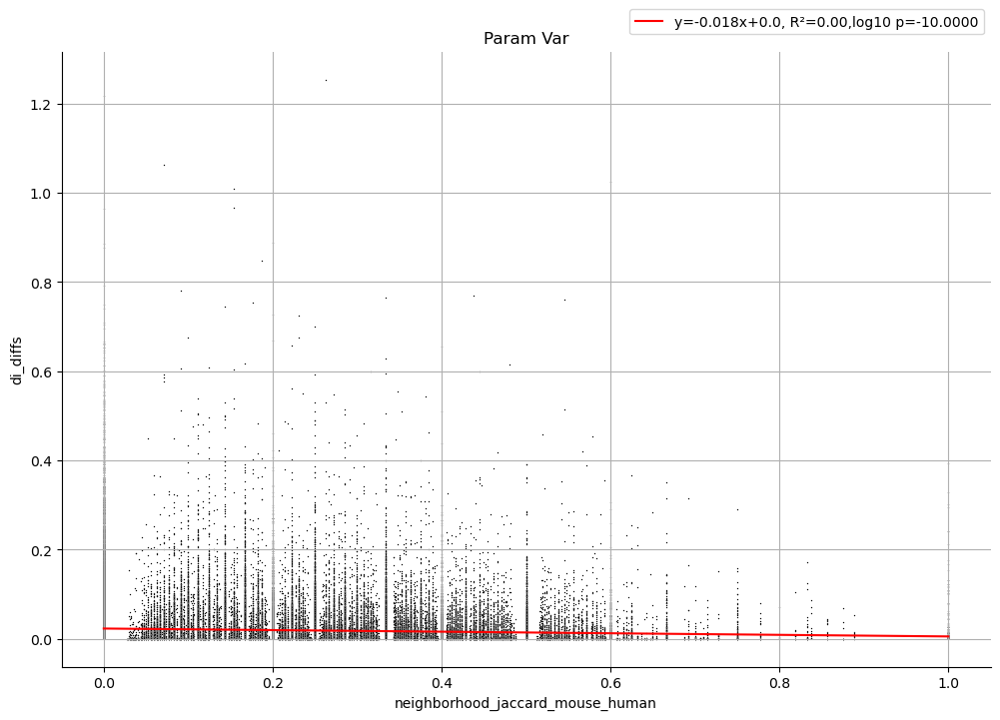

gene_size


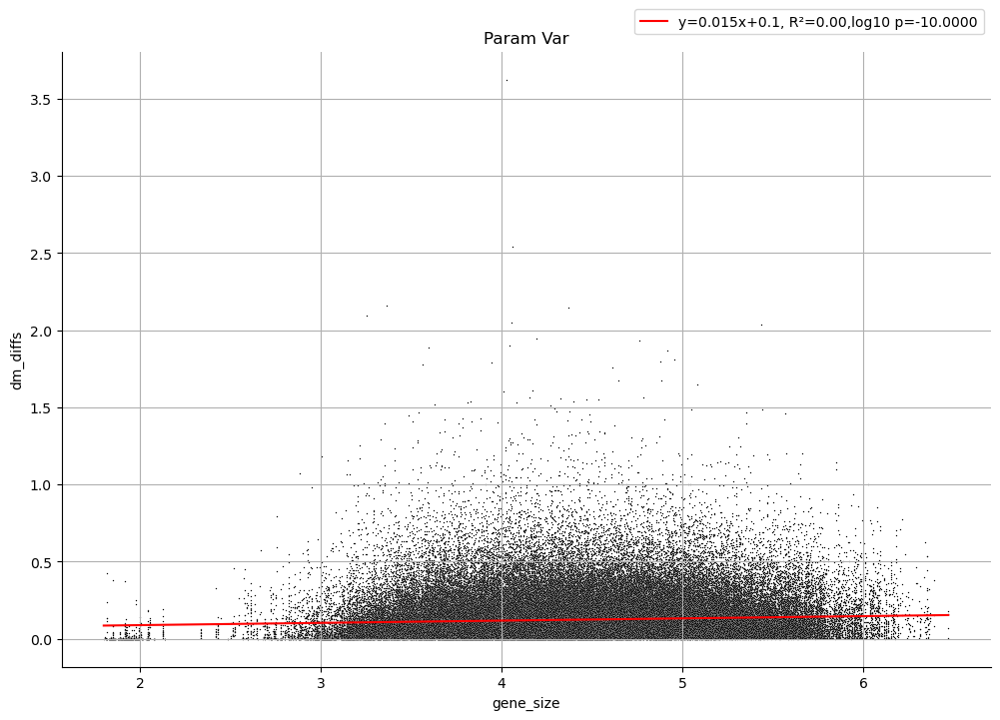

intergenic


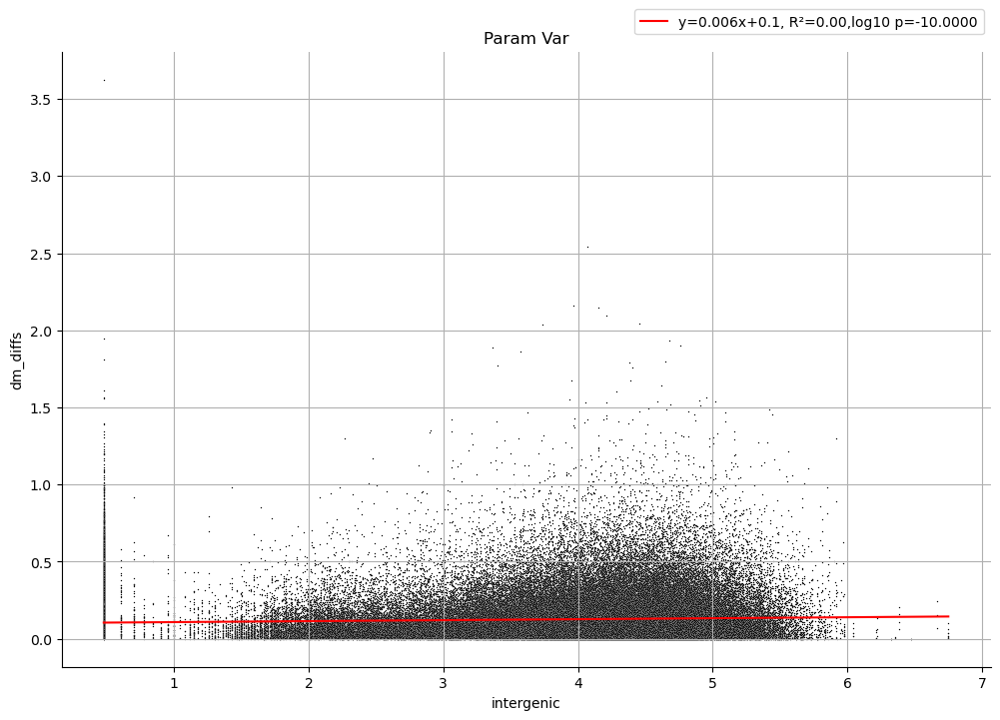

gene_size


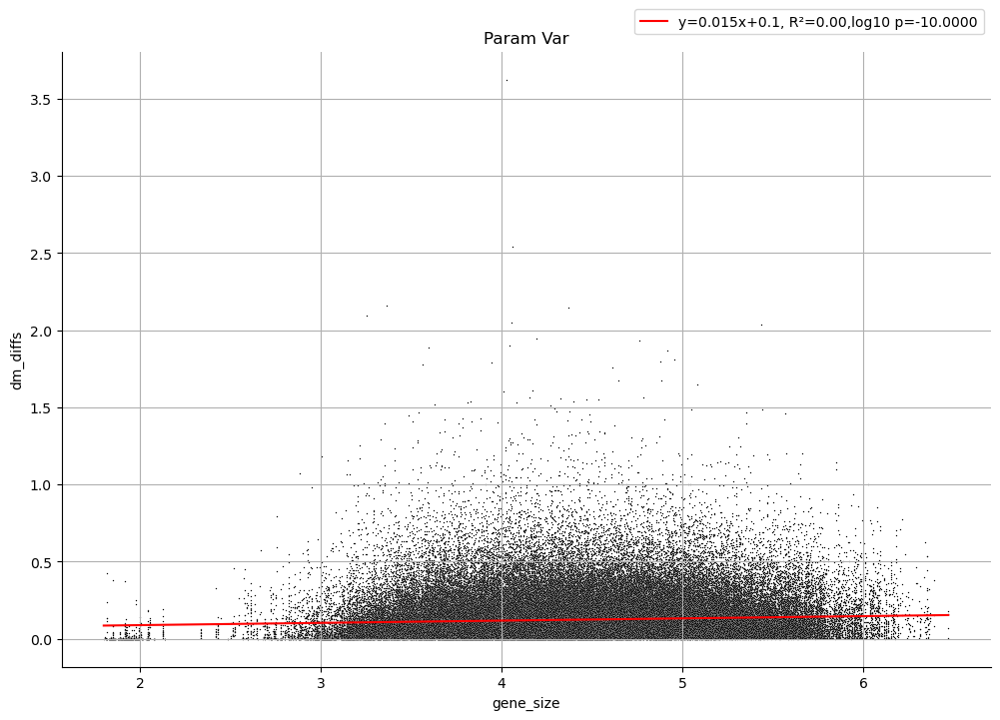

neighborhood_jaccard_human_macaque


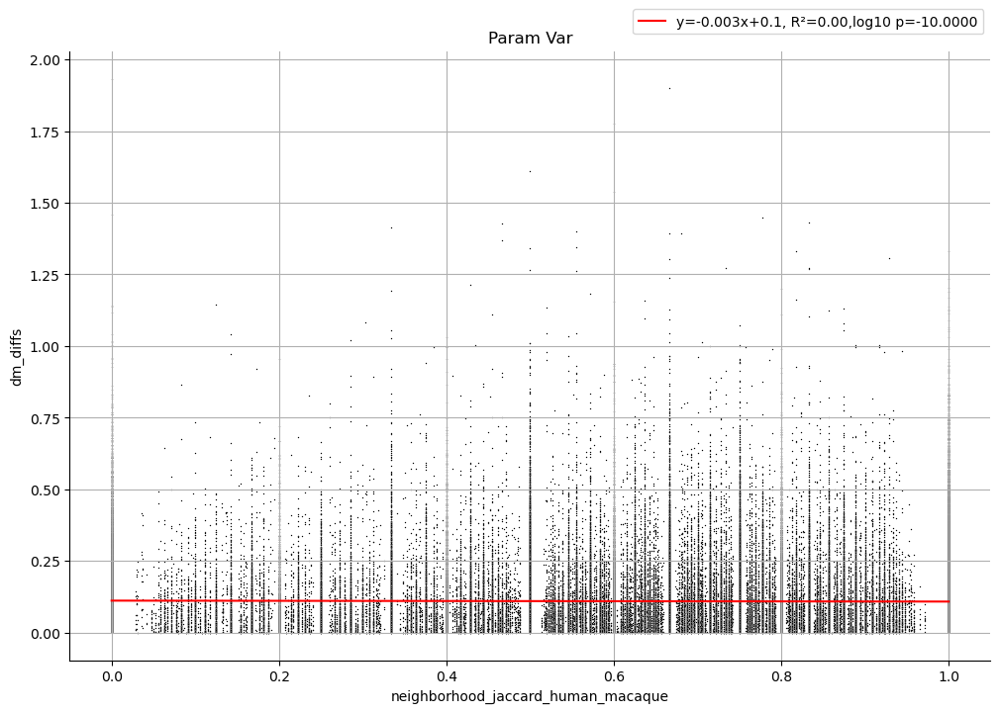

neighborhood_jaccard_macaque_mouse


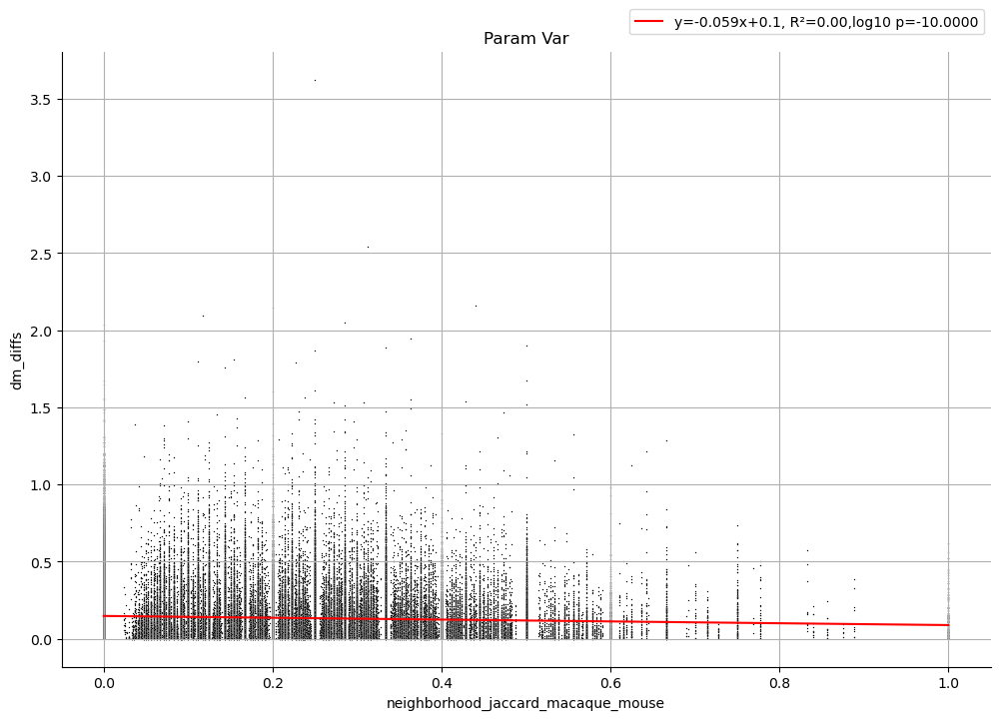

neighborhood_jaccard_mouse_human


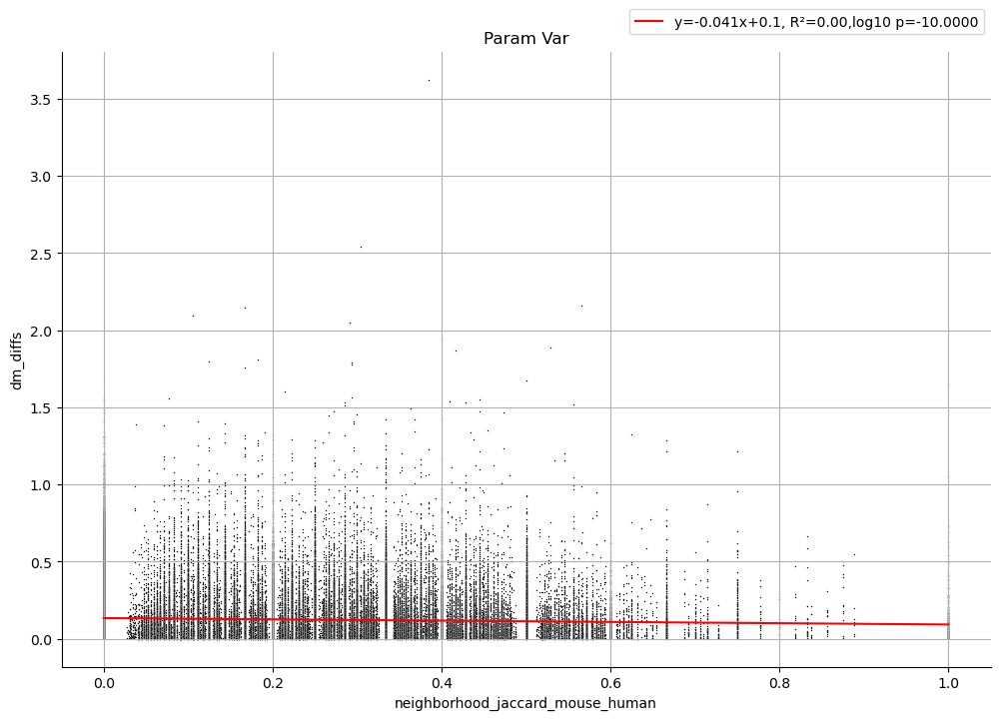

gene_size


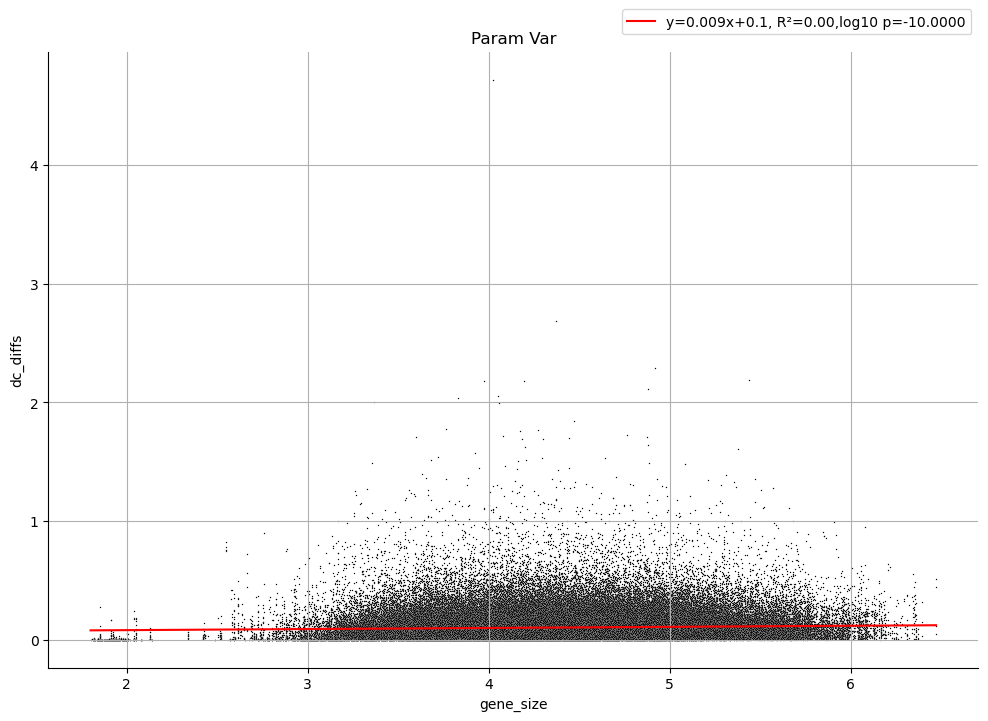

intergenic


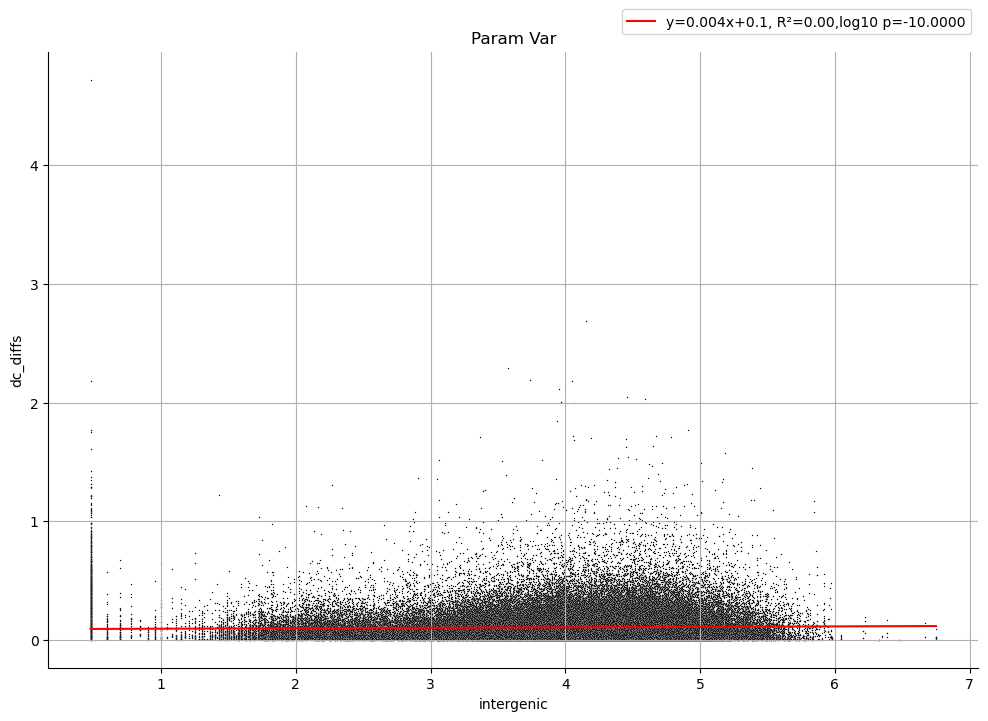

gene_size


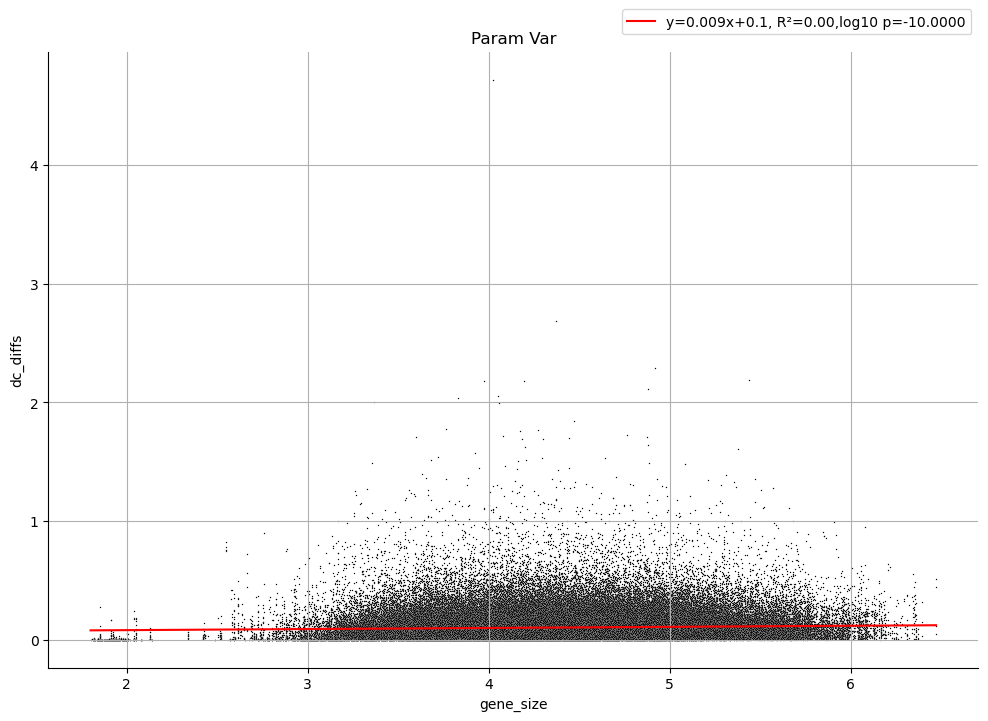

neighborhood_jaccard_human_macaque


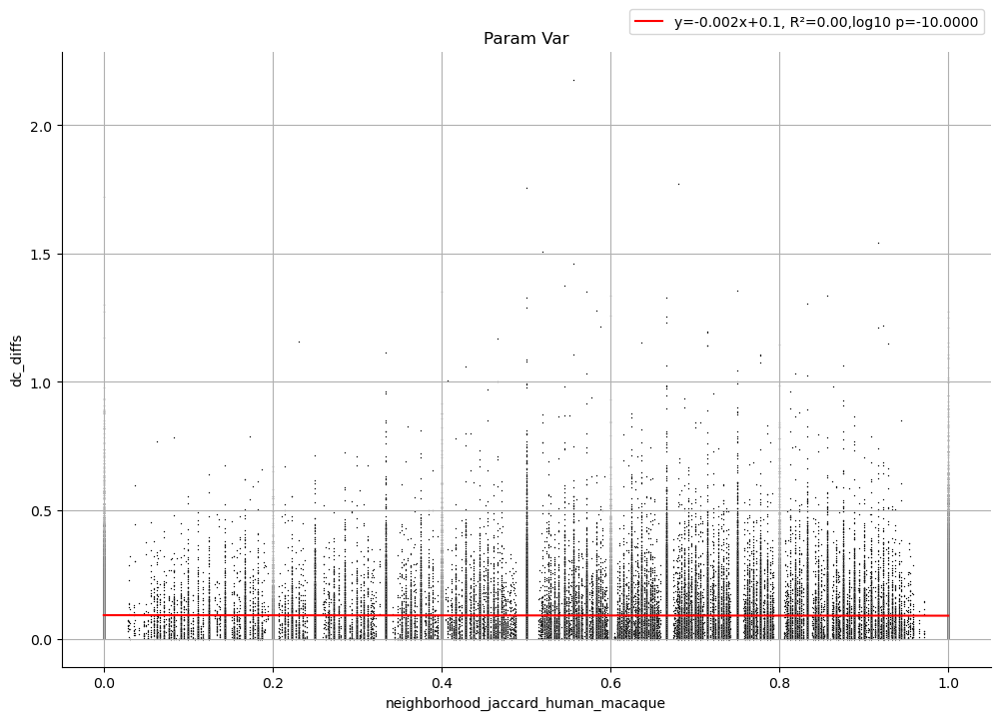

neighborhood_jaccard_macaque_mouse


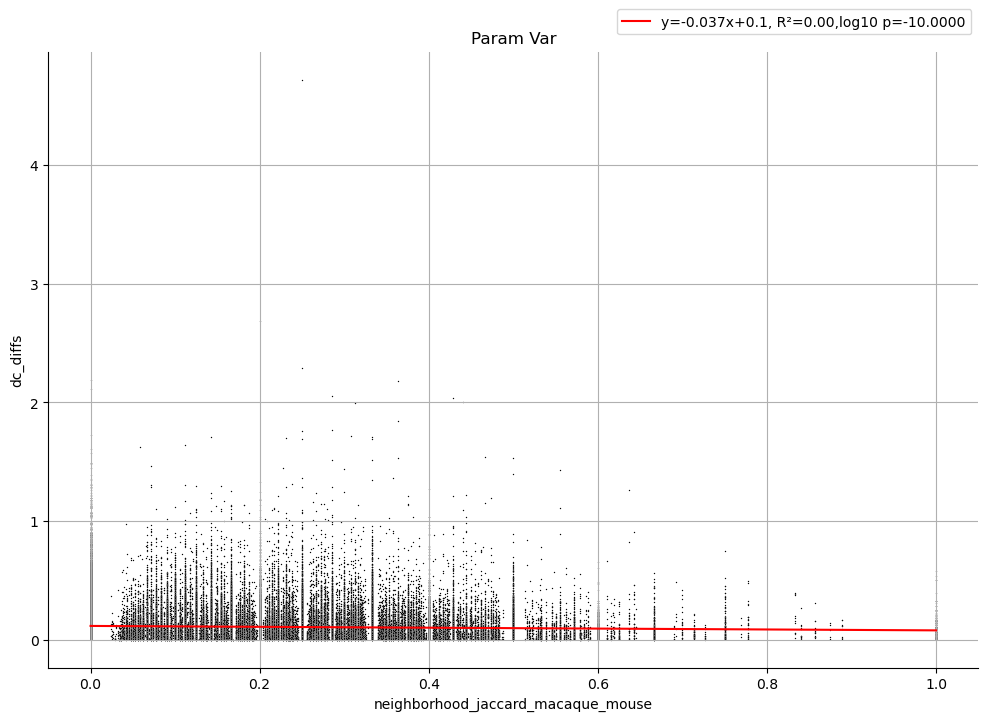

neighborhood_jaccard_mouse_human


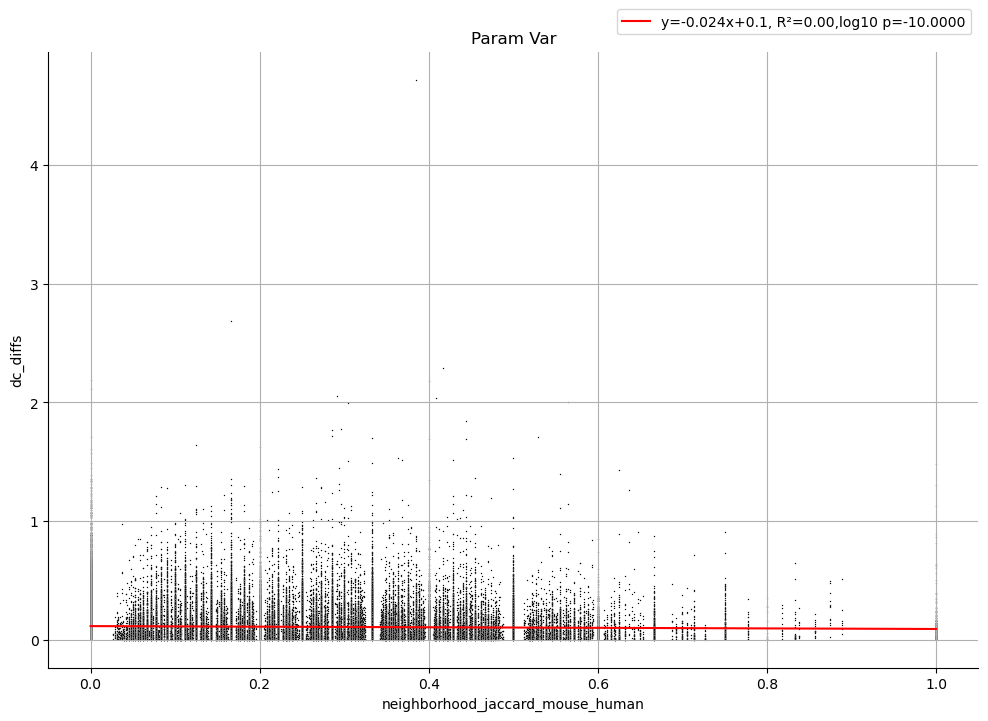

In [193]:
continuous_covs=['gene_size', 'intergenic', 'gene_size','neighborhood_jaccard_human_macaque', 'neighborhood_jaccard_macaque_mouse', 'neighborhood_jaccard_mouse_human']
regression_coefs = []
for d in diffs:
    for c in continuous_covs:
        print(c)
        plt.figure(figsize=(12, 8))          
        
        seaborn.scatterplot(
            data=xsd_final.iloc[rand_plot,:],
            x=c,
            y=d,
            s=1,  # Adjust marker size for better visibility
            c='black'
        )
        # seaborn.kdeplot(data=xsd_final.iloc[rand_plot,:],x=c,y=d,linestyles='--', color='blue', linewidths=0.5)

        plt.xlabel(c)
        plt.ylabel(d)
    
        # Calculate the regression parameters
        inspec=~xsd_final[c].isna()
        x=xsd_final.loc[inspec,c]
        y=xsd_final.loc[inspec,d]
        mask = np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y)
        x, y = x[~mask], y[~mask]

        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x,y)
        
        # Plot the regression line
        x_values = np.linspace(np.min(xsd_final.loc[inspec,c]), np.max(xsd_final.loc[inspec,c]), 100)
        plt.plot(x_values, slope * x_values + intercept, color='red', label=f'y={slope:.3f}x+{intercept:.1f}, R²={r_value**2:.2f},log10 p={np.log10(p_value+1e-10):.4f}')
        
        regression_coefs.append([c,d,slope,intercept,np.log10(p_value+1e-10)])
        
        # Adjust legend to avoid overlap
        plt.legend(loc='upper right', bbox_to_anchor=(1.0, 1.08))
        
        # Show the plot
        plt.grid(True)
        plt.title('Param Var')
        plt.savefig(os.path.join(sc.settings.figdir, 'coef_slope_scatter_'+d+'_'+c+'.png'), format='png')
        plt.show()


<Axes: xlabel='syntenic', ylabel='gene_size'>

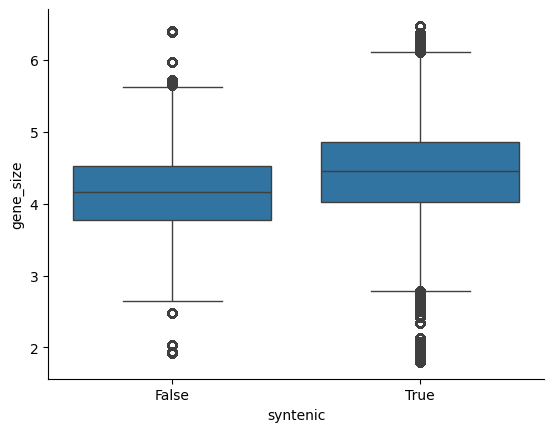

In [194]:
seaborn.boxplot(x='syntenic',y='gene_size', data=xsd_final)

gene_size


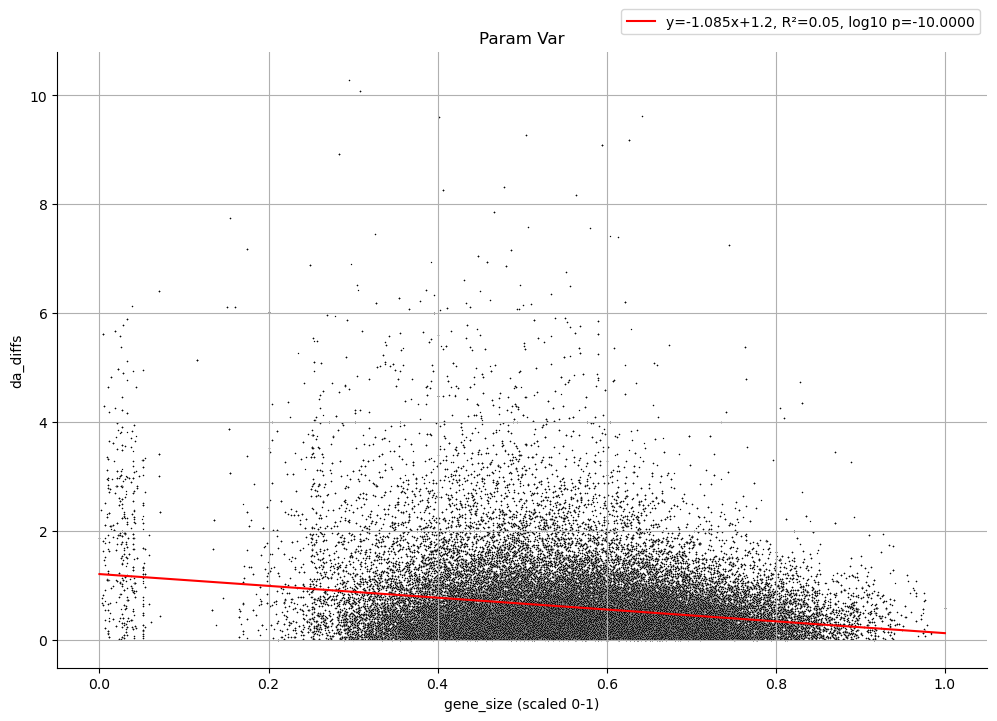

intergenic


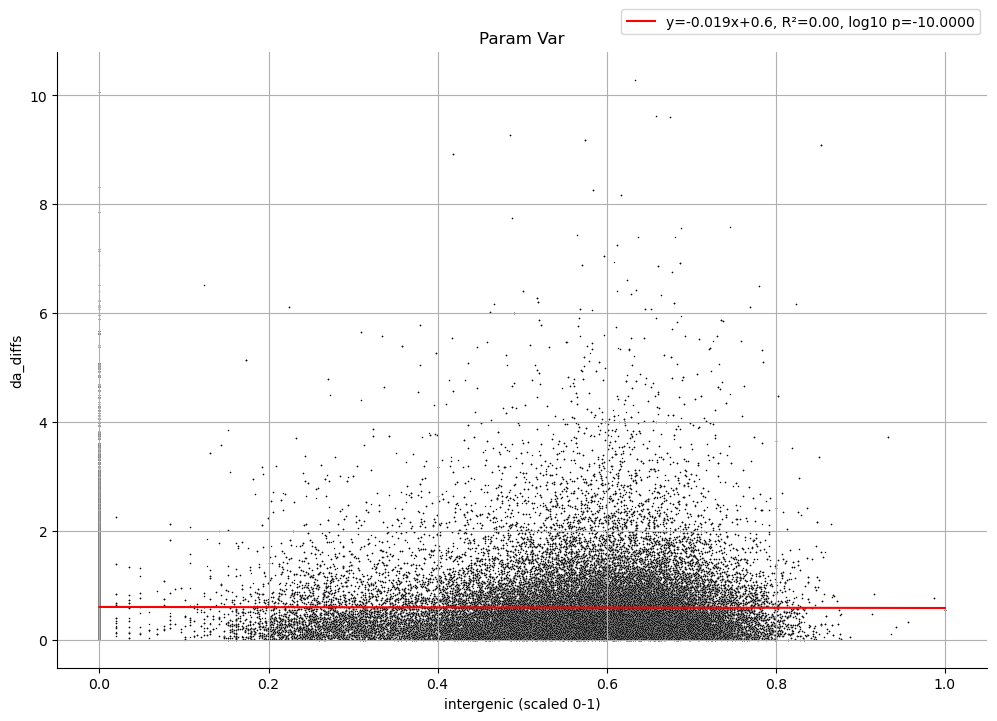

neighborhood_jaccard_human_macaque


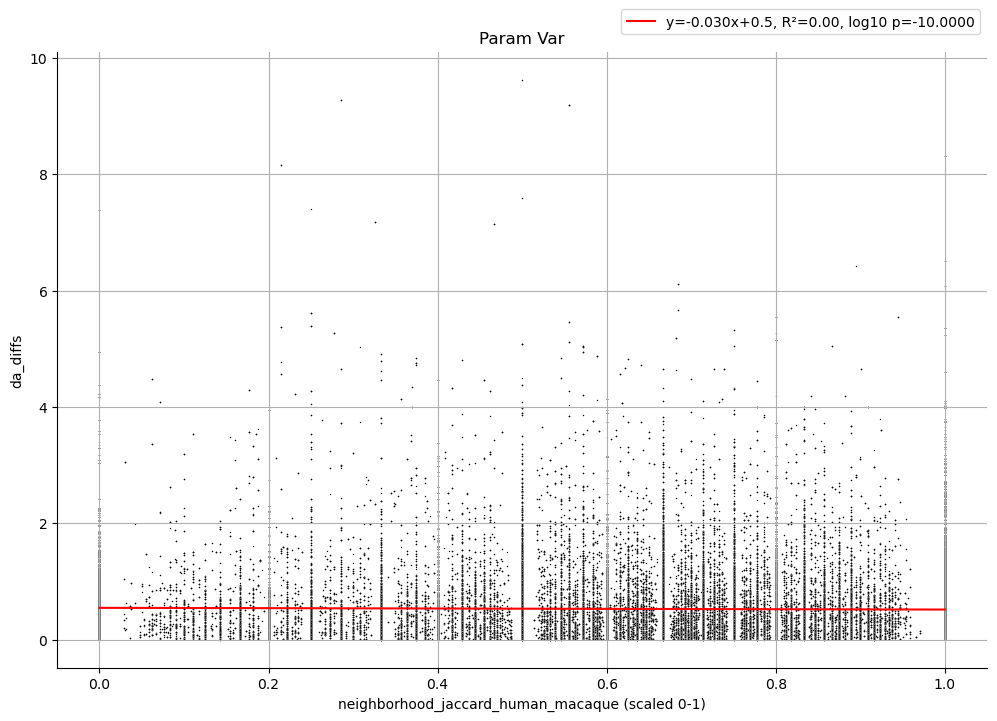

neighborhood_jaccard_macaque_mouse


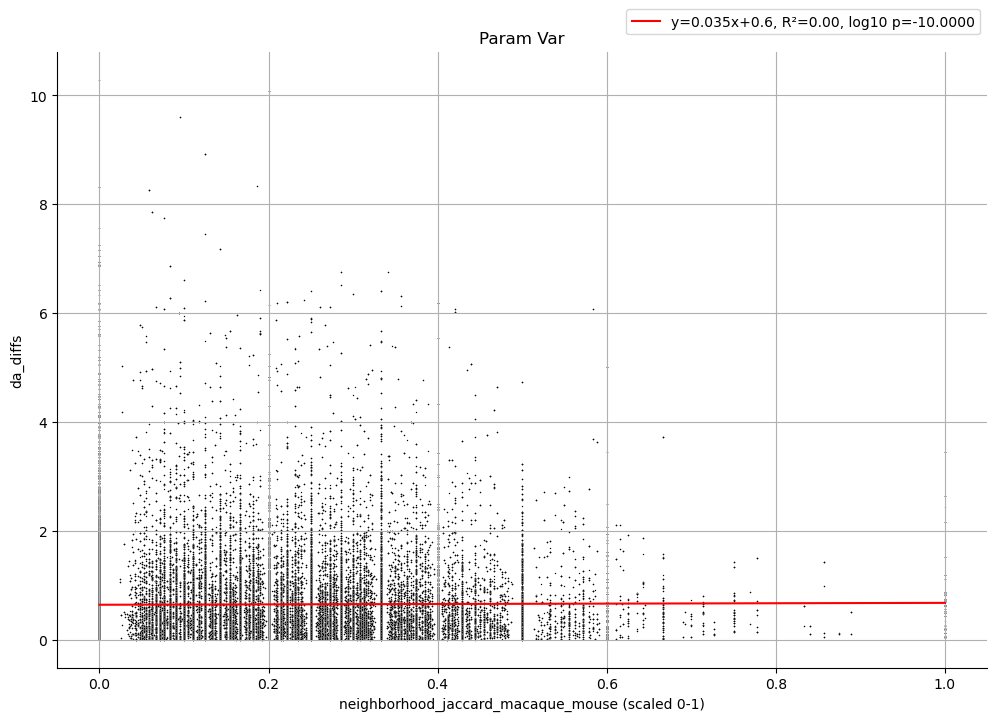

neighborhood_jaccard_mouse_human


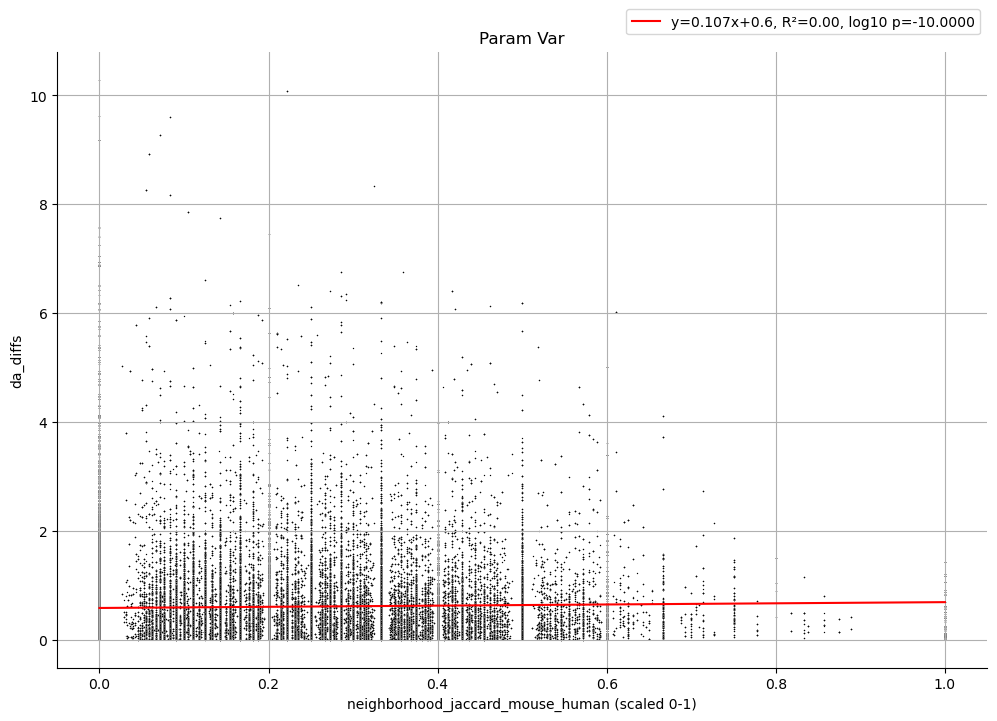

gene_size


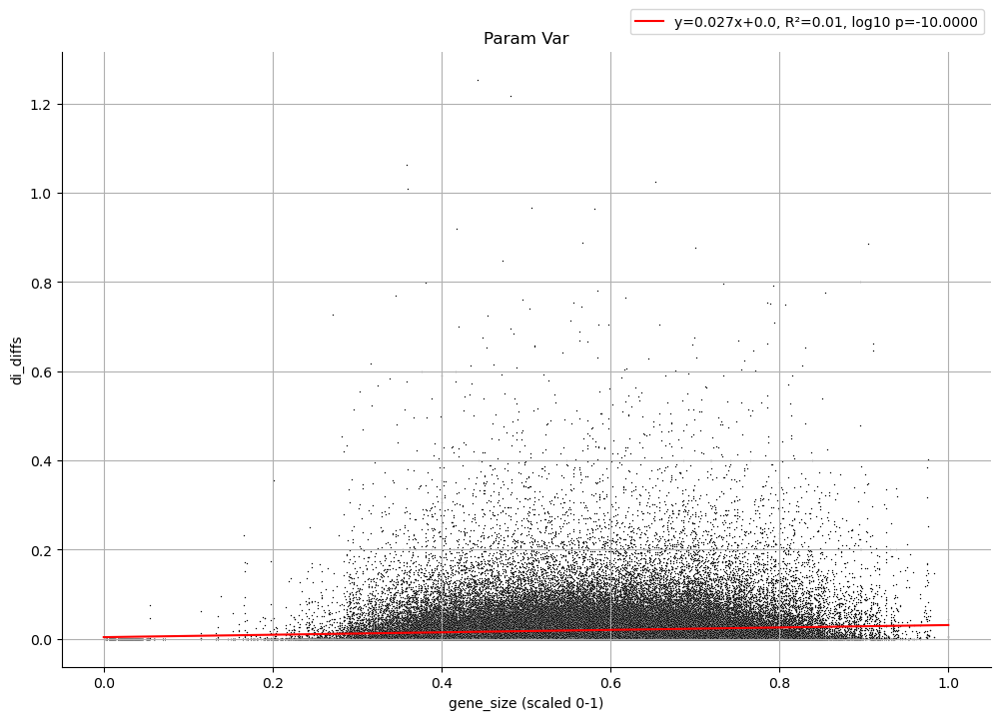

intergenic


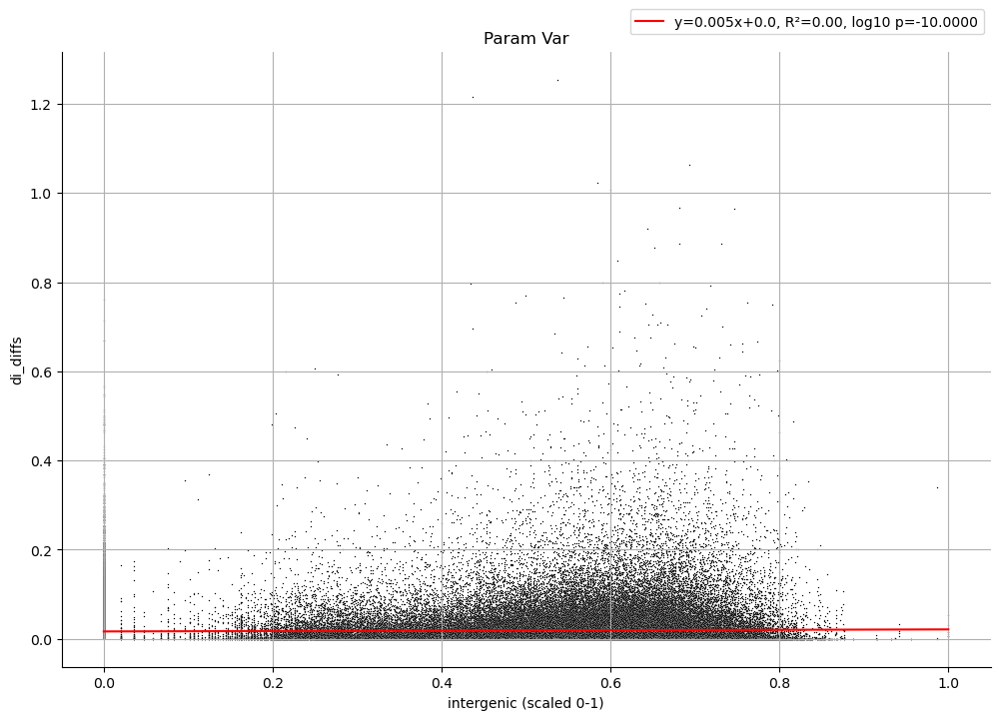

neighborhood_jaccard_human_macaque


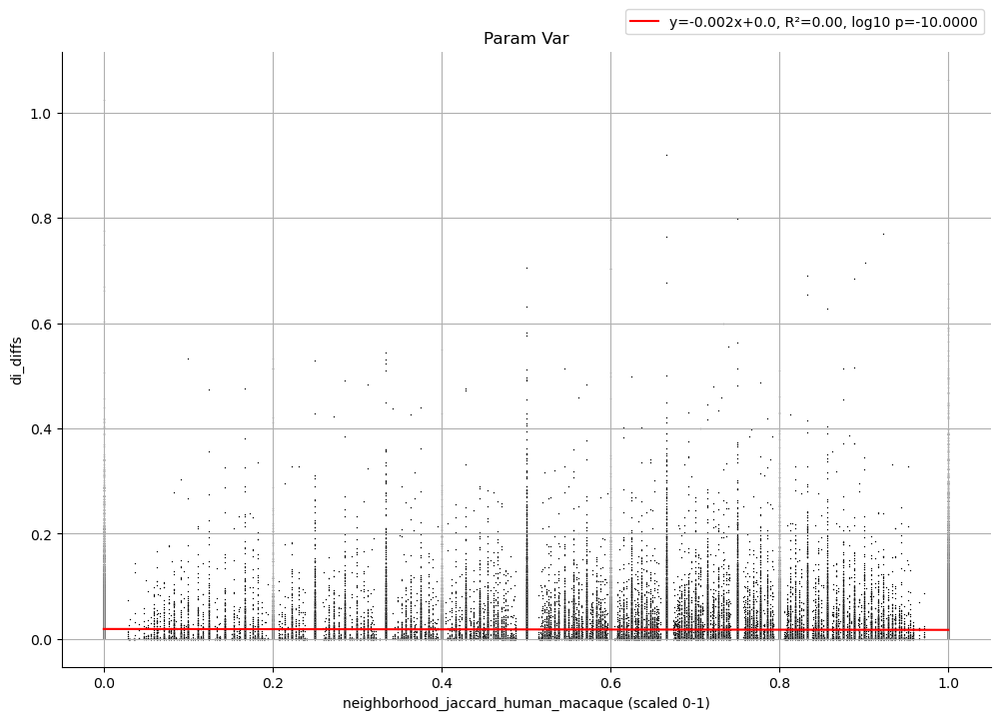

neighborhood_jaccard_macaque_mouse


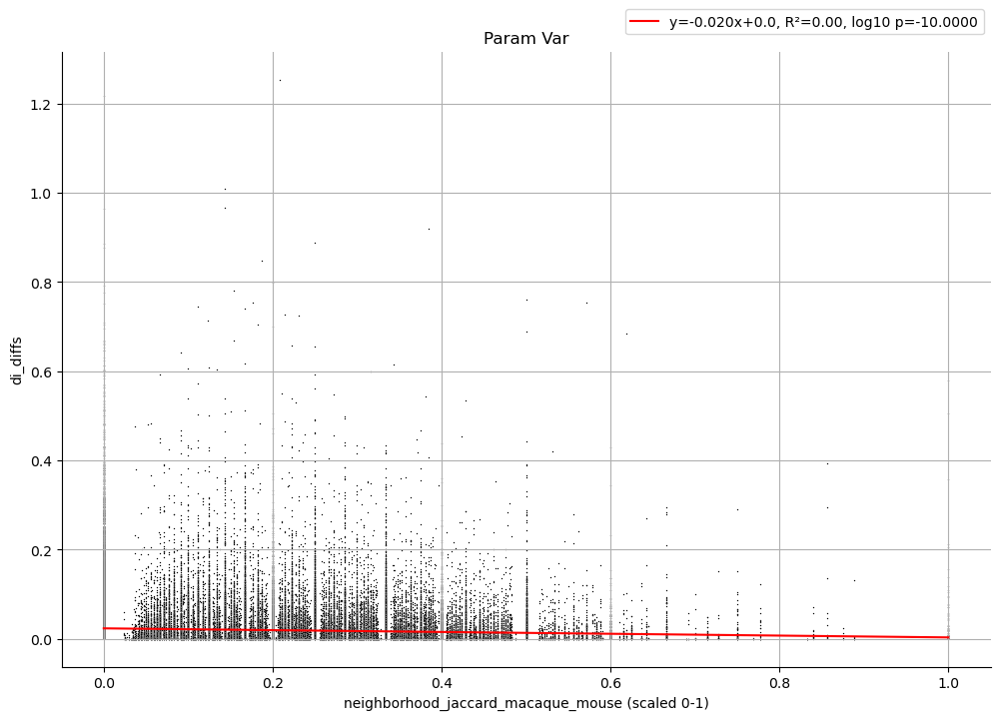

neighborhood_jaccard_mouse_human


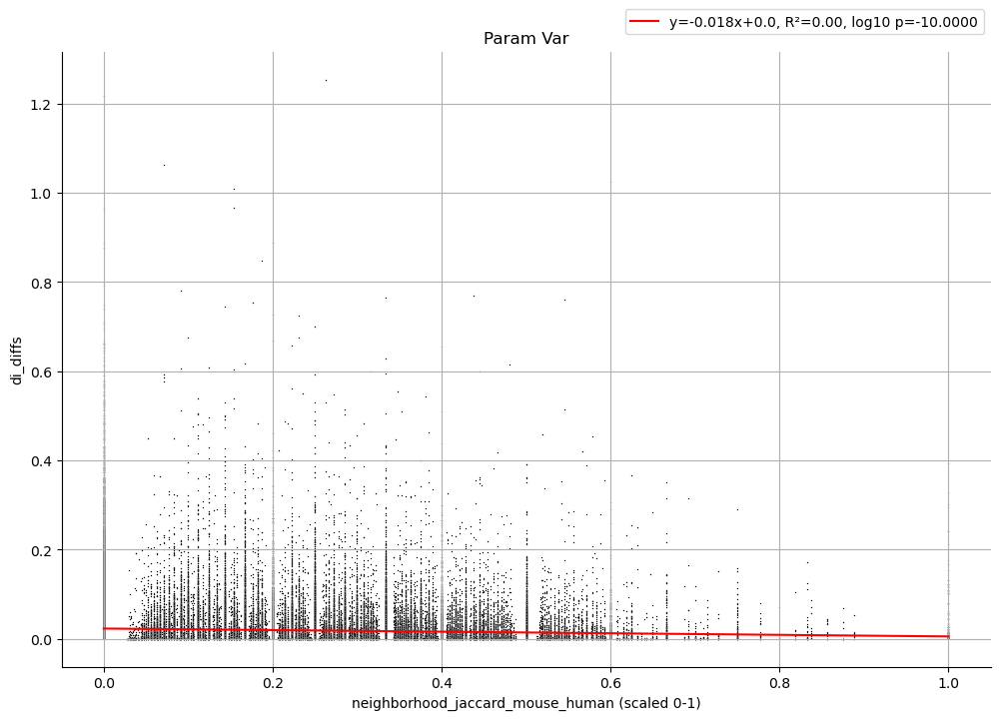

gene_size


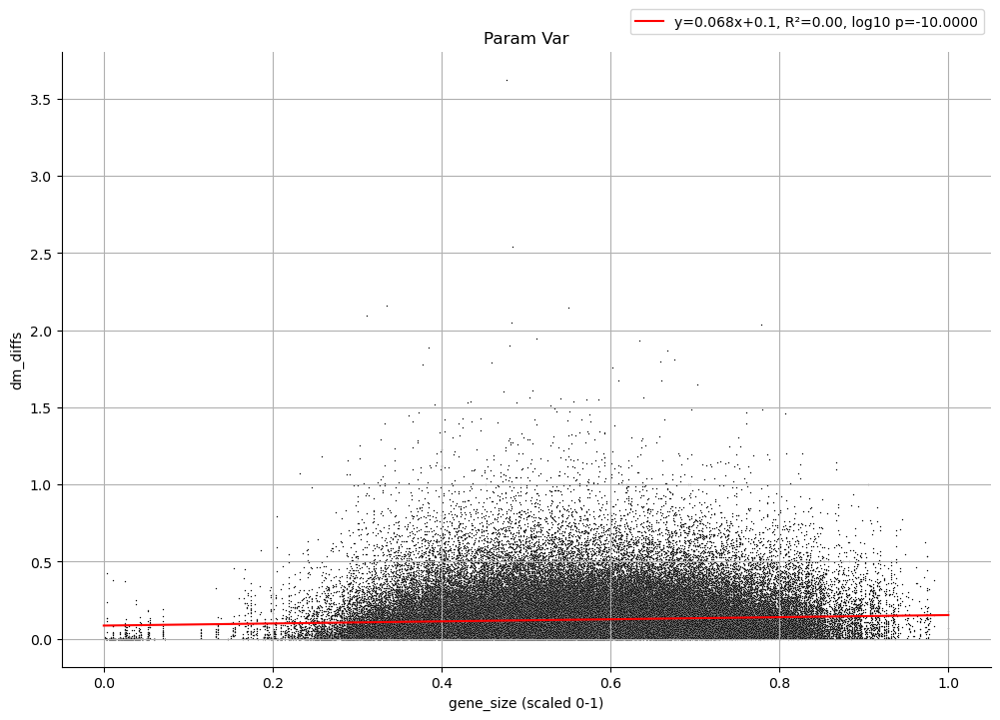

intergenic


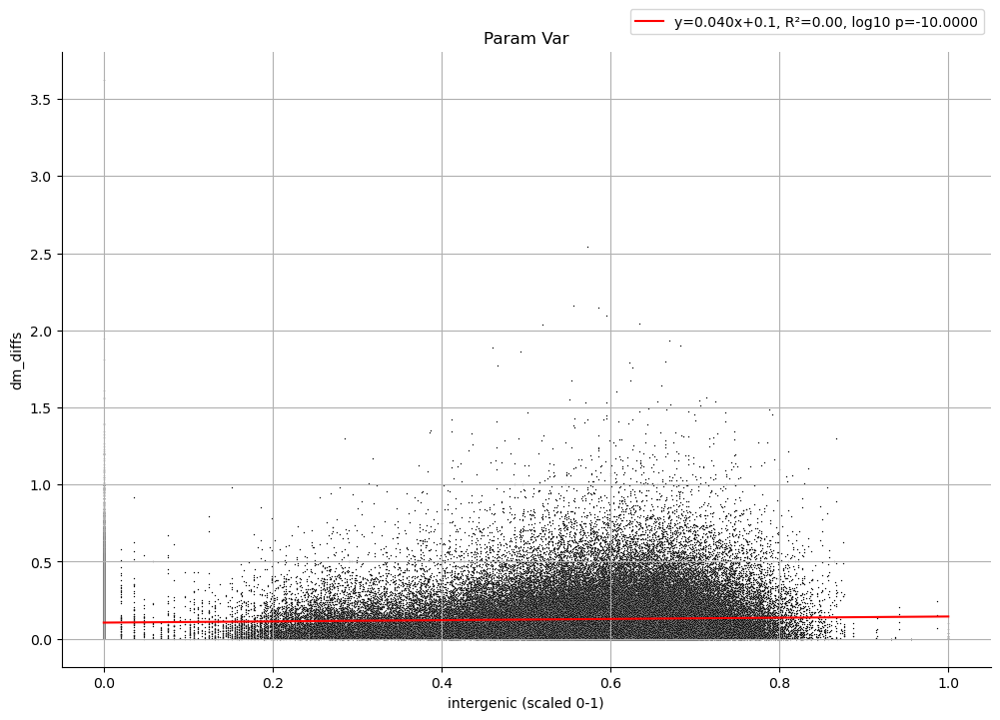

neighborhood_jaccard_human_macaque


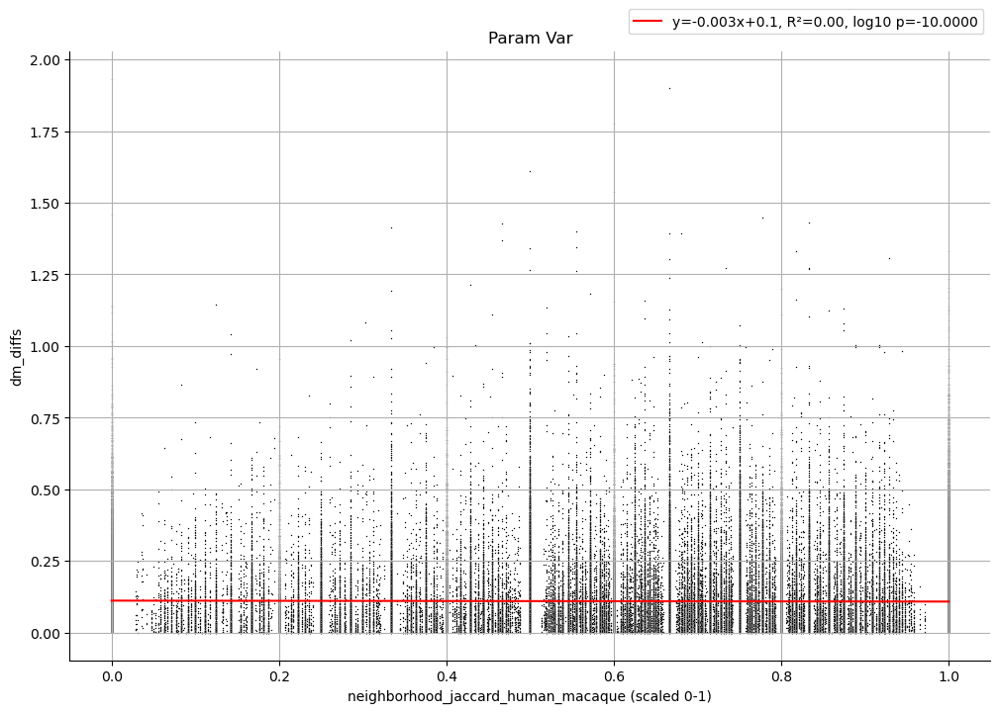

neighborhood_jaccard_macaque_mouse


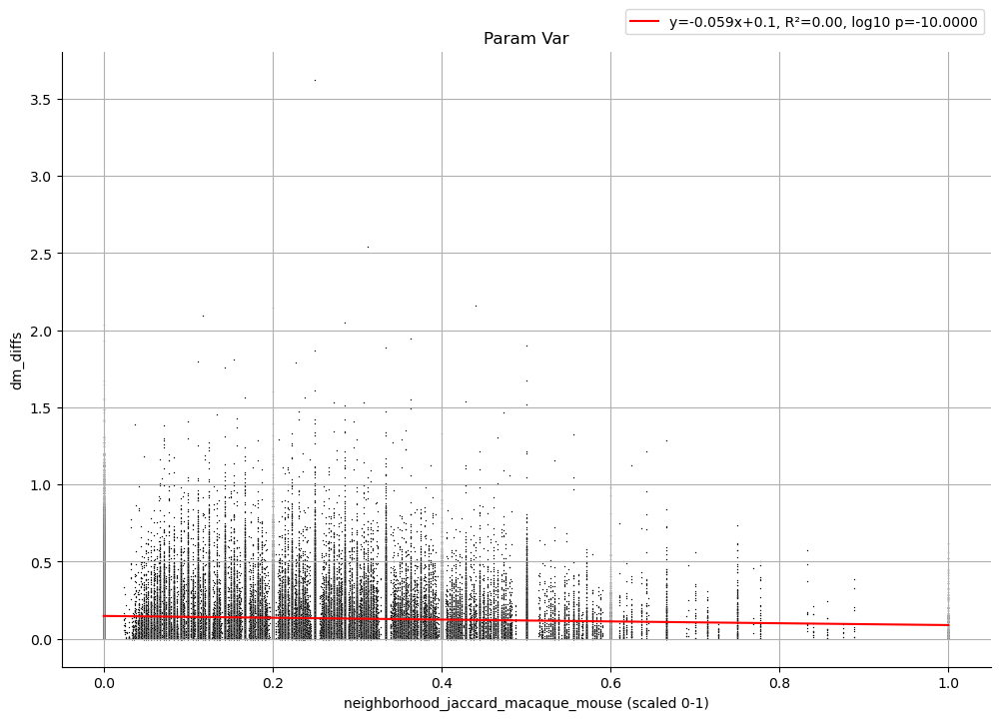

neighborhood_jaccard_mouse_human


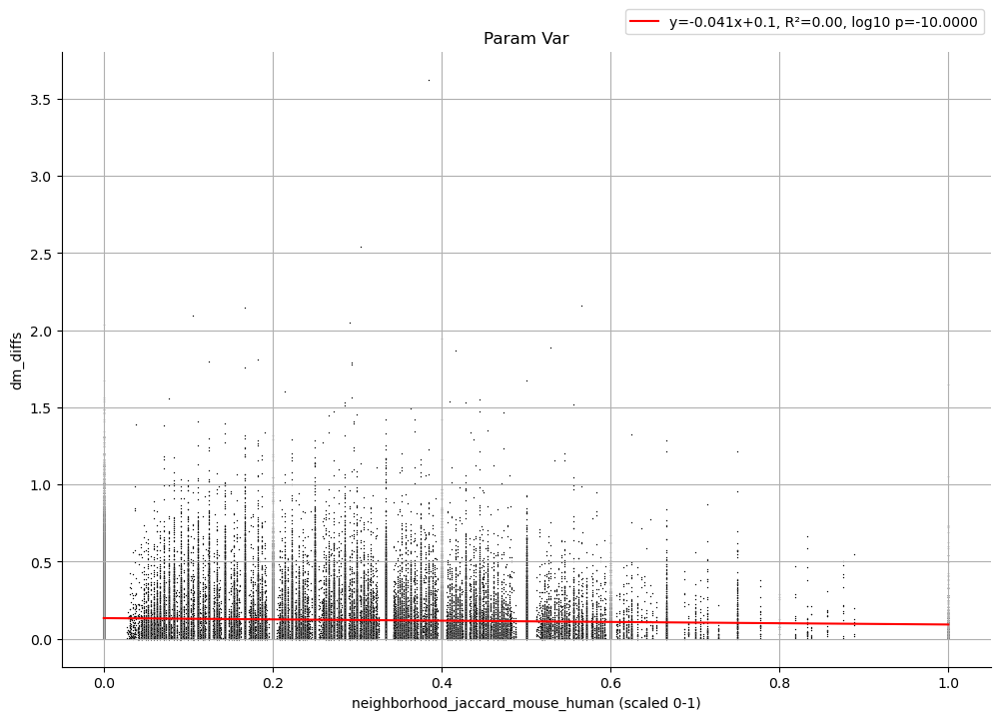

gene_size


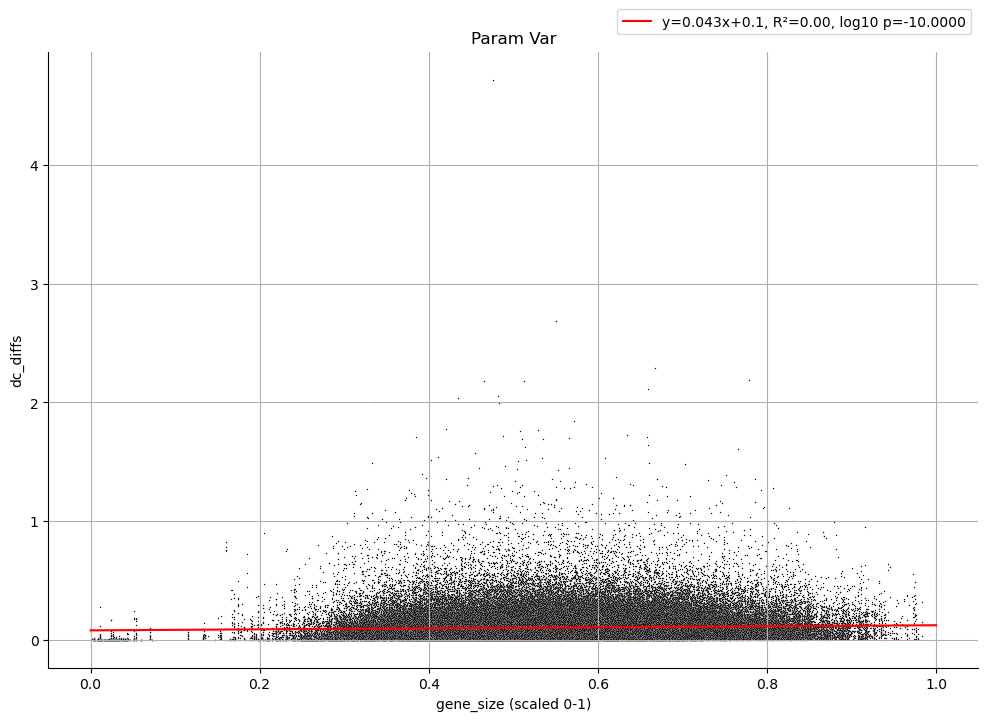

intergenic


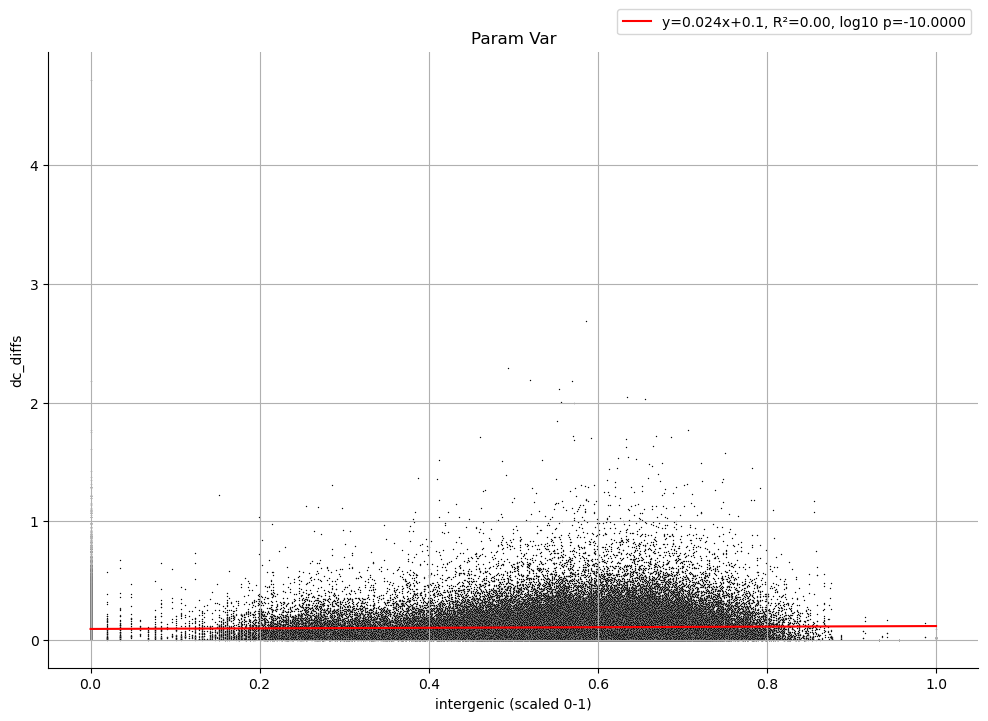

neighborhood_jaccard_human_macaque


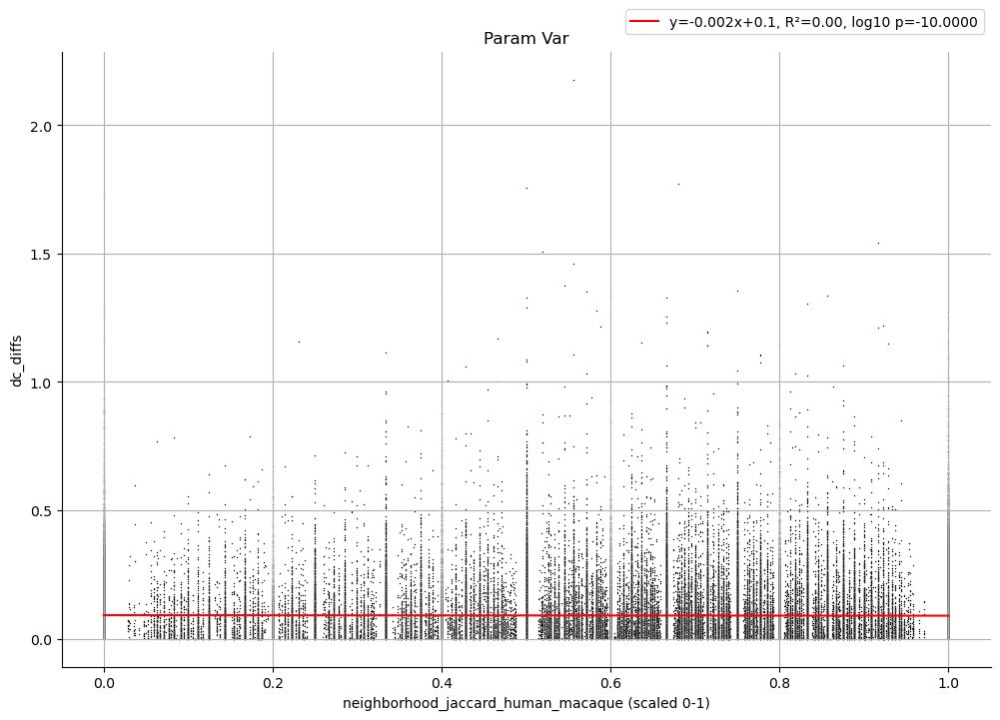

neighborhood_jaccard_macaque_mouse


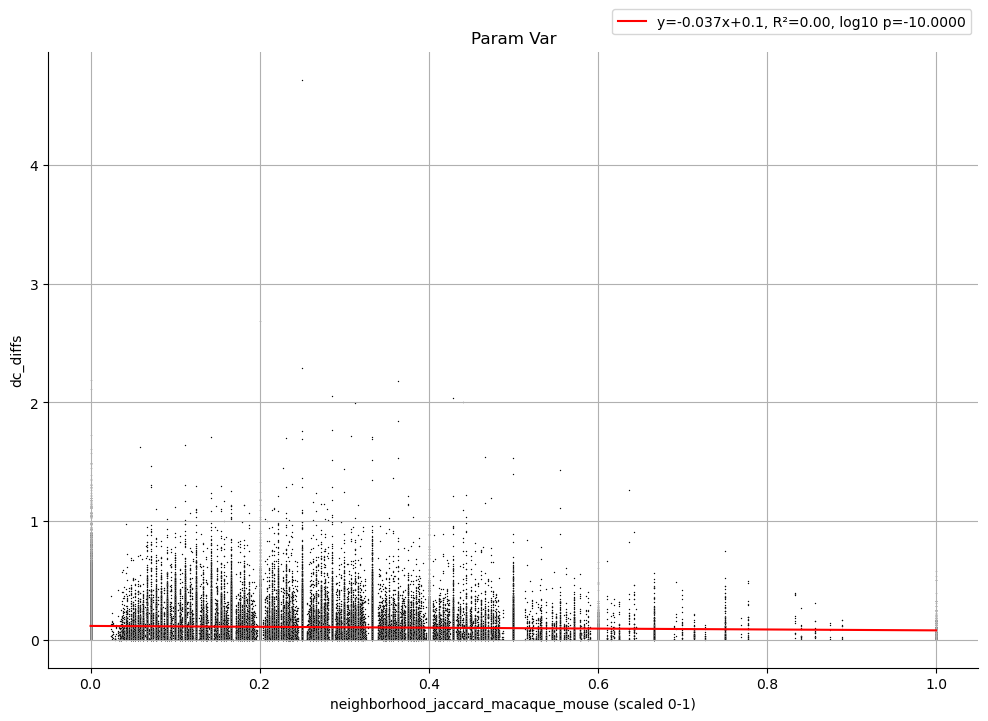

neighborhood_jaccard_mouse_human


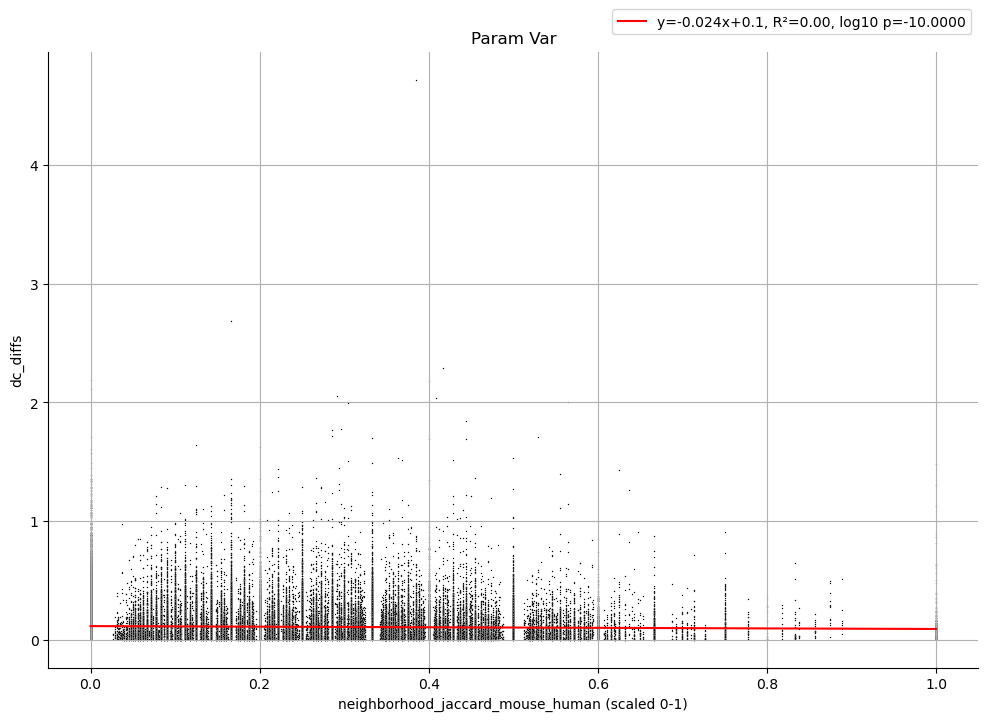

In [195]:
continuous_covs=['gene_size', 'intergenic','neighborhood_jaccard_human_macaque', 'neighborhood_jaccard_macaque_mouse', 'neighborhood_jaccard_mouse_human']
regression_coefs = []

for d in diffs:
    for c in continuous_covs:
        print(c)
        plt.figure(figsize=(12, 8))
        
        # Identify non-NA values and determine scaling parameters
        inspec = ~xsd_final[c].isna()
        x_min = xsd_final.loc[inspec, c].min()
        x_max = xsd_final.loc[inspec, c].max()
        
        # Scale x for regression (all non-NA points)
        x_scaled_full = (xsd_final.loc[inspec, c] - x_min) / (x_max - x_min)
        y_full = xsd_final.loc[inspec, d]
        mask = np.isnan(x_scaled_full) | np.isnan(y_full) | np.isinf(x_scaled_full) | np.isinf(y_full)
        x_scaled_full, y_full = x_scaled_full[~mask], y_full[~mask]

        # Compute regression on scaled x
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x_scaled_full, y_full)
        
        # Prepare scatter plot data: scale x for the random subset using the same parameters
        xsd_final_rand = xsd_final.iloc[rand_plot, :].copy()
        xsd_final_rand[f'{c}_scaled'] = (xsd_final_rand[c] - x_min) / (x_max - x_min)
        
        seaborn.scatterplot(
            data=xsd_final_rand,
            x=f'{c}_scaled',
            y=d,
            s=1,
            c='black'
        )
        
        plt.xlabel(f'{c} (scaled 0-1)')
        plt.ylabel(d)
        
        # Plot regression line over the interval [0, 1]
        x_values = np.linspace(0, 1, 100)
        plt.plot(
            x_values,
            slope * x_values + intercept,
            color='red',
            label=f'y={slope:.3f}x+{intercept:.1f}, R²={r_value**2:.2f}, log10 p={np.log10(p_value+1e-10):.4f}'
        )
        
        regression_coefs.append([c, d, slope, intercept, np.log10(p_value+1e-10)])
        
        # Adjust legend and grid
        plt.legend(loc='upper right', bbox_to_anchor=(1.0, 1.08))
        plt.grid(True)
        plt.title('Param Var')
        plt.show()


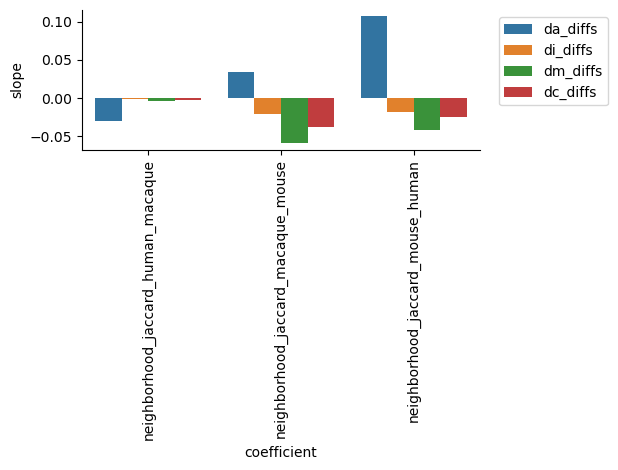

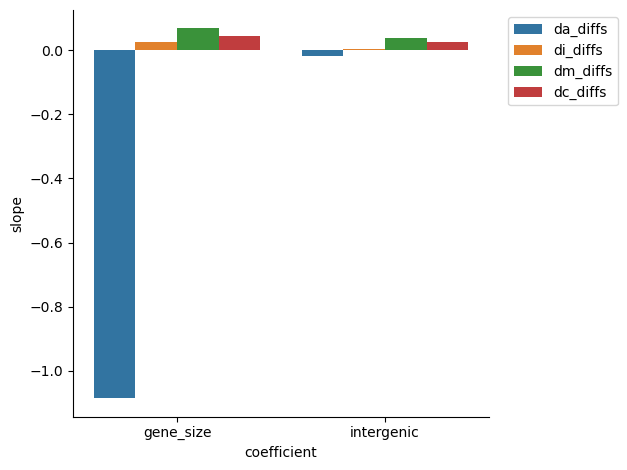

In [196]:
regression_coefs=pd.DataFrame(regression_coefs,columns=['cov','coef','slope','intercept','log10pval'])
seaborn.barplot(data=regression_coefs.loc[~regression_coefs['cov'].isin(['gene_size', 'intergenic'])],x='cov',y='slope',hue='coef') #.loc[regression_coefs['cov'].isin(['gene_size', 'intergenic')]
plt.xlabel('coefficient')
plt.legend(bbox_to_anchor=(1.03, 1), loc='upper left')
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'coef_genome_slope_effects_barplot_jaccard.svg'), format='svg')
plt.show()

regression_coefs=pd.DataFrame(regression_coefs,columns=['cov','coef','slope','intercept','log10pval'])
seaborn.barplot(data=regression_coefs.loc[regression_coefs['cov'].isin(['gene_size', 'intergenic'])],x='cov',y='slope',hue='coef')#.loc[regression_coefs['cov'].isin(['gene_size', 'intergenic')]
plt.xlabel('coefficient')
plt.legend(bbox_to_anchor=(1.03, 1), loc='upper left')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'coef_genome_slope_effects_barplot.svg'), format='svg')
plt.show()

coef                                da_diffs  dc_diffs  di_diffs  dm_diffs
cov                                                                       
gene_size                          -1.085426  0.043217  0.027159  0.068057
intergenic                         -0.019282  0.024383  0.004576  0.039571
neighborhood_jaccard_human_macaque -0.030054 -0.002080 -0.001715 -0.003281
neighborhood_jaccard_macaque_mouse  0.034673 -0.037411 -0.020304 -0.059177
neighborhood_jaccard_mouse_human    0.107090 -0.024387 -0.017709 -0.041421


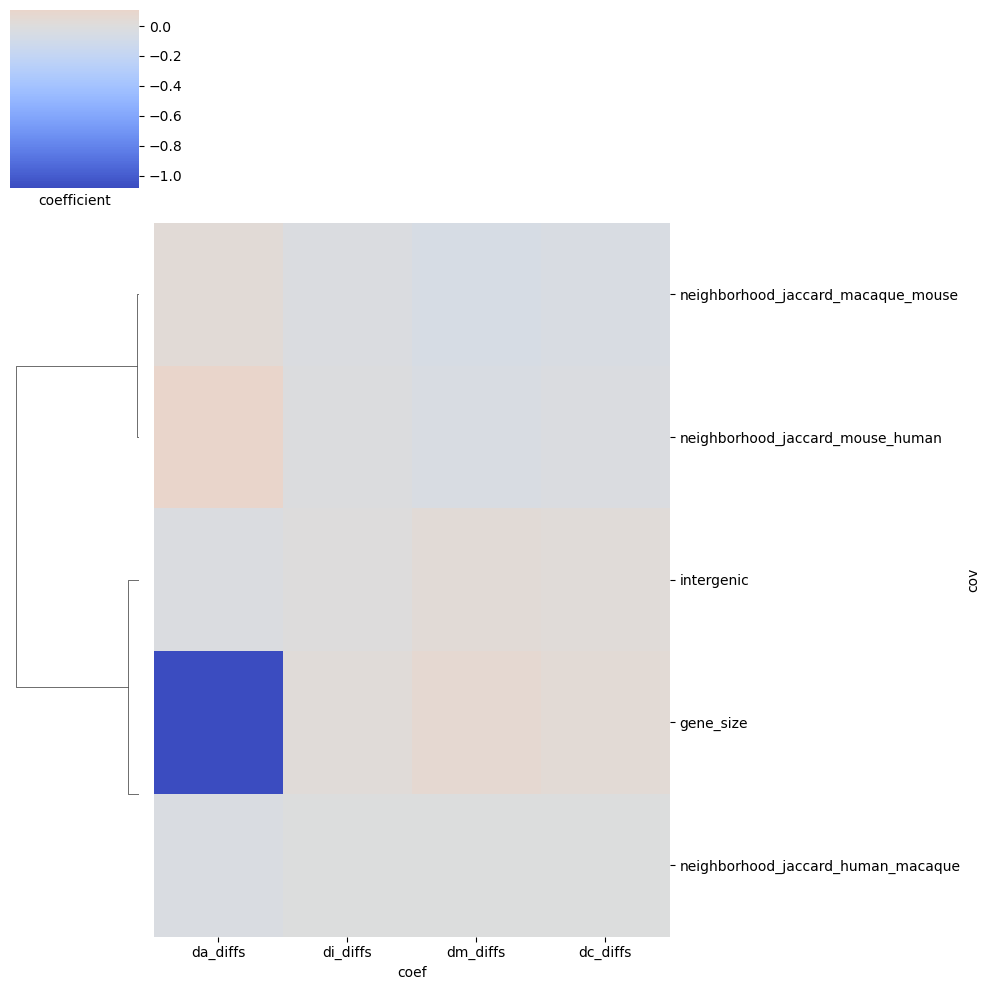

In [197]:
regression_coefs=pd.DataFrame(regression_coefs,columns=['cov','coef','slope','intercept','log10pval'])
pivoted = regression_coefs.loc[:,['cov','coef','slope']].pivot_table(index=['cov','coef'],values='slope').unstack()
pivoted.columns=pivoted.columns.droplevel(0)
print(pivoted)
seaborn.clustermap(pivoted.loc[:,['da_diffs','di_diffs','dm_diffs','dc_diffs']],cmap='coolwarm',center=0.,metric='correlation',col_cluster=False)
plt.xlabel('coefficient')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'coef_genome_slope_effects_hm.svg'), format='svg')


0


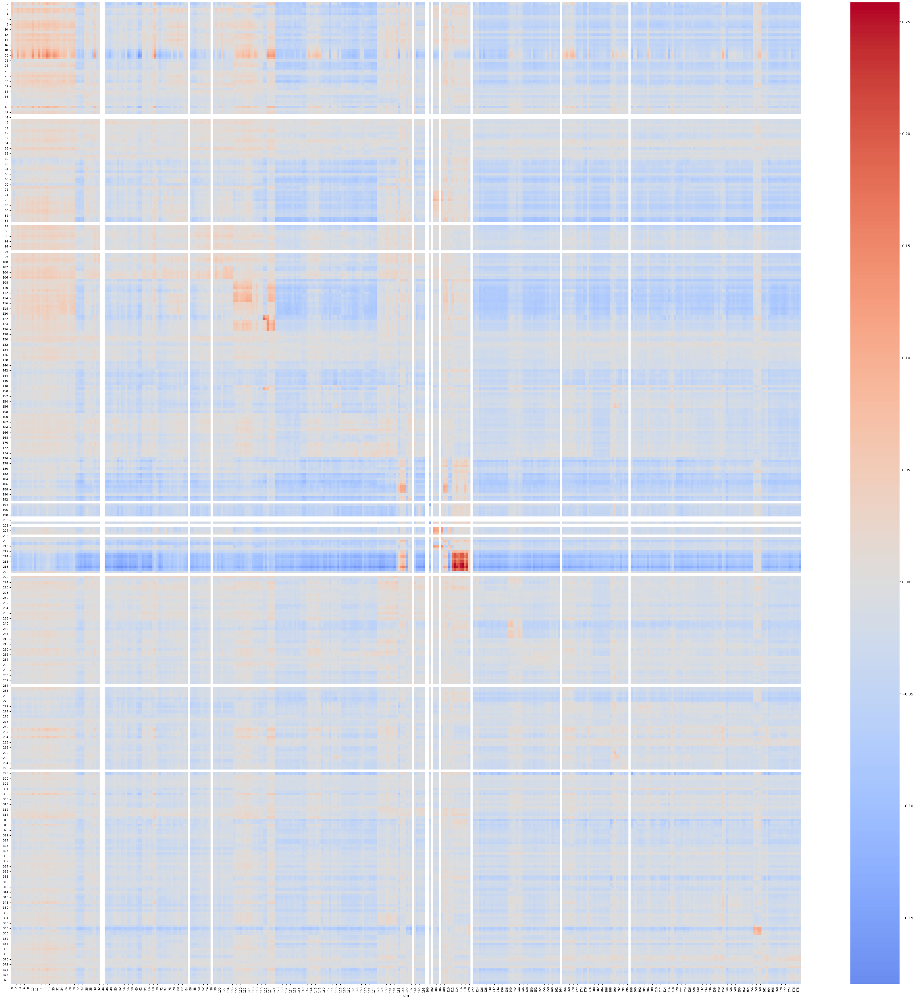

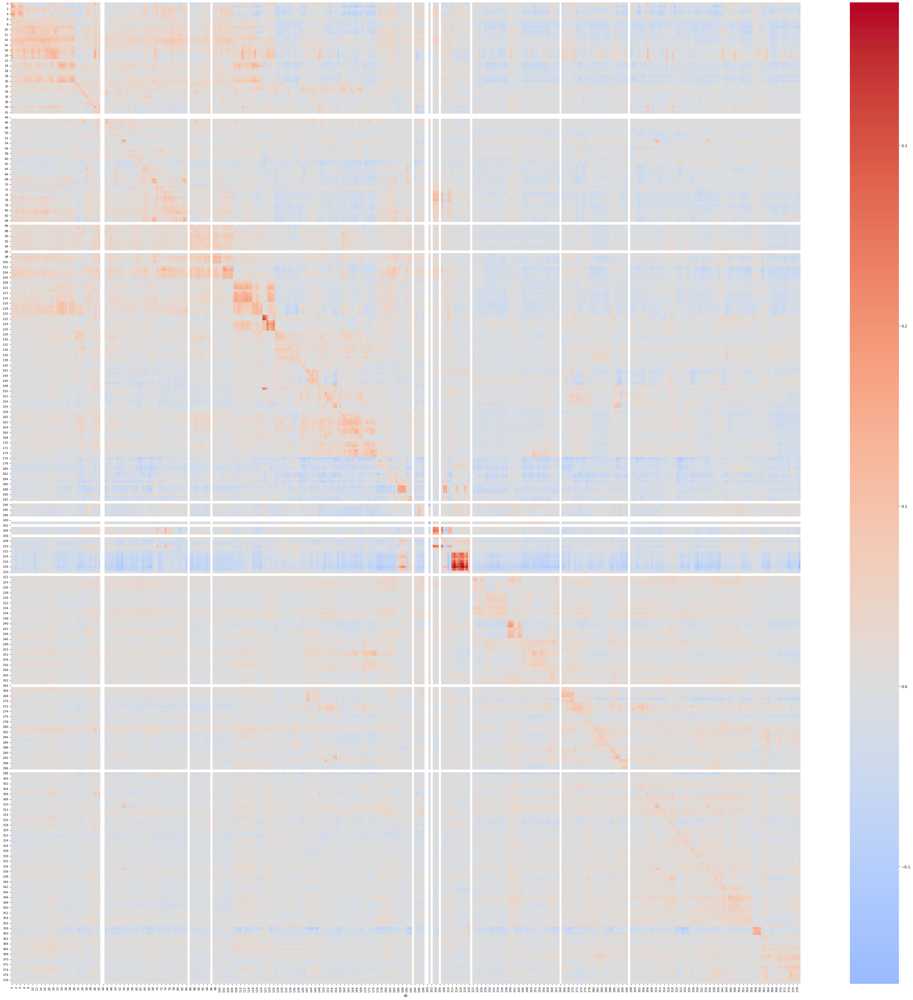

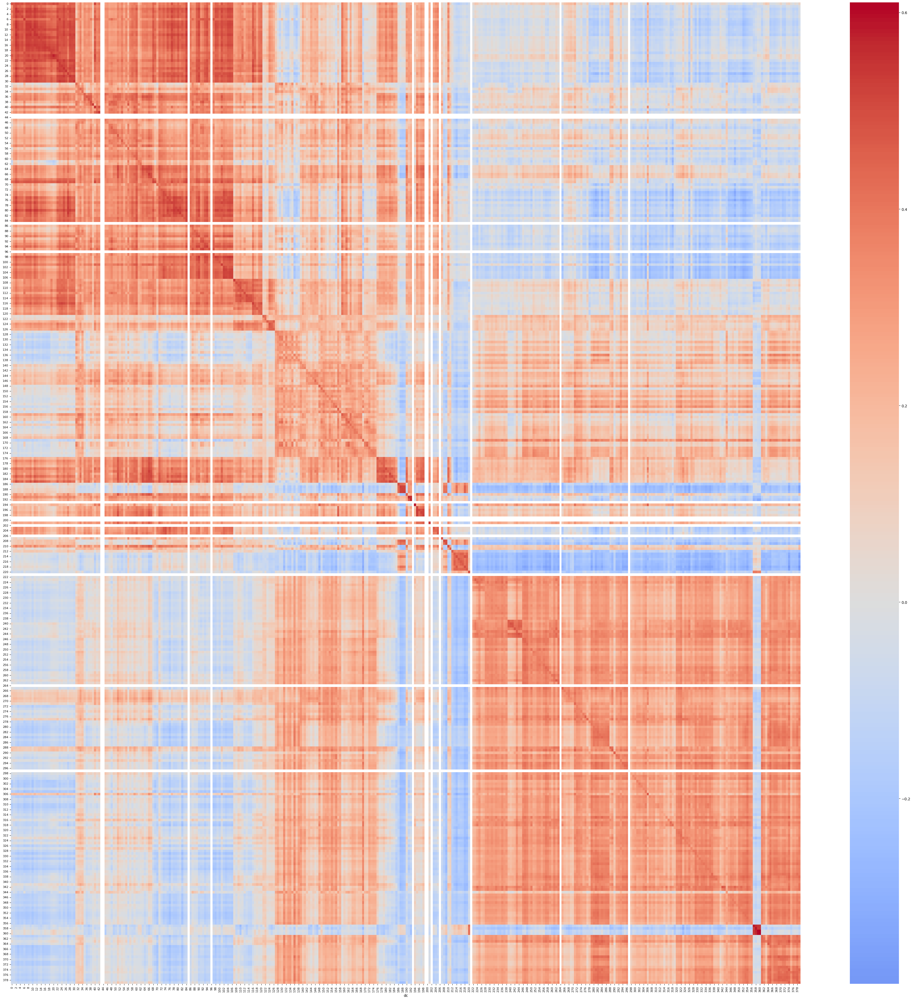

1


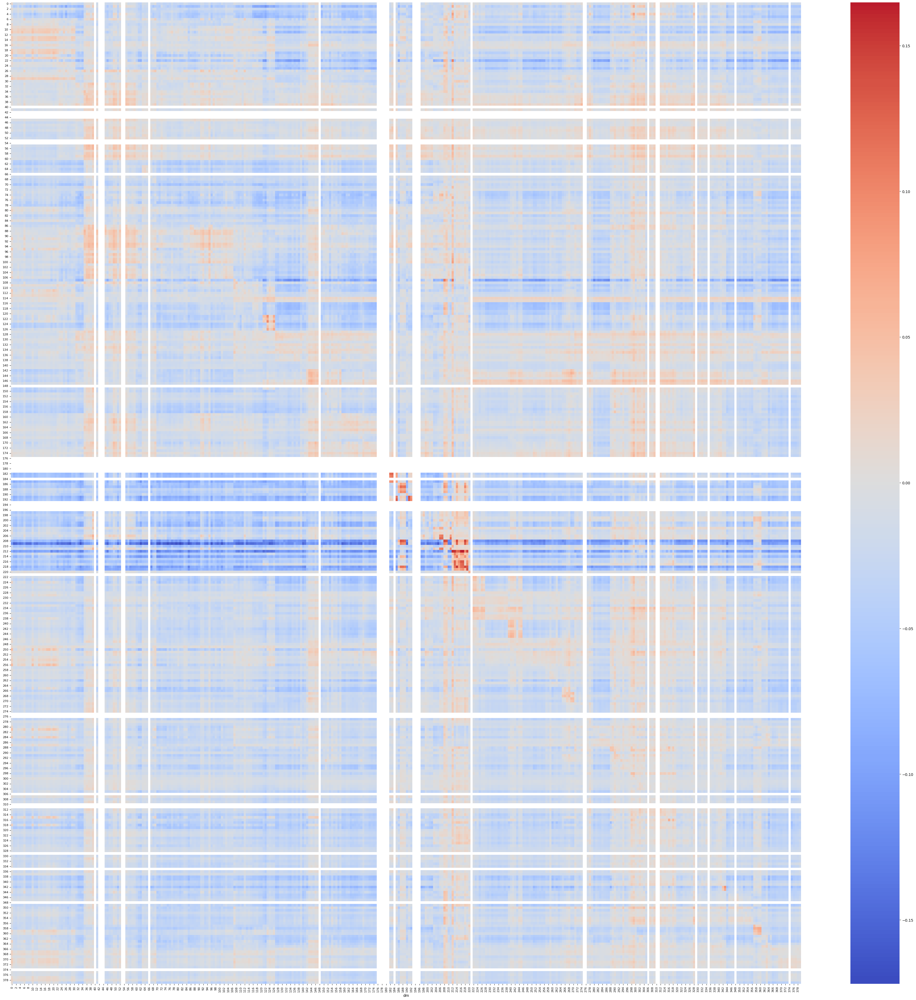

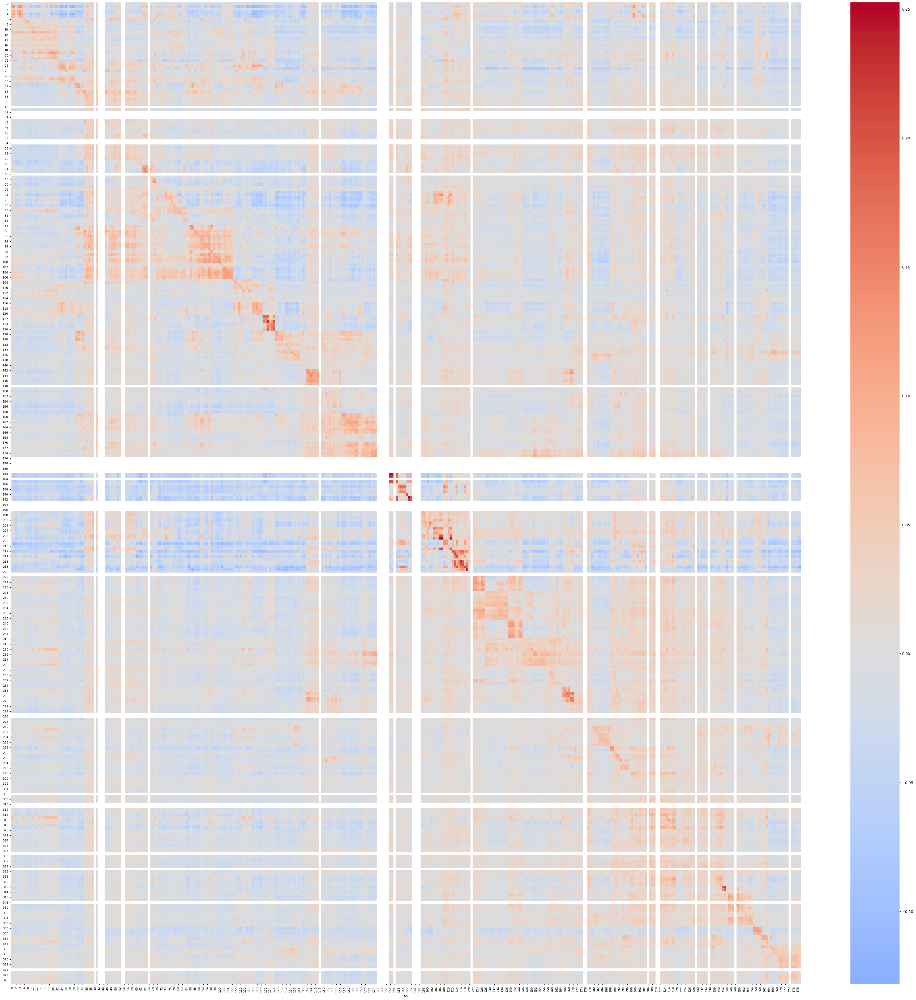

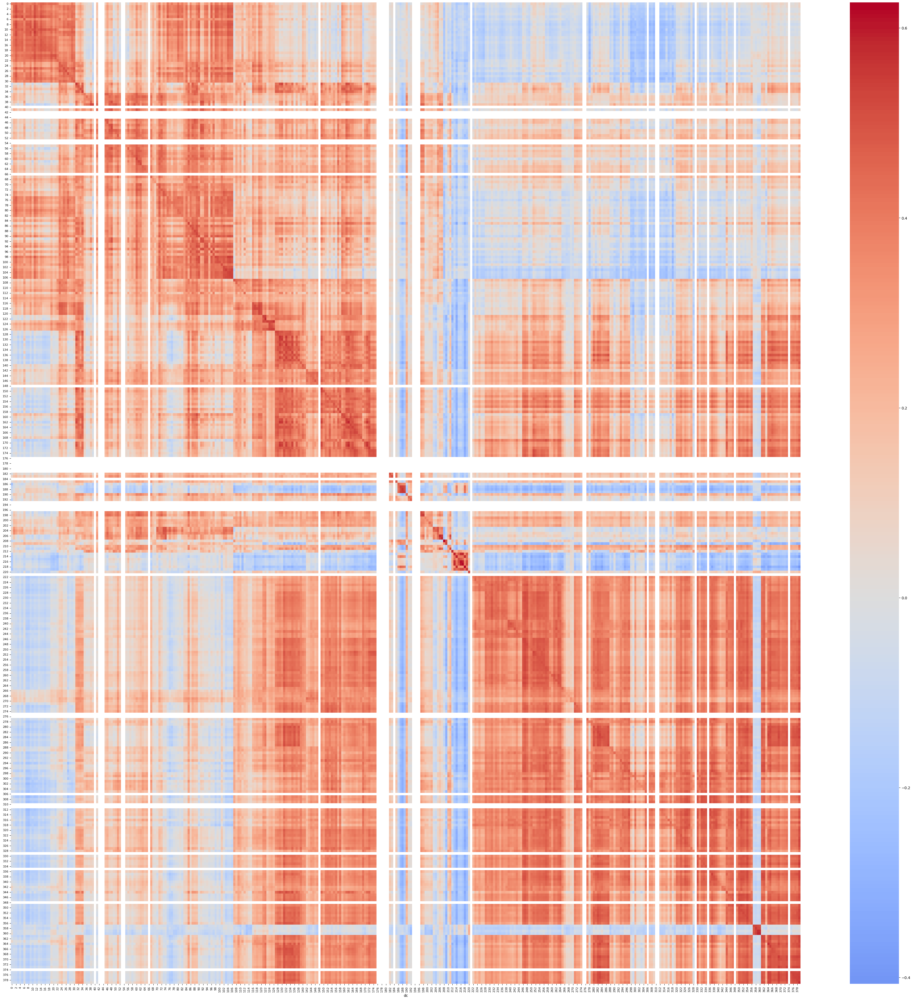

2


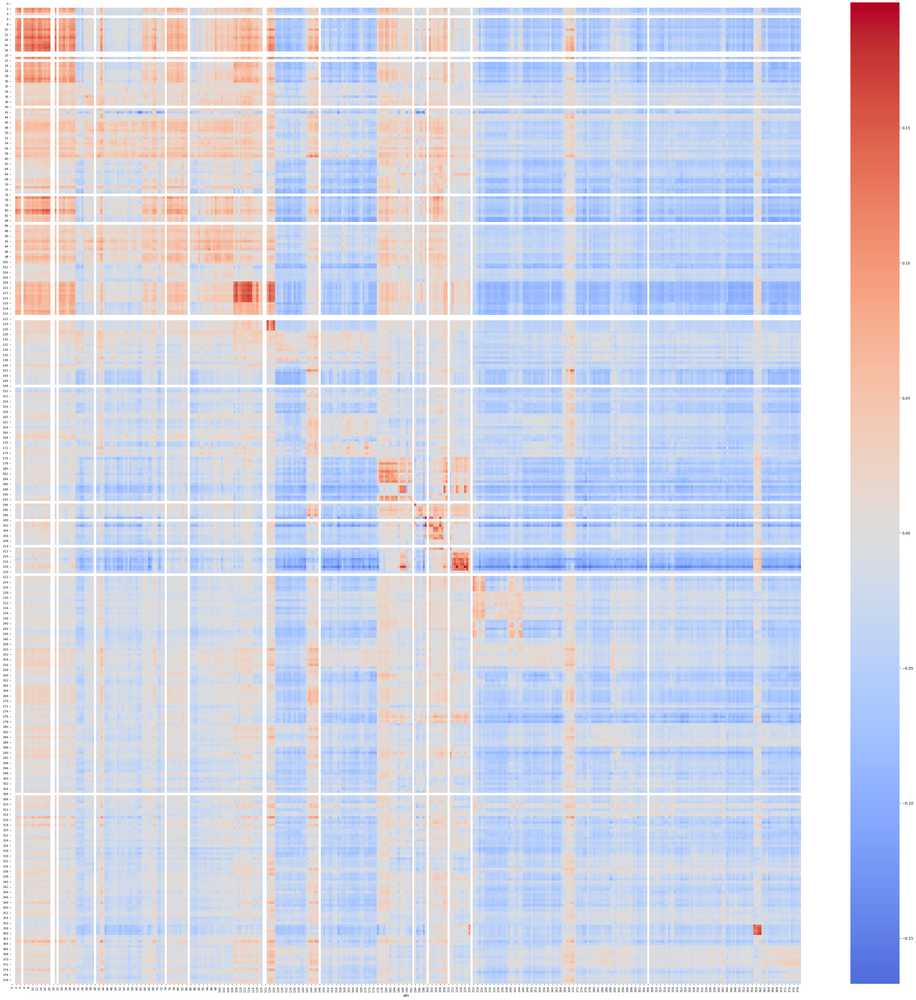

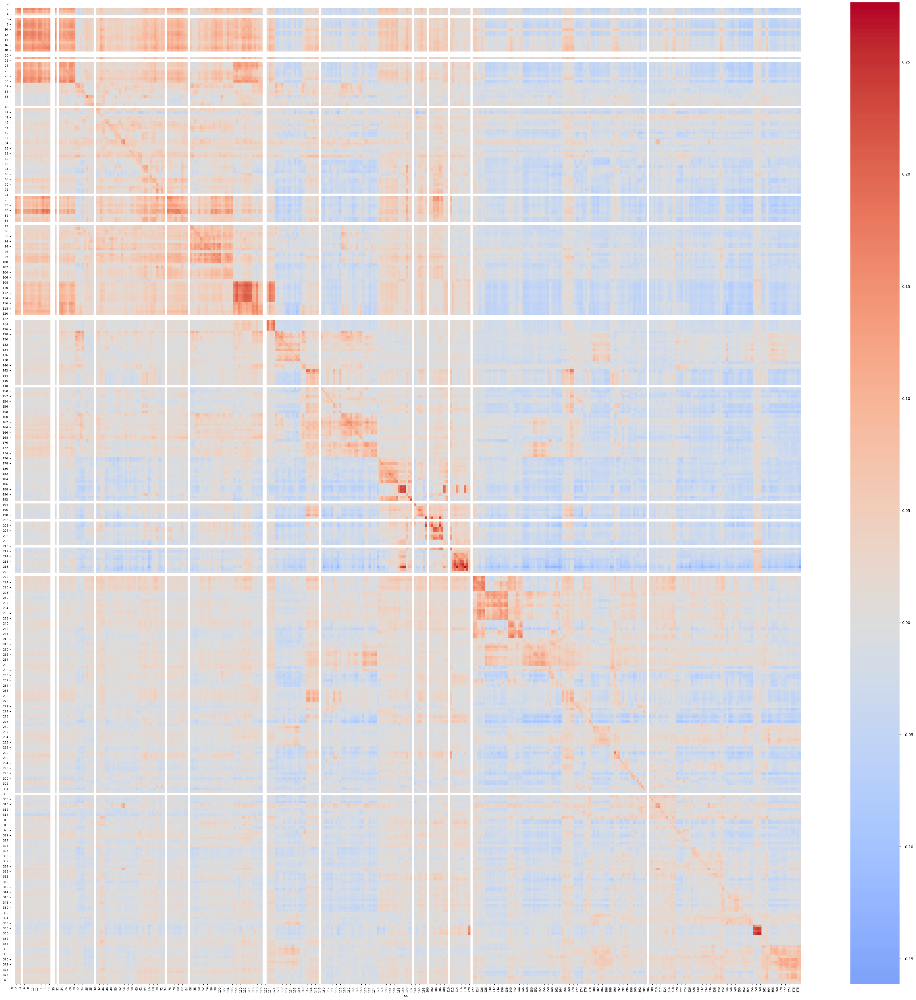

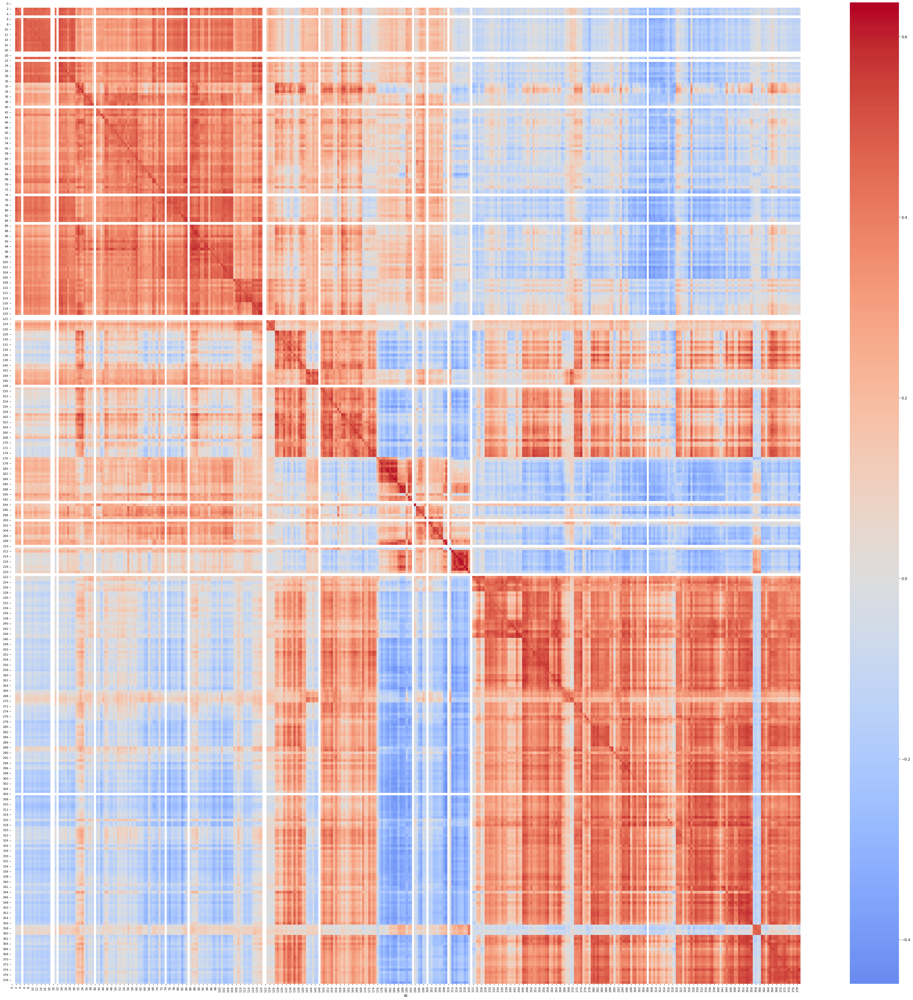

In [198]:
# examine concordance in effects
# diagonal represents concordance in same cell type
for i in range(3):
    print(i)
    sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(di_diffs[i],dm_diffs[i])),cmap='coolwarm',center=0)
    plt.xlabel('di')
    plt.xlabel('dm')
    plt.show()
    sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(di_diffs[i],dc_diffs[i])),cmap='coolwarm',center=0)
    plt.xlabel('di')
    plt.xlabel('dc')
    plt.show()
    sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(dm_diffs[i],dc_diffs[i])),cmap='coolwarm',center=0)
    plt.xlabel('dm')
    plt.xlabel('dc')
    plt.show()


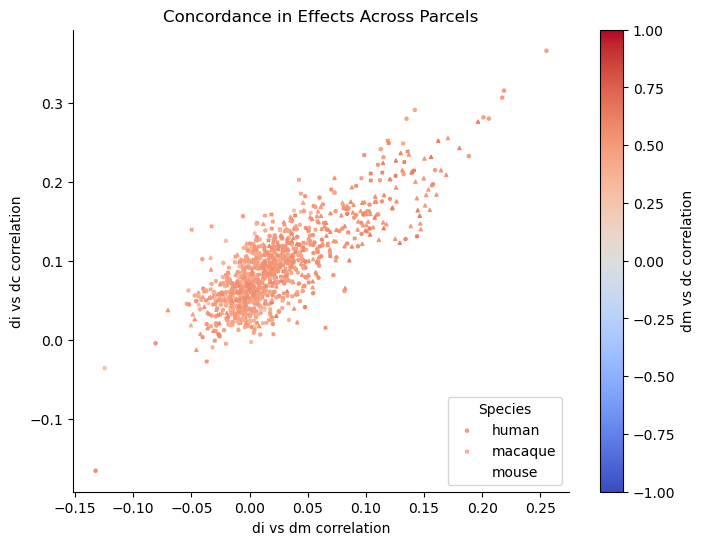

In [199]:
# examine concordance in effects
# diagonal represents concordance in same cell type
# Bottom line: DM and DC are quite concordant

markers = ["o", "x", "^"]

# Create a single figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Loop over species (assuming 3 species corresponding to indices 0, 1, 2)
for i, marker in enumerate(markers):
    # Calculate correlations for species i
    corr_di_dm = sc_analysis.corr2_coeff(di_diffs[i], dm_diffs[i])
    corr_di_dc = sc_analysis.corr2_coeff(di_diffs[i], dc_diffs[i])
    corr_dm_dc = sc_analysis.corr2_coeff(dm_diffs[i], dc_diffs[i])
    
    # Extract the diagonal correlation values
    diag_corr_di_dm = np.diag(corr_di_dm)
    diag_corr_di_dc = np.diag(corr_di_dc)
    diag_corr_dm_dc = np.diag(corr_dm_dc)
    
    # Scatter plot for species i with its own marker shape
    scatter = ax.scatter(diag_corr_di_dm, diag_corr_di_dc,
                    c=diag_corr_dm_dc, cmap='coolwarm', vmin=-1, vmax=1,
                    marker=marker, label=discov_labels[i],s=5.)

# Label the axes
ax.set_xlabel('di vs dm correlation')
ax.set_ylabel('di vs dc correlation')

# Add a colorbar (using the last scatter as reference since vmin/vmax are fixed)
cbar = plt.colorbar(scatter, ax=ax, label='dm vs dc correlation')

# Add a legend to differentiate species (each with a different marker)
ax.legend(title="Species", loc='lower right')

# Add an overall title
plt.title("Concordance in Effects Across Parcels")

# Save the combined plot (adjust the path as needed)
plt.savefig(os.path.join(sc.settings.figdir, 'coef_concordance_scatter_all_species.svg'), format='svg')
plt.show()


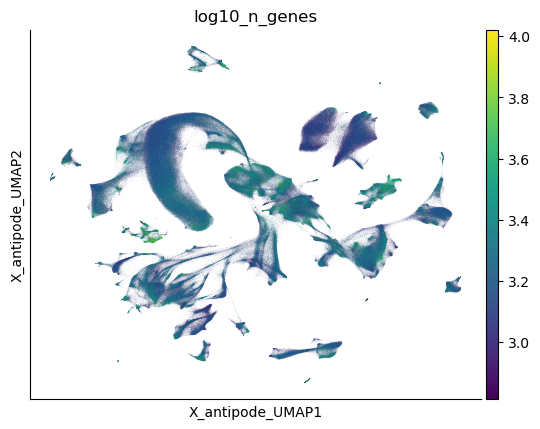

In [200]:
adata.obs['log10_n_genes'] = np.log10(adata.obs['n_genes'])
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['log10_n_genes'], save='_log_genes.pdf'
)

In [201]:
neighborhood_key = 'Division'
Initial_Class_key = 'Initial_Class_markers'
level2_ccl_dict = adata.obs.groupby(Initial_Class_key)[leaf_key].value_counts().unstack().idxmax(0).to_dict()
level2_neighborhood_dict = adata.obs.groupby(neighborhood_key)[leaf_key].value_counts().unstack().idxmax(0).to_dict()

In [202]:
leaf_key

'Initial_Class_markers_level_2'

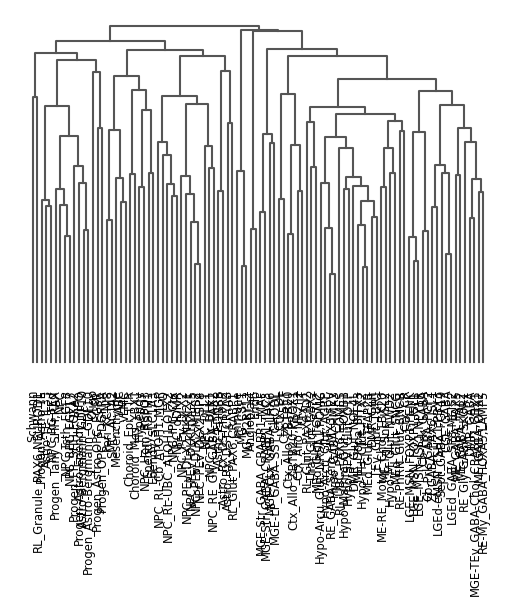

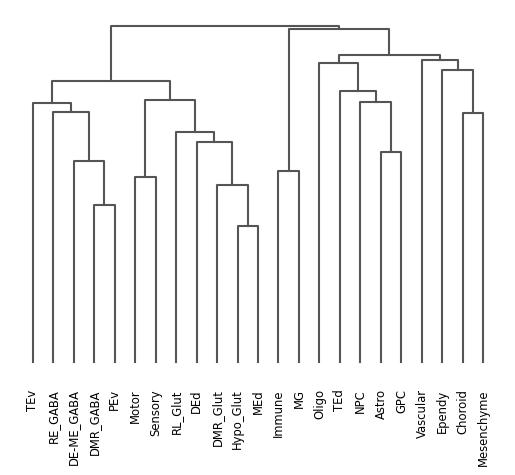

<Axes: >

In [203]:
sc.tl.dendrogram(adata,groupby=Initial_Class_key,use_rep='X_antipode',linkage_method='average',cor_method='kendall')
sc.pl.dendrogram(adata,groupby=Initial_Class_key)

sc.tl.dendrogram(adata,groupby=neighborhood_key,use_rep='X_antipode',linkage_method='average',cor_method='kendall')
sc.pl.dendrogram(adata,groupby=neighborhood_key)

In [204]:
diff_dfs = {}
for name,x in zip(['summary','di_diffs','dm_diffs','dc_diffs'],[de_diffs,di_diffs,dm_diffs,dc_diffs]):
    diff_dfs[name] = pd.DataFrame(np.nanmean(np.absolute(x),axis=0).mean(1),index=[l2_leaf_dict[x] for x in cluster_labels])
    diff_dfs[name][Initial_Class_key] = diff_dfs[name].index.to_series().replace(level2_ccl_dict)
    diff_dfs[name][Initial_Class_key] = diff_dfs[name][Initial_Class_key].astype('category')
    diff_dfs[name][Initial_Class_key] = diff_dfs[name][Initial_Class_key].cat.reorder_categories(adata.uns['dendrogram_'+Initial_Class_key]['categories_ordered'])
    diff_dfs[name][neighborhood_key] = diff_dfs[name].index.to_series().replace(level2_neighborhood_dict)
    diff_dfs[name][neighborhood_key] = diff_dfs[name][neighborhood_key].astype('category')
    diff_dfs[name][neighborhood_key] = diff_dfs[name][neighborhood_key].cat.reorder_categories(adata.uns['dendrogram_'+neighborhood_key]['categories_ordered'])
    diff_dfs[name]['cluster'] = diff_dfs[name].index.to_series()

/scratch/fast/4048428/ipykernel_2863333/4289396289.py:3: RuntimeWarning: Mean of empty slice
  diff_dfs[name] = pd.DataFrame(np.nanmean(np.absolute(x),axis=0).mean(1),index=[l2_leaf_dict[x] for x in cluster_labels])
/scratch/fast/4048428/ipykernel_2863333/4289396289.py:3: RuntimeWarning: Mean of empty slice
  diff_dfs[name] = pd.DataFrame(np.nanmean(np.absolute(x),axis=0).mean(1),index=[l2_leaf_dict[x] for x in cluster_labels])
/scratch/fast/4048428/ipykernel_2863333/4289396289.py:3: RuntimeWarning: Mean of empty slice
  diff_dfs[name] = pd.DataFrame(np.nanmean(np.absolute(x),axis=0).mean(1),index=[l2_leaf_dict[x] for x in cluster_labels])
/scratch/fast/4048428/ipykernel_2863333/4289396289.py:3: RuntimeWarning: Mean of empty slice
  diff_dfs[name] = pd.DataFrame(np.nanmean(np.absolute(x),axis=0).mean(1),index=[l2_leaf_dict[x] for x in cluster_labels])


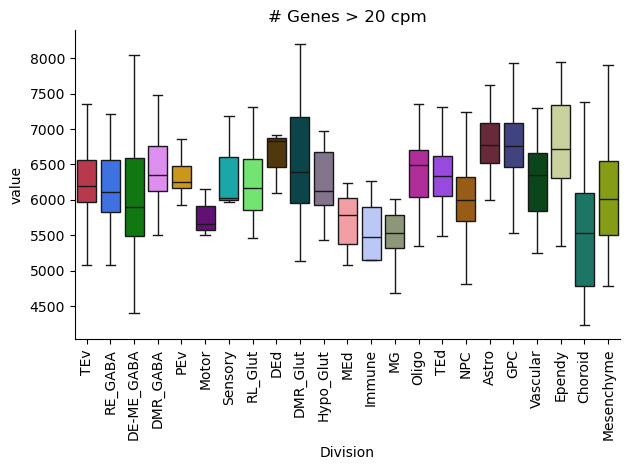

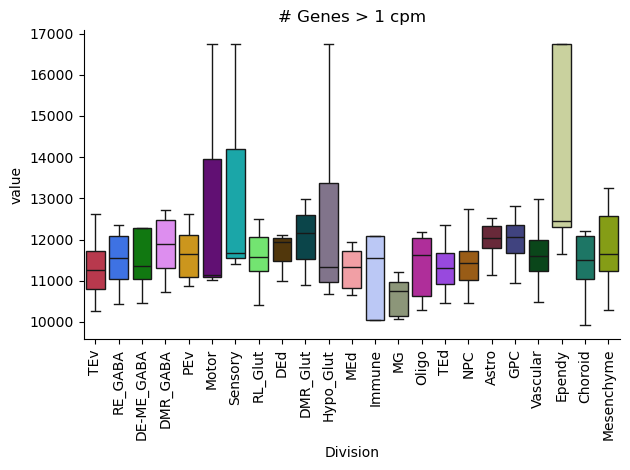

In [205]:
cluster_n_genes = pd.DataFrame((log_real_means>np.log(2e-5)).sum(-1),index=real_mean_levels['species'],columns=real_mean_levels[leaf_key])
cluster_n_genes = cluster_n_genes.melt()
cluster_n_genes
cluster_n_genes[neighborhood_key] = cluster_n_genes['variable'].replace(level2_neighborhood_dict)
cluster_n_genes[neighborhood_key] = cluster_n_genes[neighborhood_key].astype('category')
cluster_n_genes[neighborhood_key] = cluster_n_genes[neighborhood_key].cat.reorder_categories(adata.uns['dendrogram_'+neighborhood_key]['categories_ordered'])
seaborn.boxplot(x=neighborhood_key,y='value',data=cluster_n_genes,hue=neighborhood_key,palette=list(adata.uns[neighborhood_key+'_colors']),showfliers=False)
plt.xticks(rotation=90)
plt.title('# Genes > 20 cpm')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, '20cpm_cluster_genes.svg'), format='svg')
plt.show()
cluster_n_genes = pd.DataFrame((log_real_means>np.log(1e-6)).sum(-1),index=real_mean_levels['species'],columns=real_mean_levels[leaf_key])
cluster_n_genes = cluster_n_genes.melt()
cluster_n_genes
cluster_n_genes[neighborhood_key] = cluster_n_genes['variable'].replace(level2_neighborhood_dict)
cluster_n_genes[neighborhood_key] = cluster_n_genes[neighborhood_key].astype('category')
cluster_n_genes[neighborhood_key] = cluster_n_genes[neighborhood_key].cat.reorder_categories(adata.uns['dendrogram_'+neighborhood_key]['categories_ordered'])
seaborn.boxplot(x=neighborhood_key,y='value',data=cluster_n_genes,hue=neighborhood_key,palette=list(adata.uns[neighborhood_key+'_colors']),showfliers=False)
plt.title('# Genes > 1 cpm')
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, '1cpm_cluster_genes.svg'), format='svg')
plt.show()

In [206]:
big_df = []
for k in diff_dfs.keys():
    if 'da' not in k:
        diff_dfs[k]['parcel'] = k
        big_df.append(diff_dfs[k])
big_df = pd.concat(big_df,axis=0).reset_index(drop=True)

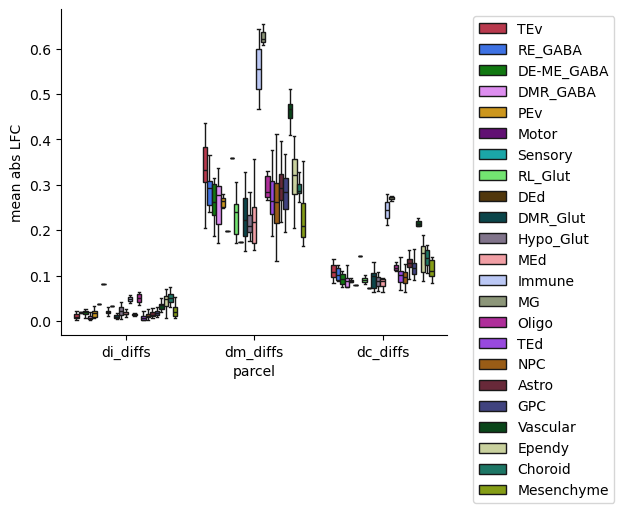

In [207]:
ax = seaborn.boxplot(x='parcel',y=0,data=big_df.loc[big_df['parcel']!='summary'],hue=neighborhood_key,palette=list(adata.uns[neighborhood_key+'_colors']),showfliers=False)
plt.title('')
plt.ylabel('mean abs LFC')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'meanabsmag_neighborhood_boxplot.svg'), format='svg')
plt.show()

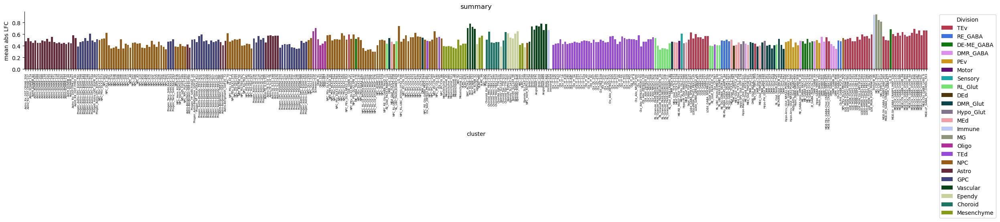

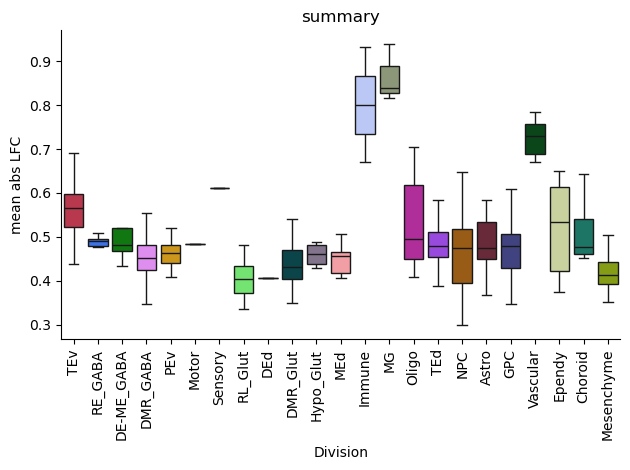

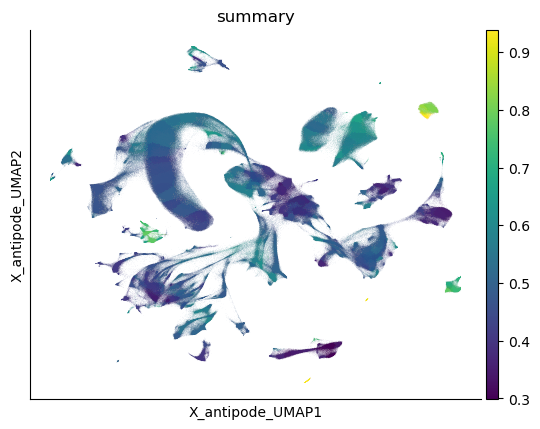

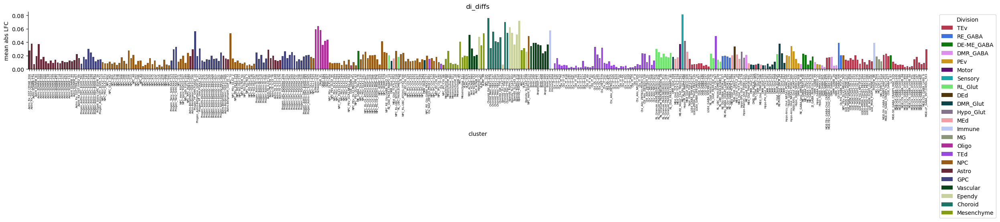

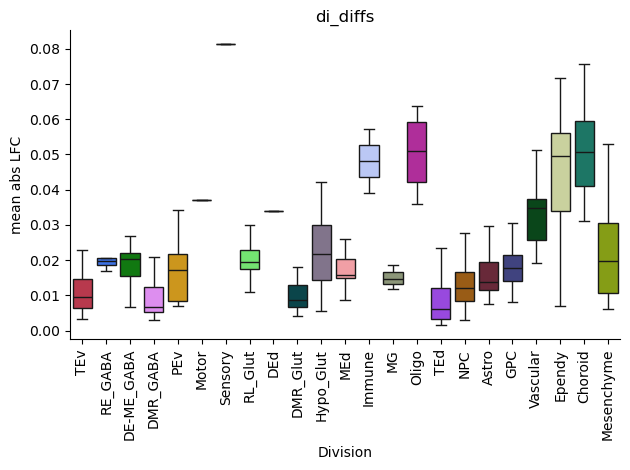

...

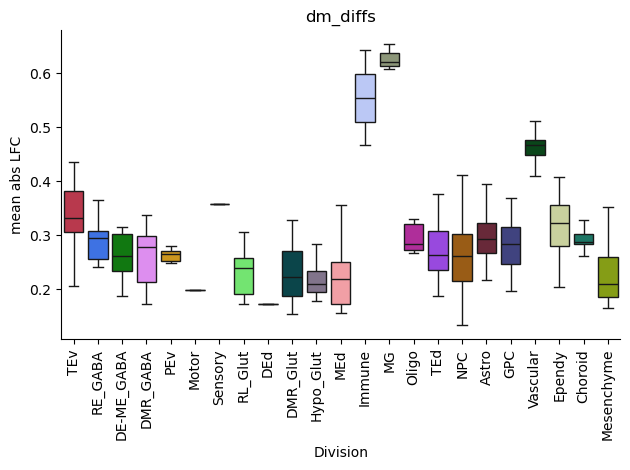

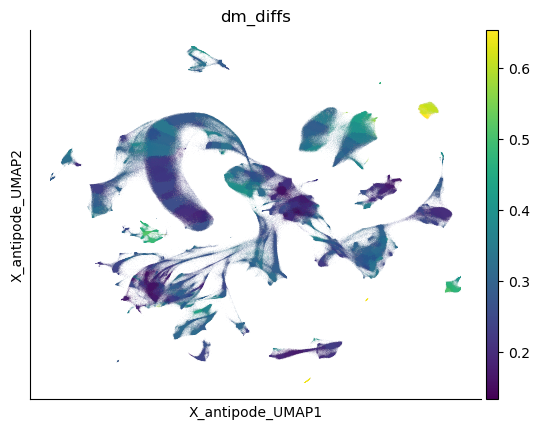

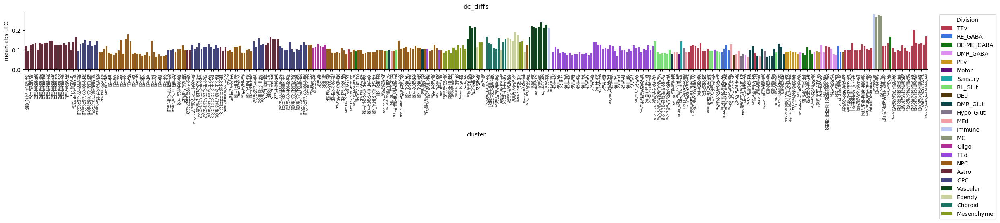

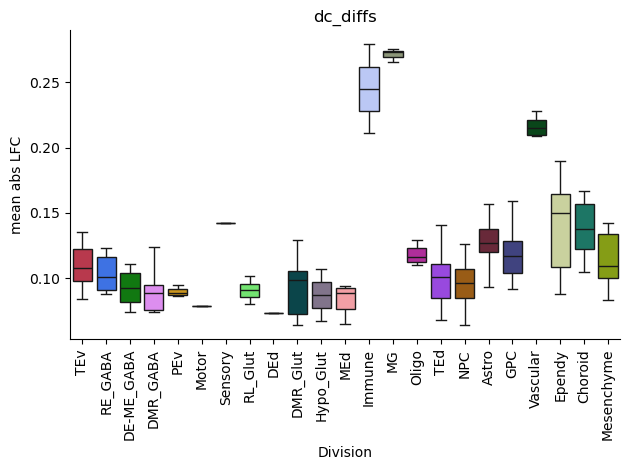

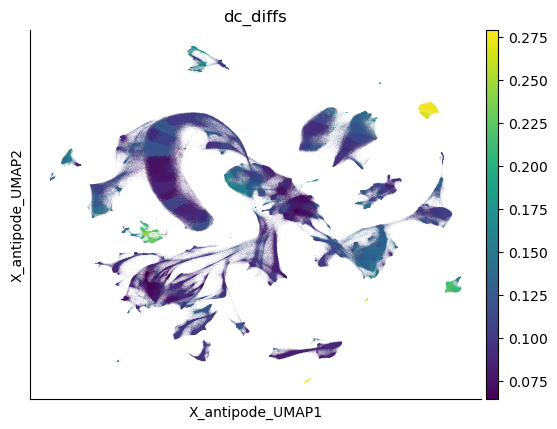

In [208]:
for k in diff_dfs.keys():
    plt.figure(figsize=(25,4))
    ax = seaborn.barplot(x='cluster',y=0,data=diff_dfs[k],hue=neighborhood_key,palette=list(adata.uns['Division_colors']),order=diff_dfs[k].index)
    seaborn.move_legend(ax, "upper left", bbox_to_anchor=(1.01, 1))
    plt.xticks(rotation=90,fontsize=5)
    plt.title(k)
    plt.ylabel('mean abs LFC')
    plt.tight_layout()
    plt.show()
    ax = seaborn.boxplot(x=neighborhood_key,y=0,data=diff_dfs[k],hue=neighborhood_key,palette=list(adata.uns[neighborhood_key+'_colors']),showfliers=False)
    plt.title(k)
    plt.ylabel('mean abs LFC')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir, f'{k}_neighborhood_boxplot.svg'), format='svg')
    plt.show()
    adata.obs[k] = adata.obs[leaf_key].replace(diff_dfs[k][0].to_dict()).astype(float)
    sc.pl.embedding(
        adata,
        basis=MDE_KEY,
        color=[k],
        save=f'_{k}_marginal_umap'
    )


In [209]:
print(gseapy.get_library_name())

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_2023', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'COMPARTMENTS_Curated_2025', 'COMPARTMENTS_Experimental_2025', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_2024', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'ClinVar_2025', 'DGIdb_Drug_Targets_2024', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_CRISPR_GeneDependency_CellLines_2023', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_201

In [210]:
for i in range(param['da_diffs'].shape[0]):
    print(i)
    score_series = pd.Series(param['da_diffs'][i,0,:],index=adata.var.index) #dim1 vals are all the same (DA)
    gsea = gseapy.prerank(score_series,['GO_Biological_Process_2025','GO_Molecular_Function_2025','WikiPathways_2024_Human'],min_size=5,max_size=500,permutation_num=5000)
    print(gsea.res2d.loc[gsea.res2d['FDR q-val']<0.1,:].sort_values('NES'))
    sig_terms = gsea.res2d.loc[gsea.res2d['FDR q-val']<0.1,'Term']
    # gsea.plot(sig_terms)
    # plt.show()

2025-10-05 00:34:47,474 [WARNING] Duplicated values found in preranked stats: 0.48% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


0


2025-10-05 01:06:10,486 [WARNING] Duplicated values found in preranked stats: 0.41% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


       Name                                               Term        ES  \
17  prerank  GO_Biological_Process_2025__sno(s)RNA 3'-End P...  0.839153   
16  prerank  WikiPathways_2024_Human__Disorders Of Bile Aci...  0.679382   
15  prerank  GO_Biological_Process_2025__Bile Acid and Bile...   0.74497   
13  prerank  GO_Biological_Process_2025__Detection of Chemi...  0.603421   
12  prerank  GO_Biological_Process_2025__Sensory Perception...  0.603065   
11  prerank  GO_Biological_Process_2025__Detection of Chemi...  0.609112   
10  prerank  GO_Molecular_Function_2025__Olfactory Receptor...  0.522945   
9   prerank  GO_Molecular_Function_2025__Oxidoreductase, Pa...  0.773769   
8   prerank  GO_Biological_Process_2025__B Cell Activation ...  0.777865   
7   prerank  GO_Biological_Process_2025__Detection of Chemi...  0.753282   
6   prerank  GO_Biological_Process_2025__Detection of Chemi...  0.793619   
5   prerank  GO_Molecular_Function_2025__Bitter Taste Recep...  0.947812   
4   prerank 

2025-10-05 01:45:10,848 [WARNING] Duplicated values found in preranked stats: 0.22% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


      Name                                               Term        ES  \
0  prerank  WikiPathways_2024_Human__FBXL10 Enhancement Of... -0.715162   
8  prerank  GO_Molecular_Function_2025__Bile Acid Transmem...  0.838676   
4  prerank  GO_Biological_Process_2025__Bile Acid and Bile...  0.771609   

        NES NOM p-val FDR q-val FWER p-val Tag %  Gene %  \
0 -2.157668       0.0  0.098815     0.1008  4/21   4.30%   
8  1.950855  0.000574  0.055013      0.092  6/12  10.06%   
4   1.96906   0.00056  0.070731     0.0588  8/18  10.60%   

                                          Lead_genes  
0                         H3C13;H3-3B;H3C4;MACROH2A2  
8       SLCO1A2;SLC51B;SLC10A4;ABCC4;SLCO1C1;SLCO2B1  
4  SLCO1A2;SLC51B;SLC10A4;ABCC4;SLC27A5;SLCO1C1;S...  
2
       Name                                               Term        ES  \
0   prerank  WikiPathways_2024_Human__Cytoplasmic Ribosomal... -0.706956   
1   prerank  GO_Biological_Process_2025__Sensory Perception... -0.857557   
2   prer

In [ ]:
import xarray as xr
de_array = xr.DataArray(de_diffs-np.nanmean(de_diffs,0),coords={'species':adata.obs[discov_key].cat.categories,'level_2':adata.obs['Initial_Class_markers_level_2'].cat.categories,'var':adata.var.index})

In [ ]:
import warnings

# --- user parameters --------------------------------
species         = de_array.coords['species'].values.tolist()
clusters        = de_array.coords['level_2'].values.tolist()
min_size        = 5
max_size        = 500
permutation_num = 1
seed            = 42
gene_sets       = gseapy.get_library('GO_Biological_Process_2025')#['GO_Biological_Process_2025']
# ----------------------------------------------------

# 1) run prerank and collect per-(species,cluster) results
results   = {}
all_terms = set()

for sp in species:
    for cl in tqdm.tqdm(clusters[:4]):       # remove [:4] to do all clusters
        # extract a pandas Series: index=gene names, values=logFC
        scores = de_array.sel(species=sp, level_2=cl).to_series()

        # if all NaN, skip GSEA and record empty
        if scores.dropna().empty:
            results[(sp, cl)] = {
                'qval': pd.Series(dtype=float),
                'NES' : pd.Series(dtype=float)
            }
            continue

        try:
            prer = gseapy.prerank(
                rnk=scores,
                gene_sets=gene_sets,
                outdir=None,
                min_size=min_size,
                max_size=max_size,
                permutation_num=permutation_num,
                seed=seed,
                verbose=False
            )
            df = prer.res2d

            results[(sp, cl)] = {
                'qval': df['FDR q-val'],
                'NES' : df['NES']
            }
            all_terms.update(df['Term'].tolist())

        except Exception as e:
            warnings.warn(f"GSEA prerank failed for {sp!r}, {cl!r}: {e}")
            results[(sp, cl)] = {
                'qval': pd.Series(dtype=float),
                'NES' : pd.Series(dtype=float)
            }

# 2) unify term dimension
all_terms = sorted(all_terms)
term_idx  = {t: i for i, t in enumerate(all_terms)}

# 3) allocate arrays
S, C, T = len(species), len(clusters), len(all_terms)
arr_q   = np.full((S, C, T), np.nan)
arr_nes = np.full((S, C, T), np.nan)

# 4) fill arrays (missing entries remain NaN)
for i, sp in enumerate(species):
    for j, cl in enumerate(clusters):
        res = results.get((sp, cl),
                          {'qval': pd.Series(dtype=float),
                           'NES' : pd.Series(dtype=float)})
        for term, qv in res['qval'].items():
            arr_q[i, j, term] = qv
        for term, nes in res['NES'].items():
            arr_nes[i, j, term] = nes

# 5) wrap in xarray
coords = {
    'species': species,
    'level_2': clusters,
    'term'   : all_terms
}
q_da   = xr.DataArray(np.nan_to_num(arr_q,1.),
                      dims=('species','level_2','term'),
                      coords=coords,
                      name='FDR_q_val')
nes_da = xr.DataArray(np.nan_to_num(arr_nes,0.),
                      dims=('species','level_2','term'),
                      coords=coords,
                      name='NES')

term_ds = xr.Dataset({'FDR_q_val': q_da, 'NES': nes_da})



In [ ]:
term_ds['NES']

In [214]:
term_ds['NES'].sel(species='human')[:,cool_terms].to_dataframe()

NameError: name 'cool_terms' is not defined

In [ ]:
cool_terms = np.abs(term_ds['NES'][:,:4,:].mean('species').mean('level_2'))>0.5


In [ ]:
cool_terms = np.abs(term_ds['NES'][:,:4,:].mean('species').mean('level_2'))>0.5
print(term_ds['NES'].sel(species='human')[:,cool_terms].shape)
seaborn.heatmap(term_ds['NES'][0,:,cool_terms].to_dataframe())
plt.show()
seaborn.heatmap(term_ds['NES'][1,:,cool_terms].to_dataframe())
plt.show()
seaborn.heatmap(term_ds['NES'][2,:,cool_terms].to_dataframe())
plt.show()

In [ ]:
# List of libraries to examine
libs_of_interest = [
    'DisGeNET',
    'MAGMA_Drugs_and_Diseases',
    'GO_Biological_Process_2025',
    'The_Kinase_Library_2024',
    'TRANSFAC_and_JASPAR_PWMs',
    'GO_Molecular_Function_2025',
    # 'Reactome_Pathways_2024',
    'WikiPathways_2024_Human',
]

# Diff metric names (columns in xsd_final)
diffs = ['da_diffs', 'di_diffs', 'dm_diffs', 'dc_diffs']
genes = pd.Series(xsd_final['index'].unique())
# Loop over each library
summaries = {}
for lib in libs_of_interest:
    # Retrieve the gene sets from the library
    mf_dict = gseapy.get_library(lib)

    if lib == 'The_Kinase_Library_2024':
        mf_dict['**kinases**'] = list(mf_dict.keys())
    
    # To store summary statistics for each key in the library
    summary_list = []
    keys_list = []
    
    # Loop over each gene set (key) in the library
    for k in tqdm.tqdm(mf_dict.keys()):
        # Create a boolean mask for genes that are in this set.
        # Here we assume that xsd_final has a column 'index' that holds gene identifiers.
        mask = xsd_final['index'].isin(mf_dict[k])
        gene_count = genes.isin(mf_dict[k]).sum()
        # Skip if the gene set is empty or contains nearly all genes
        if (gene_count < 50) or (gene_count > (len(xsd_final)-50)):
            continue
        
        # Compute the medians for all diff columns at once
        medians_in = xsd_final.loc[mask, diffs].median(axis=0)
        medians_out = xsd_final.loc[~mask, diffs].median(axis=0)
        
        # Compute the difference (within - outside) for all diff metrics in one go
        diff_stats = medians_in - medians_out
        
        summary_list.append(diff_stats.to_dict())
        keys_list.append(k)
    
    # Create a DataFrame where rows are keys and columns are diff metrics
    summary_df = pd.DataFrame(summary_list, index=keys_list)
    
    # Sort the rows so that the one with the highest maximum value is at the top.
    summary_df['row_max'] = summary_df.abs().max(axis=1)
    summary_df_sorted = summary_df.sort_values('row_max', ascending=False).drop(columns='row_max')
    summaries[lib] = summary_df_sorted
    
    # Plot a heatmap of the summary DataFrame
    plt.figure(figsize=(10, 20))
    seaborn.heatmap(summary_df_sorted/np.abs(summary_df_sorted.max(0)), annot=False, cmap='coolwarm', xticklabels=True,yticklabels=True, center=0)
    plt.xticks(rotation=90) 
    plt.title(f"Median Differences (Within - Outside) for {lib}")
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_group_hm_'+lib+'.svg'), format='svg')
    summary_df_sorted.to_csv(os.path.join(sc.settings.figdir, 'global_coef_group_table_'+lib+'.csv'))
    plt.show()


In [ ]:
for lib in libs_of_interest:
    fp = os.path.join(sc.settings.figdir, f'global_coef_group_table_{lib}.csv')
    df = pd.read_csv(fp, index_col=0)

    top20 = df.iloc[:min(20,df.shape[0])]
    norm20 = top20
    # norm20 = top20.div(top20.abs().max(axis=0), axis=1)

    plt.figure(figsize=(8, 6))
    seaborn.heatmap(
        norm20,
        cmap='coolwarm',
        center=0,
        xticklabels=True,
        yticklabels=True
    )
    plt.xticks(rotation=90)
    plt.title(f"Top 20 Median Diffs (Within – Outside) for {lib}")
    plt.tight_layout()

    plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_group_hm_'+lib+'.svg'), format='svg')
    plt.show()


In [ ]:
for i in summaries['GO_Molecular_Function_2025'].index:
    print(i)
    genes = gseapy.get_library('GO_Molecular_Function_2025')[i]
    genes = [x for x in genes if x in adata.var.index]
    if len(genes) < 200:
        sc.pl.dotplot(adata,groupby=leaf_key,var_names=genes,dendrogram='dendrogram_'+leaf_key,standard_scale='var',use_raw=False,cmap='coolwarm')


In [ ]:
        sc.pl.dotplot(adata,groupby=leaf_key,var_names=genes,dendrogram='dendrogram_'+leaf_key,standard_scale='var',use_raw=False,cmap='coolwarm')


In [ ]:
for lib in libs_of_interest:
    plt.figure(figsize=(10, 20))
    seaborn.heatmap(summaries[lib].iloc[:50,:], annot=False, cmap='coolwarm', xticklabels=True,yticklabels=True, center=0,vmin=-1,vmax=1)
    plt.xticks(rotation=90) 
    plt.title(f"Median Differences (Within - Outside) for {lib}")
    plt.tight_layout()
    plt.savefig(os.path.join(sc.settings.figdir, 'global_coef_group_hm_'+lib+'.svg'), format='svg')
    plt.show()


In [ ]:
# gseapy.get_library('GO_Molecular_Function_2023')[summary_df_sorted.index[0]]

In [ ]:
for k in summaries.keys():
    print(k,summaries[k].mean())

In [ ]:
adata

In [ ]:
# antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p2_',device=device)
# antipode_model.save_params_to_uns()
# plot_d_hists(antipode_model,ecdf=True)
# antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p3_',device=device)
# antipode_model.save_params_to_uns()
# plot_d_hists(antipode_model,ecdf=True)
# antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p4_',device=device)
# antipode_model.save_params_to_uns()
# plot_d_hists(antipode_model,ecdf=True)
# antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p4_recorrect_',device=device)
# antipode_model.save_params_to_uns()
# plot_d_hists(antipode_model,ecdf=True)
